# **Fire detection in images**

## **Project goals**

The objective of this lab exercise is to implement a system for **detection of fire using image processing techniques**. This system is based on:

We are going to explore the best pipeline to detect fire in images. For that different approaches will be evaluated.

**Feature Extraction Methods and Preprocessing Techniques**

Regarding the image feature extraction methods, we will explore the following:

- **Basic Pixel Method**, exploring different alternatives:

   - Using *gray* or *color* images.
   - Applying *PCA* on the resulting features matrix.

- **Histogram of Oriented Gradients (HOG)**, using two strategies:
   - *Bag of Visual Words (BoVW)*
   - Aggregated *Statistics*
   
- Features based on **Convolutional Neural Networks (CNN)** 
  - Using the *VGG16* model proposed by K. Simonyan and A. Zisserman from the University of Oxford in the paper “Very Deep Convolutional Networks for Large-Scale Image Recognition”.

In the first two methods we have contemplate the possibility of applying different *filters* or *equalization* for the input images.

Besides, the decision of *scaling* (or not) the input images with different scaling methods has been analyzed as well.

**Classifiers** 

Regarding the classifiers used to learn for the extracted image features and being able to detect fire in given new images are the following:

- KNN
- Trees
- Extra-trees
- Random Forest
- Histogram Gradient Boosting
- Multi-Layer Perceptron
- Linear SVM
- SVM
- XGBoost
- Logistic Regression
- LightGBM

## **Requirements**

Here we gather the required libraries, classes and function for this notebook.

In [4]:
import polars as pl
import numpy as np
from PIL import Image
import os
import sys
import pickle
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('whitegrid')
from skimage import exposure
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.pipeline import Pipeline
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score, classification_report
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from skimage import feature
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, HistGradientBoostingClassifier, ExtraTreesClassifier
from sklearn.svm import LinearSVC, SVC
from sklearn.neural_network import MLPClassifier
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, ConfusionMatrixDisplay, f1_score
import tensorflow as tf
from keras.applications.vgg16 import preprocess_input
from keras.applications.vgg16 import decode_predictions
from keras.applications.vgg16 import VGG16 
from keras.models import Model

`PyImageML` is a Python package that has been developed under this project, which has several utils for plotting images and extracting features from them, features that later could be used along with Machine Learning algorithms to solve typical ML tasks.


In [2]:
sys.path.insert(0, r"C:\Users\fscielzo\Documents\Packages\PyImageML_Package_Private")
from PyImageML.preprocessing import ImageFeaturesExtraction, equalize_color_image_HSV, get_V_component, apply_filter, ImageTensorFeaturesExtraction
from PyImageML.plots import plot_images

`PyMachineLearning` is another custom Python package that contains efficient utils to be used in real Machine Learning workflows.

In [3]:
sys.path.insert(0, r'C:\Users\fscielzo\Documents\Packages\PyMachineLearning_Package_Private')
from PyMachineLearning.evaluation import SimpleEvaluation
from PyMachineLearning.preprocessing import scaler, pca

## **Data description**

We are going to work with a subset of the Fire-Flame-Dataset, which is available through this link:

https://github.com/DeepQuestAI/Fire-Smoke-Dataset

This data-sets consist of images, some of them contains fire elements and others not, so, the images are classified according to two categories:

* **Neutral (class 0)**
* **Fire (class 1)**

In order to make this binary classification problem perfectly balanced, we have chosen a subset of images in such a way that both classes have the same number of images.

## **Reading the data**

In this section we are going to read an process the data a little bit.

- `files_list.txt` is a txt file with two 'columns', the first one with the old paths of the images of the data-set, and the second with the images class (neutral (0) or fire (1)).

-  We read `files_list.txt as a data-frame.

- We extract the names of the images files.

- We build a list with the new path of the images.

In [4]:
# Extracting the names of the images files as well as their class/category.
files_list_name = 'files_list.txt'
files_df = pl.read_csv(files_list_name, separator='\t', has_header=False, new_columns=['path', 'class'])
img_files_names = [files_df['path'][i].split('/')[1] for i in range(len(files_df))]

# building a list with the current paths of the data-set images.
img_path_list = []
folder_path = r'C:\Users\fscielzo\Documents\DataScience-GitHub\Image Analysis\Image-Classification\Fire-Classification\Data'
for filename in img_files_names:
    img_path_list.append(os.path.join(folder_path, filename))

Data-frame with old images path and their classes:

In [5]:
print(files_df.head(4))

shape: (4, 2)
┌───────────────────────┬───────┐
│ path                  ┆ class │
│ ---                   ┆ ---   │
│ str                   ┆ i64   │
╞═══════════════════════╪═══════╡
│ Train_Set/image_1.jpg ┆ 0     │
│ Train_Set/image_2.jpg ┆ 0     │
│ Train_Set/image_3.jpg ┆ 0     │
│ Train_Set/image_4.jpg ┆ 0     │
└───────────────────────┴───────┘


In [6]:
print(files_df.tail(4))

shape: (4, 2)
┌────────────────────────┬───────┐
│ path                   ┆ class │
│ ---                    ┆ ---   │
│ str                    ┆ i64   │
╞════════════════════════╪═══════╡
│ Test_Set/image_297.jpg ┆ 1     │
│ Test_Set/image_298.jpg ┆ 1     │
│ Test_Set/image_299.jpg ┆ 1     │
│ Test_Set/image_300.jpg ┆ 1     │
└────────────────────────┴───────┘


A list with the current paths of the images:

In [7]:
img_path_list[0:5]

['C:\\Users\\fscielzo\\Documents\\DataScience-GitHub\\Image Analysis\\Image-Classification\\Fire-Classification\\Data\\image_1.jpg',
 'C:\\Users\\fscielzo\\Documents\\DataScience-GitHub\\Image Analysis\\Image-Classification\\Fire-Classification\\Data\\image_2.jpg',
 'C:\\Users\\fscielzo\\Documents\\DataScience-GitHub\\Image Analysis\\Image-Classification\\Fire-Classification\\Data\\image_3.jpg',
 'C:\\Users\\fscielzo\\Documents\\DataScience-GitHub\\Image Analysis\\Image-Classification\\Fire-Classification\\Data\\image_4.jpg',
 'C:\\Users\\fscielzo\\Documents\\DataScience-GitHub\\Image Analysis\\Image-Classification\\Fire-Classification\\Data\\image_5.jpg']

## **Defining Response and Predictors**

In this section we define the response and predictors.

- **Predictors:** a list with the paths of the images files.
- **Response:** a vector (1D array) that identify the category of each image.


In [8]:
Y = files_df['class'].to_numpy()
X = img_path_list 

In [9]:
X[0:5]

['C:\\Users\\fscielzo\\Documents\\DataScience-GitHub\\Image Analysis\\Image-Classification\\Fire-Classification\\Data\\image_1.jpg',
 'C:\\Users\\fscielzo\\Documents\\DataScience-GitHub\\Image Analysis\\Image-Classification\\Fire-Classification\\Data\\image_2.jpg',
 'C:\\Users\\fscielzo\\Documents\\DataScience-GitHub\\Image Analysis\\Image-Classification\\Fire-Classification\\Data\\image_3.jpg',
 'C:\\Users\\fscielzo\\Documents\\DataScience-GitHub\\Image Analysis\\Image-Classification\\Fire-Classification\\Data\\image_4.jpg',
 'C:\\Users\\fscielzo\\Documents\\DataScience-GitHub\\Image Analysis\\Image-Classification\\Fire-Classification\\Data\\image_5.jpg']

In [10]:
Y

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], d

## **Visualizing the images**

In this section we are going to visualize the images with which we are working, in other words our images data-set.

The next code transform each image of `X` in an pixels array, this is a typical way of characterizing images numerically, in other words, of extracting numerical features from raw images.

Then the a list of 15 pixels arrays (chosen randomly) are plotted using `plot_images` custom function.

`plot_images`  is capable to plot a given list of pixels arrays as images.

In [11]:
# Defining the desired size of the images
img_height = 240
img_width = 184

# Extracting pixels features from the images and preserving their color (non converting into gray scale).
image_feature_extraction = ImageFeaturesExtraction(method='pixels', image_height=img_height, image_width=img_width, convert_to_gray=False, format='array')
X_color = image_feature_extraction.fit_transform(X)

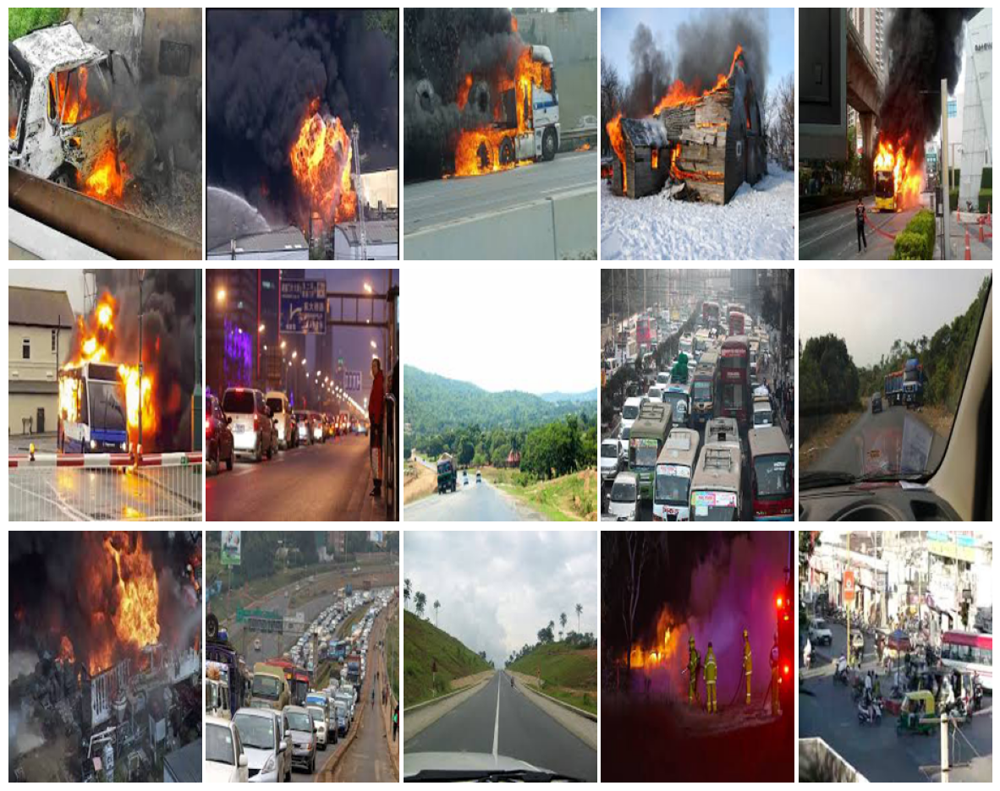

In [12]:
# Plotting 'n_img_to_plot' random images from the data-set.
np.random.seed(123)
n_img_to_plot = 15
random_idx = np.random.choice(range(len(X_color)), n_img_to_plot, replace=False)
plot_images(X_color[random_idx], image_height=img_height, image_width=img_width, 
            figsize=(15, 12), n_rows=3, gray_scale=False, hspace=0.01, wspace=0.02)

## **The basics of working with images in `Python`**

Once we have the paths of the images we are going to work with (in our case stored in `X`), we can start processing them in `Python`.

In this section we will cover the basic about working with images in Python, but in further section more advanced procedures will be presented, like filters, equalization and feature extraction methods.

### **Reading images**

We can use `PIL` library to read images in `Python`.

In [13]:
example_img = Image.open(X[2])

### **Size of an image**

In [14]:
example_img.size

(277, 182)

### **Resizing images**

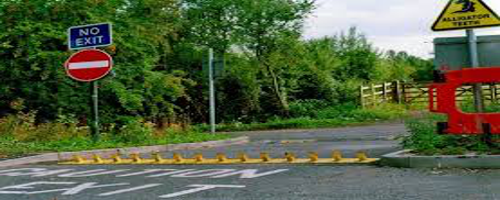

In [15]:
example_img.resize((500, 200))

### **Converting to gray scale**

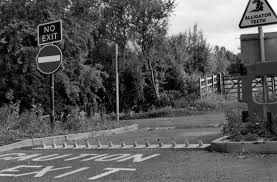

In [16]:
example_img.convert('L')

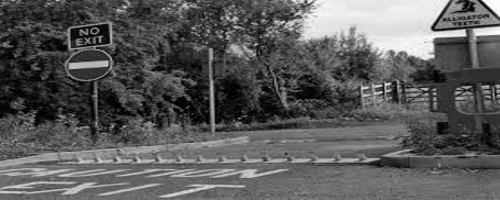

In [17]:
example_img.convert('L').resize((500, 200))

## **Filtering Images**

Filtering is a fundamental concept in image processing, particularly in computer vision and machine learning applications. By modifying images through filters, we can enhance certain features, suppress noise, or highlight specific characteristics that might not be immediately apparent in the raw image data.

From a machine learning perspective, incorporating filtering into the preprocessing pipeline can indeed significantly impact model performance. Different filters can extract different sets of features, which may be more informative for the task at hand. Therefore, deciding whether to apply filters and selecting the appropriate ones become crucial steps in the data preprocessing phase, and should be part of a ML pipeline.

Now we are going to show the results of applying some kind of filters on images.

To work with the different filtering method we have to transform images in pixels matrices, this can be considered as a filter extraction method, and will be covered in more detailed in upcoming sections.

### **Equalization**

Equalization is one such filtering technique. It aims to enhance the contrast of an image by redistributing the intensity values, typically stretching out the intensity range to cover the entire spectrum. This can make details more distinguishable, especially in images with poor contrast or lighting conditions.

We distinguish different procedures for equalizing images depending on whether they are gray-scale or color.

Histogram equalization is a technique used in image processing to improve the contrast of an image by redistributing the intensity values of the pixels. It's based on the concept of histogram, which is a graphical representation of the distribution of pixel intensities in an image.

Here's how histogram equalization works:

- **Compute Histogram:** The first step is to compute the histogram of the input grayscale image. The histogram shows the frequency of occurrence of each intensity value in the image.

- **Compute Cumulative Distribution Function (CDF):** Next, the cumulative distribution function (CDF) is calculated based on the histogram. The CDF represents the cumulative sum of normalized frequencies in the histogram. It essentially shows the cumulative probability of occurrence of each intensity value.

- **Normalize the CDF:** The CDF values are then normalized to map them to the range [0, 1]. This ensures that the intensity values of the output image will also be in the range [0, 1].

- **Map Intensity Values:** Each pixel in the input image is then mapped to a new intensity value based on the normalized CDF. This mapping redistributes the intensity values such that the CDF of the output image approaches a straight line, which corresponds to a uniform distribution of intensities.

- **Create Equalized Image:** Finally, the new intensity values obtained from the mapping are assigned to the corresponding pixels in the output image, creating the equalized image

#### **Equalization of gray-scale images**

In this section we are going to analyze how to equalize gray-scale images.

The following function summarize the process followed to equalize an image.

In [18]:
def get_equalization(img_array):

    img_vector = img_array.flatten()
    n_pixels = len(np.unique(img_vector))

    # Step 1: Compute Histogram
    counts, pixels = np.histogram(img_vector, bins=n_pixels, range=(0,n_pixels))
  
    # Step 2: Compute Cumulative Distribution Function (CDF)
    cdf = counts.cumsum()
 
    # Step 3: Normalize the CDF
    cdf_norm = cdf / float(cdf.max())
    pixels_cdf_norm = {int(pixels[i]): cdf_norm[i] for i in range(len(cdf_norm))}
    
    # Step 4: Map Intensity Values
    img_equalized_vector = []
    for x in img_vector:
        img_equalized_vector.append(pixels_cdf_norm[x])
    img_equalized_vector = np.array(img_equalized_vector)
    # Equivalent to: equalized_image = np.interp(img_vector, pixels[:-1], cdf_norm)
    
    # Step 5: Resize the equalized vector to convert it into a matrix
    img_equalized_array = img_equalized_vector.reshape(img_array.shape)

    return img_equalized_array, pixels_cdf_norm

We equalize `img_gray_pixels_matrix` using the above custom function.

In [19]:
example_img_gray = example_img.convert('L')
gray_img_pixels_matrix = np.array(example_img_gray)
equalized_gray_img_pixels_matrix, pixels_cdf_norm = get_equalization(img_array=gray_img_pixels_matrix)

In [20]:
equalized_gray_img_pixels_matrix

array([[0.23180069, 0.50567303, 0.74150038, ..., 0.99934542, 0.99966279,
        0.99966279],
       [0.13795771, 0.39052644, 0.26901258, ..., 0.99966279, 0.99966279,
        0.99966279],
       [0.56016186, 0.67030983, 0.86239933, ..., 0.99934542, 0.99966279,
        0.99986115],
       ...,
       [0.69143492, 0.63740231, 0.59642163, ..., 0.71226247, 0.70192804,
        0.68108065],
       [0.63740231, 0.68108065, 0.71226247, ..., 0.79644543, 0.74150038,
        0.71226247],
       [0.70192804, 0.69143492, 0.67030983, ..., 0.85176737, 0.8120165 ,
        0.78295712]])

In [21]:
gray_img_pixels_matrix

array([[ 48,  87, 112, ..., 251, 252, 252],
       [ 33,  71,  53, ..., 252, 252, 252],
       [ 94, 105, 140, ..., 251, 252, 253],
       ...,
       [107, 102,  98, ..., 109, 108, 106],
       [102, 106, 109, ..., 119, 112, 109],
       [108, 107, 105, ..., 135, 122, 117]], dtype=uint8)

In [22]:
equalized_gray_img_pixels_matrix.shape

(182, 277)

In [23]:
gray_img_pixels_matrix.shape

(182, 277)

`pixels_cdf_norm` tells us the corresponding equalized value for each pixel in `img_gray_pixels_matrix`.

In [24]:
pixels_cdf_norm[48]

0.2318006902844448

In [25]:
pixels_cdf_norm[87]

0.5056730273336771

In [26]:
pixels_cdf_norm

{0: 0.0005950727972388623,
 1: 0.004026659261316301,
 2: 0.0073193954060380055,
 3: 0.010116237553060658,
 4: 0.015352878168762645,
 5: 0.019815924148054113,
 6: 0.023862419169278375,
 7: 0.02723449835363193,
 8: 0.031062800015868607,
 9: 0.035644860554607846,
 10: 0.03915579005831713,
 11: 0.04351965723806879,
 12: 0.04756615225929305,
 13: 0.05077954536438291,
 14: 0.054845876145515136,
 15: 0.05859483476811997,
 16: 0.06262149402943627,
 17: 0.06660848177093665,
 18: 0.0707144840718848,
 19: 0.07454278573412147,
 20: 0.07823223707700241,
 21: 0.0829531479350974,
 22: 0.08715832903558535,
 23: 0.09104613797754592,
 24: 0.09584639187527275,
 25: 0.10060697425318364,
 26: 0.10556591423017415,
 27: 0.10981076685047804,
 28: 0.11405561947078192,
 29: 0.11897488792795652,
 30: 0.12329908358789225,
 31: 0.12857539572341017,
 32: 0.1329590986630698,
 33: 0.13795771015987623,
 34: 0.14299599317649858,
 35: 0.14819296227238465,
 36: 0.1532907525687309,
 37: 0.15866624350378863,
 38: 0.1643591

Now we are going to plot the pixels histogram and CDF for both the original image and the equalized, to get insights by comparing them. 

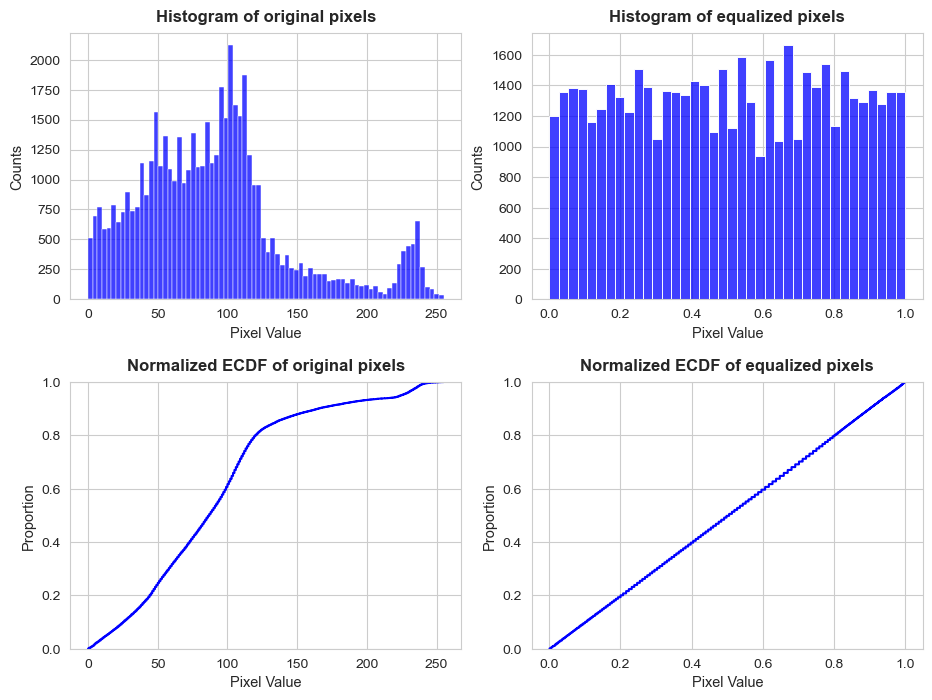

In [27]:
gray_img_pixels_vector = gray_img_pixels_matrix.flatten()
equalized_gray_img_pixels_vector = equalized_gray_img_pixels_matrix.flatten()

fig, axes = plt.subplots(2, 2, figsize=(11,8))
axes = axes.flatten() 

sns.histplot(x=gray_img_pixels_vector, stat='count', color='blue', ax=axes[0])
sns.ecdfplot(x=gray_img_pixels_vector, stat='proportion', color='blue', ax=axes[2])

sns.histplot(x=equalized_gray_img_pixels_vector, stat='count', color='blue', ax=axes[1])
sns.ecdfplot(x=equalized_gray_img_pixels_vector, stat='proportion', color='blue', ax=axes[3])

axes[0].set_title('Histogram of original pixels', size=12, weight='bold', y=1.01)
axes[2].set_title('Normalized ECDF of original pixels', size=12, weight='bold', y=1.01)
axes[1].set_title('Histogram of equalized pixels', size=12, weight='bold', y=1.01)
axes[3].set_title('Normalized ECDF of equalized pixels', size=12, weight='bold', y=1.01)

for i in range(len(axes)):
    axes[i].set_xlabel('Pixel Value', size=10.5)
    axes[i].tick_params(axis='x', labelsize=10)
    axes[i].tick_params(axis='y', labelsize=10)
    if i in [0,1]:
        axes[i].set_ylabel('Counts', size=10.5)
    elif i in [2,3]:
        axes[i].set_ylabel('Proportion', size=10.5)

plt.subplots_adjust(hspace=0.31, wspace=0.18) 
plt.show()

The effect of equalization in the both the histogram and CDF of pixels is pretty evident.

The next step will be to plot the original images together with the equalized one, to extract more insight about the effects of equalization.

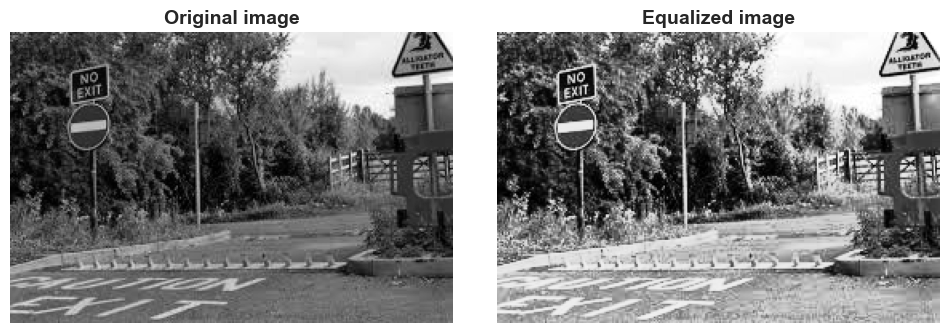

In [31]:
fig, axes = plt.subplots(1, 2, figsize=(12,8))
axes = axes.flatten() 

axes[0].imshow(gray_img_pixels_matrix, cmap='gray')
axes[1].imshow(equalized_gray_img_pixels_matrix, cmap='gray')

axes[0].set_title('Original image', size=14, weight='bold')
axes[1].set_title('Equalized image', size=14, weight='bold')

for i in range(len(axes)):
    axes[i].axis('off')  # Hide the axis

plt.subplots_adjust(hspace=0.2, wspace=0.1) 
plt.show()

Differences in terms of bright and contrast are pretty clear.

We can equalize an image just just in one line using the method `equalize_hist` of the `exposure` class contained in `skimage` package:

In [33]:
equalized_gray_img_pixels_vector = exposure.equalize_hist(gray_img_pixels_matrix)
equalized_gray_img_pixels_vector

array([[0.23180069, 0.50567303, 0.74150038, ..., 0.99934542, 0.99966279,
        0.99966279],
       [0.13795771, 0.39052644, 0.26901258, ..., 0.99966279, 0.99966279,
        0.99966279],
       [0.56016186, 0.67030983, 0.86239933, ..., 0.99934542, 0.99966279,
        0.99986115],
       ...,
       [0.69143492, 0.63740231, 0.59642163, ..., 0.71226247, 0.70192804,
        0.68108065],
       [0.63740231, 0.68108065, 0.71226247, ..., 0.79644543, 0.74150038,
        0.71226247],
       [0.70192804, 0.69143492, 0.67030983, ..., 0.85176737, 0.8120165 ,
        0.78295712]])

#### **Equalization of color-scale images directly**

In this section we are going to see how to equalize color images directly. Later another procedure based on HSV color space will be shown.

In [34]:
color_img_pixels_matrix = np.array(example_img)
directly_equalized_color_img_pixels_matrix, pixels_cdf_norm = get_equalization(img_array=color_img_pixels_matrix)

In [35]:
directly_equalized_color_img_pixels_matrix

array([[[0.16106637, 0.45940942, 0.05620132],
        [0.38729982, 0.72478544, 0.29028973],
        [0.51822906, 0.84575052, 0.41615424],
        ...,
        [0.99933881, 0.99847265, 1.        ],
        [0.99951072, 0.99886275, 1.        ],
        [0.99951072, 0.99847265, 1.        ]],

       [[0.05620132, 0.38247973, 0.05620132],
        [0.29554621, 0.59666627, 0.2098425 ],
        [0.2098425 , 0.47423996, 0.0987358 ],
        ...,
        [0.99918012, 0.99886275, 1.        ],
        [0.99918012, 0.99886275, 1.        ],
        [0.99933881, 0.99886275, 1.        ]],

       [[0.39686727, 0.79072612, 0.33831211],
        [0.45940942, 0.83064228, 0.39217281],
        [0.7333611 , 0.89567713, 0.58224567],
        ...,
        [0.99886275, 0.99886275, 0.99886275],
        [0.99918012, 0.99886275, 1.        ],
        [0.99933881, 0.99918012, 1.        ]],

       ...,

       [[0.57520398, 0.7333611 , 0.76511154],
        [0.54227   , 0.69056876, 0.72478544],
        [0.51822906, 0

In [36]:
color_img_pixels_matrix

array([[[ 17,  73,   0],
        [ 58, 111,  39],
        [ 84, 136,  64],
        ...,
        [253, 250, 255],
        [254, 251, 255],
        [254, 250, 255]],

       [[  0,  57,   0],
        [ 40,  96,  25],
        [ 25,  76,   7],
        ...,
        [252, 251, 255],
        [252, 251, 255],
        [253, 251, 255]],

       [[ 60, 120,  48],
        [ 73, 130,  59],
        [112, 163,  94],
        ...,
        [251, 251, 251],
        [252, 251, 255],
        [253, 252, 255]],

       ...,

       [[ 93, 112, 116],
        [ 88, 107, 111],
        [ 84, 103, 107],
        ...,
        [101, 112, 116],
        [100, 111, 115],
        [ 98, 109, 113]],

       [[ 88, 107, 111],
        [ 92, 111, 115],
        [ 95, 114, 118],
        ...,
        [111, 122, 126],
        [104, 115, 119],
        [101, 112, 116]],

       [[ 94, 113, 117],
        [ 93, 112, 116],
        [ 91, 110, 114],
        ...,
        [127, 138, 142],
        [114, 125, 129],
        [109, 120, 124]]

In [37]:
color_img_pixels_matrix.shape

(182, 277, 3)

In [38]:
directly_equalized_color_img_pixels_matrix.shape

(182, 277, 3)

As before, we plot both images to see the effect of equalization, but now in color images.

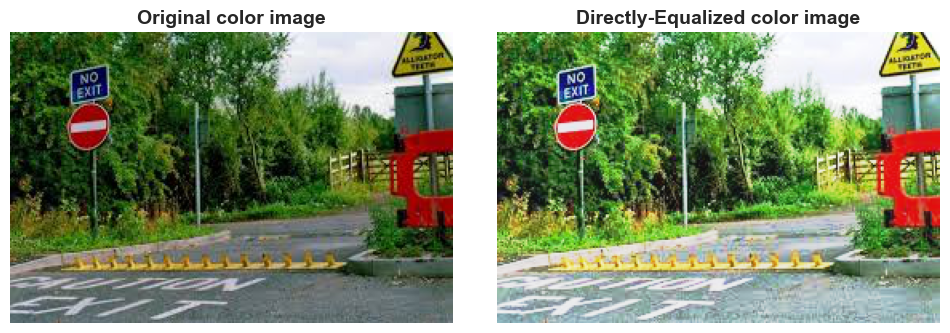

In [39]:
fig, axes = plt.subplots(1, 2, figsize=(12,7))
axes = axes.flatten() 

axes[0].imshow(color_img_pixels_matrix, cmap='gray')
axes[1].imshow(directly_equalized_color_img_pixels_matrix, cmap='gray')

axes[0].set_title('Original color image', size=14, weight='bold')
axes[1].set_title('Directly-Equalized color image', size=14, weight='bold')

for i in range(len(axes)):
    axes[i].axis('off')  # Hide the axis

plt.subplots_adjust(hspace=0.2, wspace=0.1) 
plt.show()

Again, the effect is crystal clear, specially in terms of bright and contrast.

As was mentioned before, same result can be achieved using `skimage`.

In [40]:
directly_equalized_color_img_pixels_matrix = exposure.equalize_hist(color_img_pixels_matrix)
directly_equalized_color_img_pixels_matrix

c:\Users\fscielzo\anaconda3\Lib\site-packages\skimage\_shared\utils.py:326: UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel, or set channel_axis.
  return func(*args, **kwargs)


array([[[0.16106637, 0.45940942, 0.05620132],
        [0.38729982, 0.72478544, 0.29028973],
        [0.51822906, 0.84575052, 0.41615424],
        ...,
        [0.99933881, 0.99847265, 1.        ],
        [0.99951072, 0.99886275, 1.        ],
        [0.99951072, 0.99847265, 1.        ]],

       [[0.05620132, 0.38247973, 0.05620132],
        [0.29554621, 0.59666627, 0.2098425 ],
        [0.2098425 , 0.47423996, 0.0987358 ],
        ...,
        [0.99918012, 0.99886275, 1.        ],
        [0.99918012, 0.99886275, 1.        ],
        [0.99933881, 0.99886275, 1.        ]],

       [[0.39686727, 0.79072612, 0.33831211],
        [0.45940942, 0.83064228, 0.39217281],
        [0.7333611 , 0.89567713, 0.58224567],
        ...,
        [0.99886275, 0.99886275, 0.99886275],
        [0.99918012, 0.99886275, 1.        ],
        [0.99933881, 0.99918012, 1.        ]],

       ...,

       [[0.57520398, 0.7333611 , 0.76511154],
        [0.54227   , 0.69056876, 0.72478544],
        [0.51822906, 0

#### **Equalization of color-scale images with HSV**

HSV stands for Hue, Saturation, and Value (or Brightness), and it's a color space commonly used in image processing and computer vision. It represents colors in a cylindrical coordinate system, making it particularly intuitive for tasks such as color selection, image segmentation, and color-based feature extraction.

Here's a brief explanation of each component of the HSV color space:

- **Hue (H)**: This represents the type of color, such as red, green, blue, etc. It's often measured in degrees ranging from 0 to 360, where 0 and 360 both correspond to red, 120 to green, and 240 to blue. The hue value essentially describes the dominant wavelength of light that gives the color its perceived hue.

- **Saturation (S)**: This component represents the intensity or purity of the color. It quantifies how much white light is mixed with the hue. A saturation value of 0 indicates a completely unsaturated (gray) color, while a value of 1 represents the most vivid version of that color.

- **Value (V)** (Brightness): This represents the brightness or intensity of the color. It indicates how much light is emitted by the color. A value of 0 represents black (no light), while a value of 1 represents the brightest possible version of the color.

By representing colors in terms of hue, saturation, and value, rather than the RGB (Red, Green, Blue) color space, HSV separates the information about color type, intensity, and brightness. This makes it easier to manipulate and interpret colors for various image processing tasks, such as adjusting color balance, detecting objects based on color, or segmenting regions of interest in an image based on their color characteristics.

The custom function `get_V_component` returns the HSV pixels array for a given RGB pixels arrays, as well as the V component of that array, that is, its third column. This component has an important role, since will allow as to equalize and filter color images in a suitable way.

In [41]:
V_component, img_array_HSV = get_V_component(color_img_pixels_matrix)

In [42]:
img_array_HSV

array([[[0.29452055, 1.        , 0.28627451],
        [0.28935185, 0.64864865, 0.43529412],
        [0.28703704, 0.52941176, 0.53333333],
        ...,
        [0.76666667, 0.01960784, 1.        ],
        [0.79166667, 0.01568627, 1.        ],
        [0.8       , 0.01960784, 1.        ]],

       [[0.33333333, 1.        , 0.22352941],
        [0.29812207, 0.73958333, 0.37647059],
        [0.28985507, 0.90789474, 0.29803922],
        ...,
        [0.70833333, 0.01568627, 1.        ],
        [0.70833333, 0.01568627, 1.        ],
        [0.75      , 0.01568627, 1.        ]],

       [[0.30555556, 0.6       , 0.47058824],
        [0.30046948, 0.54615385, 0.50980392],
        [0.28985507, 0.42331288, 0.63921569],
        ...,
        [0.        , 0.        , 0.98431373],
        [0.70833333, 0.01568627, 1.        ],
        [0.72222222, 0.01176471, 1.        ]],

       ...,

       [[0.52898551, 0.19827586, 0.45490196],
        [0.52898551, 0.20720721, 0.43529412],
        [0.52898551, 0

In [43]:
color_img_pixels_matrix # RBG array

array([[[ 17,  73,   0],
        [ 58, 111,  39],
        [ 84, 136,  64],
        ...,
        [253, 250, 255],
        [254, 251, 255],
        [254, 250, 255]],

       [[  0,  57,   0],
        [ 40,  96,  25],
        [ 25,  76,   7],
        ...,
        [252, 251, 255],
        [252, 251, 255],
        [253, 251, 255]],

       [[ 60, 120,  48],
        [ 73, 130,  59],
        [112, 163,  94],
        ...,
        [251, 251, 251],
        [252, 251, 255],
        [253, 252, 255]],

       ...,

       [[ 93, 112, 116],
        [ 88, 107, 111],
        [ 84, 103, 107],
        ...,
        [101, 112, 116],
        [100, 111, 115],
        [ 98, 109, 113]],

       [[ 88, 107, 111],
        [ 92, 111, 115],
        [ 95, 114, 118],
        ...,
        [111, 122, 126],
        [104, 115, 119],
        [101, 112, 116]],

       [[ 94, 113, 117],
        [ 93, 112, 116],
        [ 91, 110, 114],
        ...,
        [127, 138, 142],
        [114, 125, 129],
        [109, 120, 124]]

- H component:  a matrix with the first column of the 2D array `img_array_HSV[i]` as i-th row.

In [44]:
img_array_HSV[:,:,0]

array([[0.29452055, 0.28935185, 0.28703704, ..., 0.76666667, 0.79166667,
        0.8       ],
       [0.33333333, 0.29812207, 0.28985507, ..., 0.70833333, 0.70833333,
        0.75      ],
       [0.30555556, 0.30046948, 0.28985507, ..., 0.        , 0.70833333,
        0.72222222],
       ...,
       [0.52898551, 0.52898551, 0.52898551, ..., 0.54444444, 0.54444444,
        0.54444444],
       [0.52898551, 0.52898551, 0.52898551, ..., 0.54444444, 0.54444444,
        0.54444444],
       [0.52898551, 0.52898551, 0.52898551, ..., 0.54444444, 0.54444444,
        0.54444444]])

- S component:  a matrix with the second column of the 2D array `img_array_HSV[i]` as i-th row.

In [45]:
img_array_HSV[:,:,1]

array([[1.        , 0.64864865, 0.52941176, ..., 0.01960784, 0.01568627,
        0.01960784],
       [1.        , 0.73958333, 0.90789474, ..., 0.01568627, 0.01568627,
        0.01568627],
       [0.6       , 0.54615385, 0.42331288, ..., 0.        , 0.01568627,
        0.01176471],
       ...,
       [0.19827586, 0.20720721, 0.21495327, ..., 0.12931034, 0.13043478,
        0.13274336],
       [0.20720721, 0.2       , 0.19491525, ..., 0.11904762, 0.12605042,
        0.12931034],
       [0.1965812 , 0.19827586, 0.20175439, ..., 0.1056338 , 0.11627907,
        0.12096774]])

- V component: a matrix with the third column of the 2D array `img_array_HSV[i]` as i-th row.

In [46]:
img_array_HSV[:,:,2]

array([[0.28627451, 0.43529412, 0.53333333, ..., 1.        , 1.        ,
        1.        ],
       [0.22352941, 0.37647059, 0.29803922, ..., 1.        , 1.        ,
        1.        ],
       [0.47058824, 0.50980392, 0.63921569, ..., 0.98431373, 1.        ,
        1.        ],
       ...,
       [0.45490196, 0.43529412, 0.41960784, ..., 0.45490196, 0.45098039,
        0.44313725],
       [0.43529412, 0.45098039, 0.4627451 , ..., 0.49411765, 0.46666667,
        0.45490196],
       [0.45882353, 0.45490196, 0.44705882, ..., 0.55686275, 0.50588235,
        0.48627451]])

In [47]:
V_component

array([[0.28627451, 0.43529412, 0.53333333, ..., 1.        , 1.        ,
        1.        ],
       [0.22352941, 0.37647059, 0.29803922, ..., 1.        , 1.        ,
        1.        ],
       [0.47058824, 0.50980392, 0.63921569, ..., 0.98431373, 1.        ,
        1.        ],
       ...,
       [0.45490196, 0.43529412, 0.41960784, ..., 0.45490196, 0.45098039,
        0.44313725],
       [0.43529412, 0.45098039, 0.4627451 , ..., 0.49411765, 0.46666667,
        0.45490196],
       [0.45882353, 0.45490196, 0.44705882, ..., 0.55686275, 0.50588235,
        0.48627451]])

In [48]:
V_component.shape

(182, 277)

The custom function `equalize_color_image_HSV` perform the operation of equalizing a color image based on HSV color space.

The basic pipeline is the following:

Color image $\hspace{0.1cm}\Rightarrow\hspace{0.1cm}$ RGB pixels array $\hspace{0.1cm}\Rightarrow\hspace{0.1cm}$ HSV pixels array $\hspace{0.1cm}\Rightarrow\hspace{0.1cm}$ Equalize V component (is a gray image) $\hspace{0.1cm}\Rightarrow\hspace{0.1cm}$ Update HSV pixels array with the equalized V component $\hspace{0.1cm}\Rightarrow\hspace{0.1cm}$ Convert HSV to RGB $\hspace{0.1cm}\Rightarrow\hspace{0.1cm}$ Equalized RGB pixels matrix.

Above pipeline is visualized in the following plot.

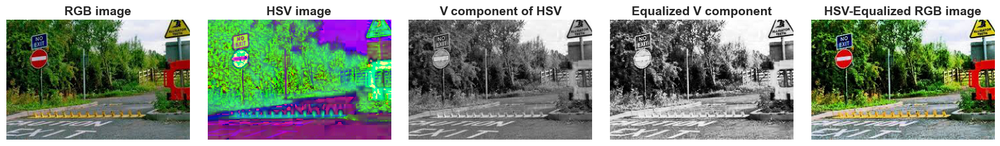

In [49]:

V_component_equalized = exposure.equalize_hist(V_component)
HSV_equalized_color_img_pixels_matrix = equalize_color_image_HSV(color_img_pixels_matrix)

fig, axes = plt.subplots(1, 5, figsize=(20,6))
axes = axes.flatten() 

axes[0].imshow(color_img_pixels_matrix, cmap='gray')
axes[1].imshow(img_array_HSV, cmap='gray')
axes[2].imshow(V_component, cmap='gray')
axes[3].imshow(V_component_equalized, cmap='gray')
axes[4].imshow(HSV_equalized_color_img_pixels_matrix, cmap='gray')

axes[0].set_title('RGB image', size=14, weight='bold')
axes[1].set_title('HSV image', size=14, weight='bold')
axes[2].set_title('V component of HSV', size=14, weight='bold')
axes[3].set_title('Equalized V component', size=14, weight='bold')
axes[4].set_title('HSV-Equalized RGB image', size=14, weight='bold')

for i in range(len(axes)):
    axes[i].axis('off')  # Hide the axis

plt.subplots_adjust(hspace=0.2, wspace=0.1) 
plt.show()

#### **Comparison of equalization approaches**

The following plot is meaningful in order to visualize differences between equalizing a color image directly and with HSV method.

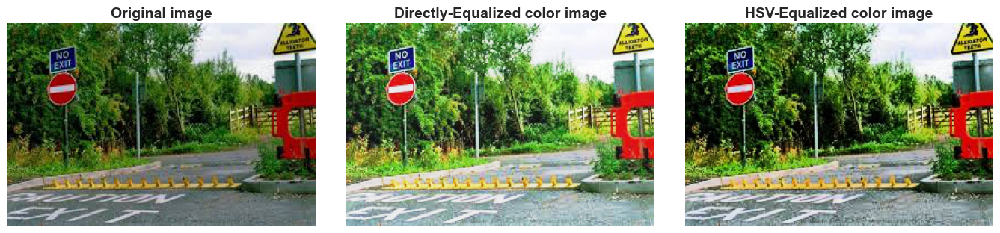

In [50]:
fig, axes = plt.subplots(1, 3, figsize=(17,7))
axes = axes.flatten() 

axes[0].imshow(color_img_pixels_matrix, cmap='gray')
axes[1].imshow(directly_equalized_color_img_pixels_matrix, cmap='gray')
axes[2].imshow(HSV_equalized_color_img_pixels_matrix, cmap='gray')

axes[0].set_title('Original image', size=14, weight='bold')
axes[1].set_title('Directly-Equalized color image', size=14, weight='bold')
axes[2].set_title('HSV-Equalized color image', size=14, weight='bold')

for i in range(len(axes)):
    axes[i].axis('off')  # Hide the axis
    
plt.subplots_adjust(hspace=0.2, wspace=0.1)     
plt.show()

### **Other Filters**

In this section other filters beyond equalization will be presented, but not as deeply.

The filters that will be presented in a practical manner are the following:

- Sobel
- Canny
- Convolve1
- Gaussian
- Hessian
- Noisy
- Butterworth
- Correlate1
- Prewitt
- Bilateral
- Erosion
- Dilation


By practical manner we referred that we are not going to explain the theory behind these filters, let say, how these filters actually work, but only the visual effect of applying them will be shown.

These filter can be applied both in color and gray images.

#### **Filtering gray-scale images**

In [51]:
gray_img_pixels_matrix = np.array(example_img.convert('L'))

mask_1 = np.ones((3, 3)) * 1/9 
mask_2 = np.array([[-1, -2, -1], [0, 0, 0], [1, 2, 1]])
mask_3 = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]])

filtered_img_pixels_matrix = {}
filtered_img_pixels_matrix['sobel'] = apply_filter(img_array=gray_img_pixels_matrix, filter='sobel', gray_img=True)
filtered_img_pixels_matrix['canny'] = apply_filter(img_array=gray_img_pixels_matrix, filter='canny', gray_img=True)
filtered_img_pixels_matrix['convolve1'] = apply_filter(img_array=gray_img_pixels_matrix, filter='convolve', weights=mask_1, gray_img=True)
filtered_img_pixels_matrix['convolve2'] = apply_filter(img_array=gray_img_pixels_matrix, filter='convolve', weights=mask_2, gray_img=True)
filtered_img_pixels_matrix['convolve3'] = apply_filter(img_array=gray_img_pixels_matrix, filter='convolve', weights=mask_3, gray_img=True)
filtered_img_pixels_matrix['gaussian'] = apply_filter(img_array=gray_img_pixels_matrix, filter='gaussian', sigma=2, gray_img=True)
filtered_img_pixels_matrix['hessian'] = apply_filter(img_array=gray_img_pixels_matrix, filter='hessian', gray_img=True)
filtered_img_pixels_matrix['noisy'] = apply_filter(img_array=gray_img_pixels_matrix, filter='noisy', gray_img=True)
filtered_img_pixels_matrix['butterworth'] = apply_filter(img_array=gray_img_pixels_matrix, filter='butterworth', sigma=2, gray_img=True)
filtered_img_pixels_matrix['correlate1'] = apply_filter(img_array=gray_img_pixels_matrix, filter='correlate', weights=mask_1, gray_img=True)
filtered_img_pixels_matrix['correlate2'] = apply_filter(img_array=gray_img_pixels_matrix, filter='correlate', weights=mask_2, gray_img=True)
filtered_img_pixels_matrix['correlate3'] = apply_filter(img_array=gray_img_pixels_matrix, filter='correlate', weights=mask_3, gray_img=True)
filtered_img_pixels_matrix['prewitt'] = apply_filter(img_array=gray_img_pixels_matrix, filter='prewitt', gray_img=True)
filtered_img_pixels_matrix['bilateral'] = apply_filter(img_array=gray_img_pixels_matrix, filter='bilateral', gray_img=True)
filtered_img_pixels_matrix['erosion'] = apply_filter(img_array=gray_img_pixels_matrix, filter='erosion', gray_img=True)
filtered_img_pixels_matrix['dilation'] = apply_filter(img_array=gray_img_pixels_matrix, filter='dilation', gray_img=True)
filtered_img_pixels_matrix['equalized'] = apply_filter(img_array=gray_img_pixels_matrix, filter='equalized', gray_img=True)

C:\Users\fscielzo\Documents\Packages\PyImageML_Package_Private\PyImageML\preprocessing.py:130: UserWarning: Possible precision loss converting image of type float64 to uint8 as required by rank filters. Convert manually using skimage.util.img_as_ubyte to silence this warning.
  img_array = filter_gray_image(img_array=img_array, filter=filter, weights=weights, sigma=sigma)


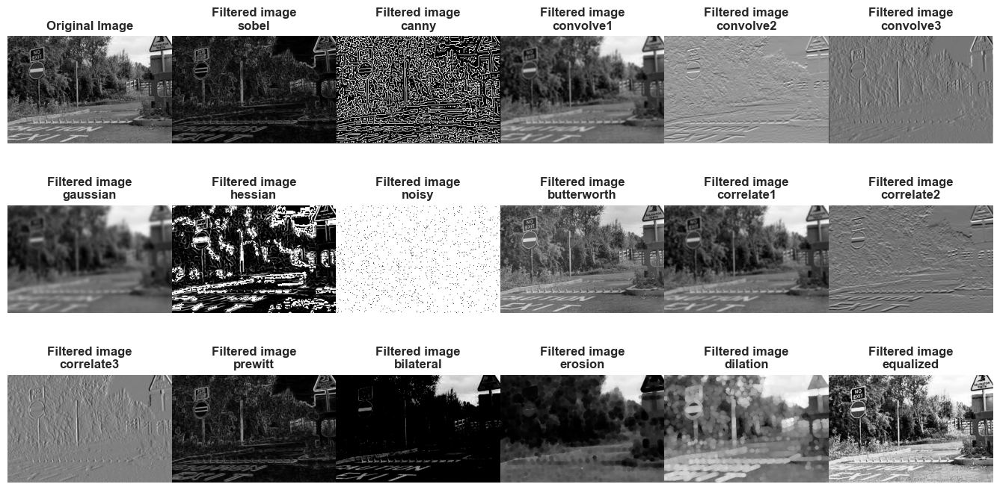

In [52]:
images_to_plot = {'Original Image': gray_img_pixels_matrix}
images_to_plot.update({f'Filtered image\n{filter}': filtered_img_pixels_matrix[filter] for filter in filtered_img_pixels_matrix.keys()})
n_subplots = len(images_to_plot.items())
n_rows = 3
n_cols = 6
fig, axes = plt.subplots(n_rows, n_cols, figsize=(17,8))
axes = axes.flatten() 

for i, (title, img) in enumerate(images_to_plot.items()):

    axes[i].imshow(img, cmap='gray')
    axes[i].set_title(title, size=12, weight='bold')
    axes[i].axis('off')  # Hide the axis   

plt.subplots_adjust(hspace=0.4, wspace=0) 
for j in range(n_subplots, n_rows * n_cols):
    fig.delaxes(axes[j])
plt.show()

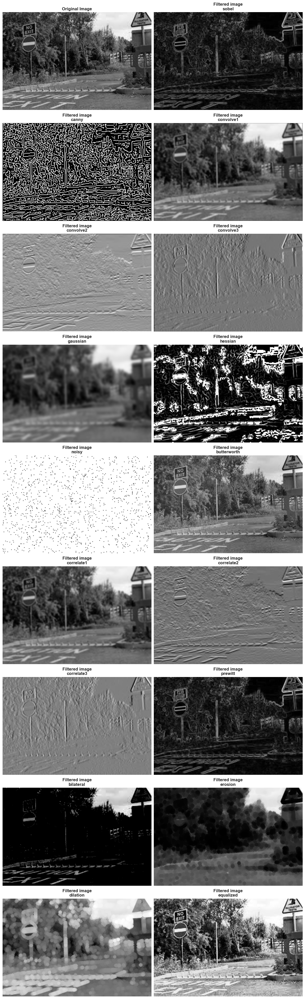

In [53]:
n_subplots = len(images_to_plot.items())
n_rows = n_subplots
n_cols = 2
fig, axes = plt.subplots(n_rows, n_cols, figsize=(15,100))
axes = axes.flatten() 

for i, (title, img) in enumerate(images_to_plot.items()):

    axes[i].imshow(img, cmap='gray')
    axes[i].set_title(title, size=12, weight='bold')
    axes[i].axis('off')  # Hide the axis   

plt.subplots_adjust(hspace=0.075, wspace=0.015) 
for j in range(n_subplots, n_rows * n_cols):
    fig.delaxes(axes[j])
plt.show()

#### **Filtering color images**

In [54]:
color_img_pixels_matrix = np.array(example_img)

mask_1 = np.ones((3, 3)) * 1/9 
mask_2 = np.array([[-1, -2, -1], [0, 0, 0], [1, 2, 1]])
mask_3 = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]])

filtered_img_pixels_matrix = {}
filtered_img_pixels_matrix['sobel'] = apply_filter(img_array=color_img_pixels_matrix, filter='sobel', gray_img=False)
filtered_img_pixels_matrix['canny'] = apply_filter(img_array=color_img_pixels_matrix, filter='canny', gray_img=False)
filtered_img_pixels_matrix['convolve1'] = apply_filter(img_array=color_img_pixels_matrix, filter='convolve', weights=mask_1, gray_img=False)
filtered_img_pixels_matrix['convolve2'] = apply_filter(img_array=color_img_pixels_matrix, filter='convolve', weights=mask_2, gray_img=False)
filtered_img_pixels_matrix['convolve3'] = apply_filter(img_array=color_img_pixels_matrix, filter='convolve', weights=mask_3, gray_img=False)
filtered_img_pixels_matrix['gaussian'] = apply_filter(img_array=color_img_pixels_matrix, filter='gaussian', sigma=2, gray_img=False)
filtered_img_pixels_matrix['hessian'] = apply_filter(img_array=color_img_pixels_matrix, filter='hessian', gray_img=False)
filtered_img_pixels_matrix['noisy'] = apply_filter(img_array=color_img_pixels_matrix, filter='noisy', gray_img=False)
filtered_img_pixels_matrix['butterworth'] = apply_filter(img_array=color_img_pixels_matrix, filter='butterworth', sigma=2, gray_img=False)
filtered_img_pixels_matrix['correlate1'] = apply_filter(img_array=color_img_pixels_matrix, filter='correlate', weights=mask_1, gray_img=False)
filtered_img_pixels_matrix['correlate2'] = apply_filter(img_array=color_img_pixels_matrix, filter='correlate', weights=mask_2, gray_img=False)
filtered_img_pixels_matrix['correlate3'] = apply_filter(img_array=color_img_pixels_matrix, filter='correlate', weights=mask_3, gray_img=False)
filtered_img_pixels_matrix['prewitt'] = apply_filter(img_array=color_img_pixels_matrix, filter='prewitt', gray_img=False)
filtered_img_pixels_matrix['bilateral'] = apply_filter(img_array=color_img_pixels_matrix, filter='bilateral', gray_img=False)
filtered_img_pixels_matrix['erosion'] = apply_filter(img_array=color_img_pixels_matrix, filter='erosion', gray_img=False)
filtered_img_pixels_matrix['dilation'] = apply_filter(img_array=color_img_pixels_matrix, filter='dilation', gray_img=False)
filtered_img_pixels_matrix['equalized'] = apply_filter(img_array=color_img_pixels_matrix, filter='equalized', gray_img=False)

C:\Users\fscielzo\Documents\Packages\PyImageML_Package_Private\PyImageML\preprocessing.py:137: UserWarning: Possible precision loss converting image of type float64 to uint8 as required by rank filters. Convert manually using skimage.util.img_as_ubyte to silence this warning.
  img_array = filter_color_image(img_array=img_array, filter=filter, weights=weights, sigma=sigma)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


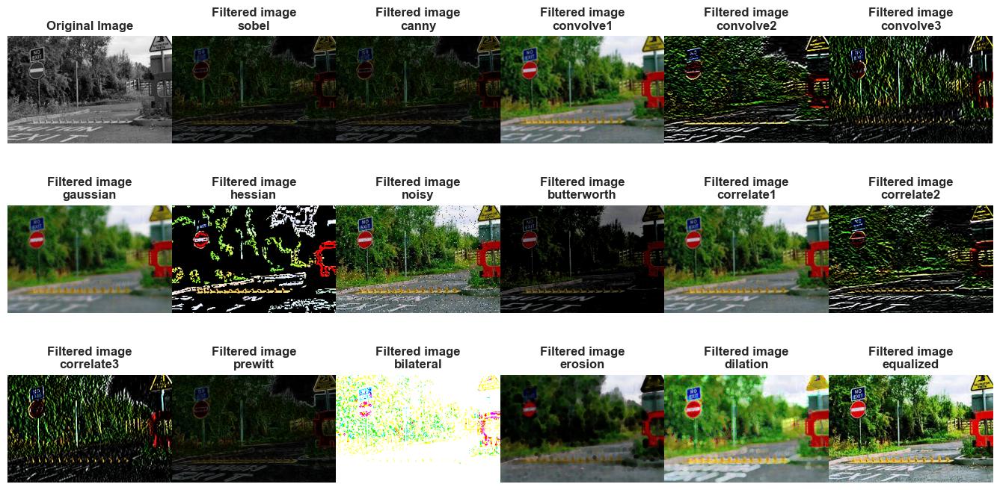

In [55]:
images_to_plot = {'Original Image': gray_img_pixels_matrix}
images_to_plot.update({f'Filtered image\n{filter}': filtered_img_pixels_matrix[filter] for filter in filtered_img_pixels_matrix.keys()})
n_subplots = len(images_to_plot.items())
n_rows = 3
n_cols = 6
fig, axes = plt.subplots(n_rows, n_cols, figsize=(17,8))
axes = axes.flatten() 

for i, (title, img) in enumerate(images_to_plot.items()):

    axes[i].imshow(img, cmap='gray')
    axes[i].set_title(title, size=12, weight='bold')
    axes[i].axis('off')  # Hide the axis   

plt.subplots_adjust(hspace=0.4, wspace=0) 
for j in range(n_subplots, n_rows * n_cols):
    fig.delaxes(axes[j])
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


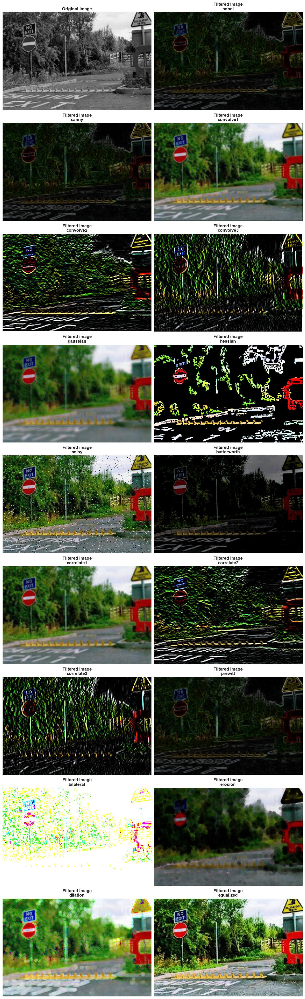

In [56]:
n_subplots = len(images_to_plot.items())
n_rows = n_subplots
n_cols = 2
fig, axes = plt.subplots(n_rows, n_cols, figsize=(15,100))
axes = axes.flatten() 

for i, (title, img) in enumerate(images_to_plot.items()):

    axes[i].imshow(img, cmap='gray')
    axes[i].set_title(title, size=12, weight='bold')
    axes[i].axis('off')  # Hide the axis   

plt.subplots_adjust(hspace=0.075, wspace=0.015) 
for j in range(n_subplots, n_rows * n_cols):
    fig.delaxes(axes[j])
plt.show()

## **Feature Extraction Methods for Images**

The basic idea of feature extraction methods applied to images is to convert raw image data into a numerical representation, typically an array or a set of numerical descriptors. This numerical representation captures important characteristics or features of the image, making it amenable to analysis by machine learning algorithms and statistical techniques.

Feature extraction serves as a bridge between the raw visual content of an image and the mathematical models used in computer vision tasks. By extracting relevant features from images, we can abstract away unnecessary details while retaining essential information that is crucial for the task at hand.

There exist numerous feature extraction methods tailored to different types of image data and tasks. Among them, some standard techniques are commonly employed in image processing pipelines. These methods often include:

- **Pixel Intensity:** A straightforward approach involves using the pixel intensity values directly as features. In grayscale images, each pixel's intensity represents a feature, while in color images, features may include intensity values from different color channels (e.g., Red, Green, Blue).
Histogram-based Features: Histograms provide a compact representation of the distribution of pixel intensities in an image. Histogram-based features capture statistical information about the image's brightness, contrast, and color distribution. Common histogram features include mean, variance, skewness, and kurtosis.

- **Texture Features:** Texture refers to the spatial arrangement of pixels in an image and their variations in intensity or color. Texture features describe patterns, structures, and regularities present in different regions of the image. Techniques such as co-occurrence matrices, local binary patterns (LBP), and Gabor filters are commonly used for texture feature extraction.

- **Edge and Contour Features:** Edges represent abrupt changes in pixel intensity and often correspond to object boundaries or significant image structures. Edge detection algorithms extract features based on the presence, orientation, and strength of edges in the image. Contour-based features describe the shape, curvature, and spatial arrangement of object boundaries.

- **Transform-based Features:** Transform-based methods, such as Fourier transform, wavelet transform, and principal component analysis (PCA), extract features by analyzing the frequency, spatial, or spectral characteristics of the image. These methods help capture global and local image patterns efficiently.



### **Pixel Method**

Given and image $\mathcal{I}$ of height $h$ and wight $w$, we have a different pixels representation of the image depending on whether it is color-scale or gray-scale.

In the Pixels method for extracting features on images the following points are crucial:



- $\mathcal{I}$ is defined by its pixels.



- $\mathcal{I}$ has $h\cdot w$ pixels.




- $\mathcal{I}$ can be represented as an 2D array (matrix) of pixels, where each element/position is a pixel.

    $$M(\mathcal{I}) = \begin{pmatrix} p_{1,1} & p_{1,2} &\dots & p_{1,w}  \\
                                   p_{2,1} & p_{2,2} & \dots & p_{2,w} \\
                                   \dots  & \dots & \dots \\
                                   p_{h,1} & p_{h,2} & \dots & p_{h,w}
                   \end{pmatrix} = \left( p_{ij}\right)_{\substack{i=1,..,h \\ j=1,..,w}}$$
    
    Where $p_{ij}$ is the pixel of $\mathcal{I}$ that occupies position $(i,j)$ in the image, namely, the pixel $(i,j)$.



- If $\mathcal{I}$ is **gray**-scale:

   $$p_{ij} \in [0,255] \subset \mathbb{Z}\\[0.5cm]$$

   - The closer $p_{ij}$ to $0$, the **lower** the **gray** intensity of the pixel.
   
   - The closer $p_{ij}$ to $255$, the **greater** the **gray** intensity of the pixel.



- If $\mathcal{I}$ is **color**-scale:

   $$p_{ij} = (R_{ij}, G_{ij}, B_{ij})$$

    - $R_{ij}, G_{ij}, B_{ij} \in [0,255] \subset \mathbb{Z}$ are the red, green and blue channels, respectively, that is, the red, green and blue part of the pixel $p_{ij}$.

   - The closer $R_{ij}, G_{ij}, B_{ij}$ to $0$, the **lower** the **red**, **green**, **blue** intensity of the pixel, respectively.
   - The closer $R_{ij}, G_{ij}, B_{ij}$ to $255$, the **greater** the **red**,**green**, **blue** intensity of the pixel, respectively.

#### **Extracting pixel features from gray-scale image**

When $\mathcal{I}$ is gray-scale, there are no differences with the previous approach. 

`Python` gives us $M(\mathcal{I})$ directly as a 2D `numpy` array.


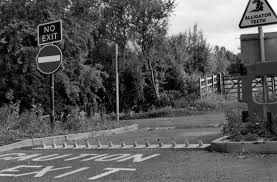

In [57]:
example_img_gray = example_img.convert('L')
example_img_gray

- **Building the pixels matrix for a gray-scale image: $M(\mathcal{I})$**

   $M(\mathcal{I}) = $ `np.array(example_img_gray)`

In [58]:
img_gray_array = np.array(example_img_gray)
img_gray_array

array([[ 48,  87, 112, ..., 251, 252, 252],
       [ 33,  71,  53, ..., 252, 252, 252],
       [ 94, 105, 140, ..., 251, 252, 253],
       ...,
       [107, 102,  98, ..., 109, 108, 106],
       [102, 106, 109, ..., 119, 112, 109],
       [108, 107, 105, ..., 135, 122, 117]], dtype=uint8)

$p_{12} =$ `img_gray_array[0,1]`

In [59]:
img_gray_array[0,1]

87

$p_{40, 12} =$ `img_gray_array[39,11]`

In [60]:
img_gray_array[39,11]

62

**Plotting the array as an image**

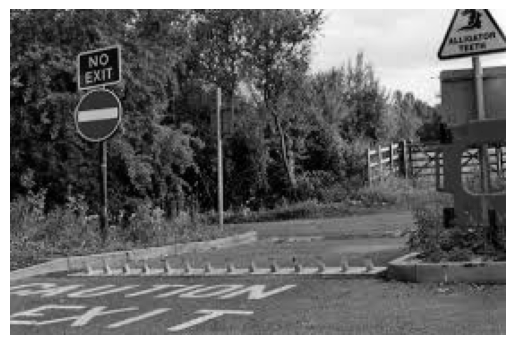

In [61]:
plt.imshow(img_gray_array, cmap='gray')
plt.axis('off')  # Hide the axis
plt.show()

#### **Extracting pixel features from color image**

When $\mathcal{I}$ is color-scale, there are slightly differences with the previous approach. 

`Python` doesnt give us $M(\mathcal{I})$ directly, but we can access to their elements by mean of a 3D array. 

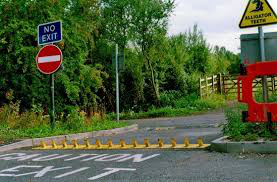

In [62]:
example_img

That 3D array is obtained with `np.array(example_img)`

In [63]:
img_color_array = np.array(example_img)
img_color_array

array([[[ 17,  73,   0],
        [ 58, 111,  39],
        [ 84, 136,  64],
        ...,
        [253, 250, 255],
        [254, 251, 255],
        [254, 250, 255]],

       [[  0,  57,   0],
        [ 40,  96,  25],
        [ 25,  76,   7],
        ...,
        [252, 251, 255],
        [252, 251, 255],
        [253, 251, 255]],

       [[ 60, 120,  48],
        [ 73, 130,  59],
        [112, 163,  94],
        ...,
        [251, 251, 251],
        [252, 251, 255],
        [253, 252, 255]],

       ...,

       [[ 93, 112, 116],
        [ 88, 107, 111],
        [ 84, 103, 107],
        ...,
        [101, 112, 116],
        [100, 111, 115],
        [ 98, 109, 113]],

       [[ 88, 107, 111],
        [ 92, 111, 115],
        [ 95, 114, 118],
        ...,
        [111, 122, 126],
        [104, 115, 119],
        [101, 112, 116]],

       [[ 94, 113, 117],
        [ 93, 112, 116],
        [ 91, 110, 114],
        ...,
        [127, 138, 142],
        [114, 125, 129],
        [109, 120, 124]]

The 3D `img_color_array` has a size of $(h, w, 3)$, where $h$ and $w$ are respectively the height and width of the image.

In [64]:
img_color_array.shape

(182, 277, 3)

`img_color_array` is made up by $h$ 2D arrays of size $w\times 3$.

The $i$-th 2D array of `img_color_array`, namely `img_color_array[i,:]`, contains in its rows the 1D array that represents pixel $(i,j)$, for $j=1,\dots,w$.

In other words, let $A(\mathcal{I})$ be the 3D array `img_color_array`, it contains $h$ 2D arrays $A(\mathcal{I})[i,:]$, that contains the pixels $(p_{ij} : j=1,\dots,w)$.

$$A(\mathcal{I})[i,:] = \begin{pmatrix} p_{i1}  \\
                                          p_{i2}  \\
                                          \dots \\
                                          p_{iw}
                         \end{pmatrix} = 
                         \begin{pmatrix} R_{i1} & G_{i1} & B_{i1}  \\
                                          R_{i2}& G_{i2}& B_{i2}   \\
                                          \dots &  \dots & \dots \\
                                          R_{iw}& G_{iw}& B_{iw}
                         \end{pmatrix} $$

Therefore:

$$A(\mathcal{I})[i,:][j,:] = p_{ij} = (R_{ij}, G_{ij}, B_{ij})$$


The flattened representation of $A(\mathcal{I})[i,:]$ is:

$$\mathcal{F}(A(\mathcal{I})[i,:]) =  (p_{i1},  \dots ,  p_{iw})  = (R_{i1} , G_{i1} , B_{i1},   \dots, R_{iw}, G_{iw}, B_{iw})$$

So, we can construct the $M(\mathcal{I})$ matrix as:

$$
M(\mathcal{I}) =  \Bigl(\mathcal{F}(A(\mathcal{I})[i,:])\Bigr)_{\substack{i=1,..,h}} =
=                   
\begin{pmatrix} p_{11} & \dots & p_{1w}  \\
                p_{21} & \dots& p_{2w}  \\
                \dots &\dots &  \dots\\
                 p_{h1} &  \dots& p_{hw}
\end{pmatrix} 
=                    
\begin{pmatrix} R_{11} & G_{11} & B_{11}&   \dots & R_{1w}& G_{1w}& B_{1w}  \\
                R_{21} & G_{21} & B_{21}&   \dots& R_{2w}& G_{2w}& B_{2w}   \\
                \dots &\dots &  \dots& \dots & \dots & \dots& \dots\\
                 R_{h1} & G_{h1} & B_{h1}&   \dots& R_{hw}& G_{hw}& B_{hw}
\end{pmatrix}
$$

For instance: $\hspace{0.1cm} p_{13}=$`example_img_color_array[0,:][2,:]` = `example_img_color_array[0,2]`

In [65]:
img_color_array[0,:][2,:]

array([ 84, 136,  64], dtype=uint8)

In [66]:
img_color_array[0,2]

array([ 84, 136,  64], dtype=uint8)

- **Building the pixels matrix for a color image: $M(\mathcal{I})$**

   We use the flatten procedure described above.

In [67]:
h = img_color_array.shape[0]
w = img_color_array.shape[1]
new_w = w*img_color_array.shape[2]
img_color_2D_array = np.zeros((h,new_w))
for i in range(0,h):
    img_color_2D_array[i,:] = img_color_array[i,:].flatten()

In [68]:
img_color_2D_array

array([[ 17.,  73.,   0., ..., 254., 250., 255.],
       [  0.,  57.,   0., ..., 253., 251., 255.],
       [ 60., 120.,  48., ..., 253., 252., 255.],
       ...,
       [ 93., 112., 116., ...,  98., 109., 113.],
       [ 88., 107., 111., ..., 101., 112., 116.],
       [ 94., 113., 117., ..., 109., 120., 124.]])

In [69]:
img_color_2D_array.shape

(182, 831)

We can plot the 2D array `img_color_2D_array` to realize how this representation of the original color image is not precise at all, since modify its size and remove the color pattern. 

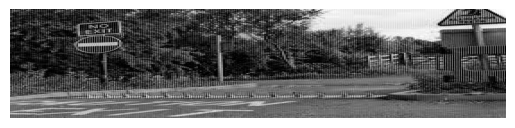

In [70]:
plt.imshow(img_color_2D_array, cmap='gray')
plt.axis('off')  # Hide the axis
plt.show()

If we want to plot the original color image we need the 3D array `img_color_array` that contains all its information, specifically regarding the color and the size.

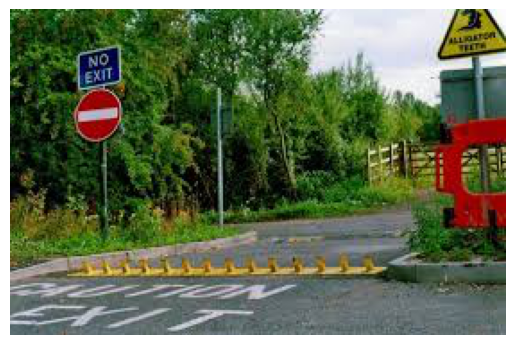

In [71]:
plt.imshow(img_color_array, cmap='gray')
plt.axis('off')  # Hide the axis
plt.show()

### **Pixel features array**

Once we know how to extract features of images the next step is to build a features array with those extracted features to be use along with Machine Learning models.

In this section this topic will be addressed following the different feature extraction method explained before. 

Most part of Machine Learning algorithms need a matrix (2D array) as input, usually called features/predictors matrix, but other are able to work with tensor, that is, 3D arrays, usually refer as sequential data. This last is specially common in the Deep Learning field.

Here we will cover both approaches, so that we are going to learn how to build both predictors matrices and tensors.

#### **Sequential data: features tensor**

Given $n$ images $\mathcal{I}_1,\dots , \mathcal{I}_n$ of the same size $h\times w$.

Using the pixels method for features extraction, a features **tensor** for those images can be build as follows:  

$$X =   \begin{pmatrix} M(\mathcal{I}_1)  \\
                        M(\mathcal{I}_2)    \\
                        \dots  \\
                        M(\mathcal{I}_n) 
                        \end{pmatrix} $$

Where $M(\mathcal{I}_i)$ is the pixels matrix of the image $\mathcal{I}_i$.

This tensor is a 3D array of size $n\times h\times w$  that contains the pixels matrix of each image, so, is an array with $n$ matrices.

#### **Tabular data: features matrix**

Given $n$ images $\mathcal{I}_1,\dots , \mathcal{I}_n$ of the same size $h\times w$.

Using the pixels method for features extraction, a **features matrix** for those images can be build as follows: 

$$X =   \begin{pmatrix} v(\mathcal{I}_1)  \\
                        v(\mathcal{I}_2)    \\
                        \dots  \\
                        v(\mathcal{I}_n) 
                        \end{pmatrix} $$

Where $v(\mathcal{I}_i)$ is the **vectorial pixels representation** (1D array) of the image $\mathcal{I}_i$ and $p$ is the length of $v(\mathcal{I}_i)$.

This matrix is a 2D array of size $n\times p$  that contains the flattened pixels matrix (`img_pixels_array.flatten()`)  of each image, let say, the pixels vector of each image.

##### **Vectorial representation of an image**

$v(\mathcal{I}_i)$ is the 1D array resulting of flatten $M(\mathcal{I}_i)$ $\Rightarrow$ `img_pixels_array.flatten()`



- If $\mathcal{I}_i$ is gray-scale:

   $$v(\mathcal{I}_i) = (p_{11}, \dots, p_{1w}, p_{21},\dots,p_{2w}, \dots,p_{h1},\dots,p_{hw})^{\prime}$$

   with a size of $h\cdot w$.


- If $\mathcal{I}_i$ is color:

   $$v(\mathcal{I}_i) = (R_{11}, G_{11}, B_{11},\dots,R_{1w},G_{1w},B_{1w},\dots,R_{h1},G_{h1},B_{h1},\dots,R_{hw},G_{hw},B_{hw})^{\prime}$$

   and its size is $3\cdot h \cdot w$.

We can obtain the vectorial representation of both the gray and color-scale images using using the function `flatten()` on `img_gray_array` and `img_color_array`, respectively.

In [72]:
img_gray_pixels_vector = img_gray_array.flatten()
img_gray_pixels_vector

array([ 48,  87, 112, ..., 135, 122, 117], dtype=uint8)

In [73]:
img_color_pixels_vector = img_color_array.flatten()
img_color_pixels_vector

array([ 17,  73,   0, ..., 109, 120, 124], dtype=uint8)

>Extracting the vector `img_pixels_vector` for each image on the data-set and concatenating them by rows we obtain a **pixels features matrix**.

Once we have  $$X =   \begin{pmatrix} v(\mathcal{I}_1)  \\
                        v(\mathcal{I}_2)    \\
                        \dots  \\
                        v(\mathcal{I}_n) 
                        \end{pmatrix} $$
            
we have a quantitative predictors matrix with images as rows (observations/individuals) and pixels (gray-scale) or channel-pixels (color-scale) as columns (features/predictors).

This matrix is $n\times p$ size, with $p=h\cdot w$ if images are gray-scale, and $p=3\cdot h \cdot w$ if images are color-scale.



- The **problem** of this approach is the **high dimensionality** on $p$. 

    To solve this **dimensionality reduction** techniques such as PCA could be used.

**Plotting vector as image**

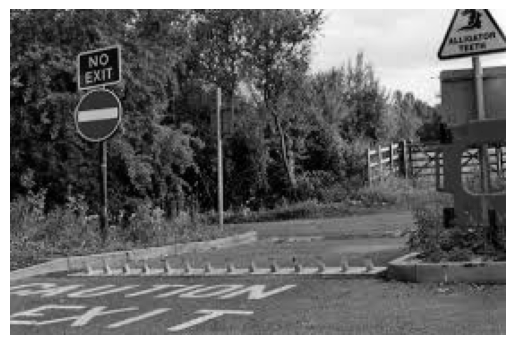

In [74]:
plt.imshow(img_gray_pixels_vector.reshape(img_gray_array.shape), cmap='gray')
plt.axis('off')  # Hide the axis
plt.show()

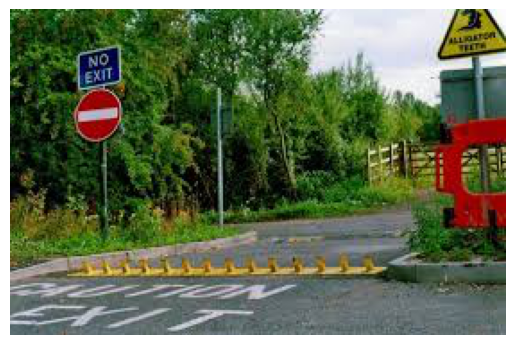

In [75]:
plt.imshow(img_color_pixels_vector.reshape(img_color_array.shape), cmap='gray')
plt.axis('off')  # Hide the axis
plt.show()

#### **Getting pixels features matrix for gray-scale images**

In this section we are going to use the  class `ImageFeaturesExtraction` from the `PyImageML` package , which has been developed to extract features array from data-sets of images, allowing different method for features extraction as well as different functionalities like working with both color and gray images, many filters, different formats and strategies for the different features extraction methods and so on.

In this section `ImageFeaturesExtraction` will be applied with the **pixels** method for feature extraction on **gray-scale** images, using the data-set of images presented above.

- **Array format**

In [76]:
img_feature_extraction = ImageFeaturesExtraction(method='pixels', image_height=img_height, image_width=img_width, 
                                                 convert_to_gray=True, filter=None, format='array')

gray_pixels_features_matrix = img_feature_extraction.fit_transform(X=X)

In [77]:
gray_pixels_features_matrix

array([[ 26,  19,  28, ..., 115, 110, 109],
       [ 44,  96, 109, ..., 151, 149, 149],
       [ 62, 102,  75, ..., 109, 131, 118],
       ...,
       [ 11,  10,  10, ...,   1,   2,   2],
       [  5,   6,   6, ...,   6,   4,  27],
       [148, 150, 152, ...,  33,  43,  48]], dtype=uint8)

In [78]:
gray_pixels_features_matrix.shape

(300, 44160)

- **Data-frame format**

In [79]:
img_feature_extraction = ImageFeaturesExtraction(method='pixels', image_height=img_height, image_width=img_width, 
                                                 convert_to_gray=True, filter=None, format='data-frame')

gray_pixels_features_matrix = img_feature_extraction.fit_transform(X=X)

In [80]:
gray_pixels_features_matrix

pixel_1_1,pixel_1_2,pixel_1_3,pixel_1_4,pixel_1_5,pixel_1_6,pixel_1_7,pixel_1_8,pixel_1_9,pixel_1_10,pixel_1_11,pixel_1_12,pixel_1_13,pixel_1_14,pixel_1_15,pixel_1_16,pixel_1_17,pixel_1_18,pixel_1_19,pixel_1_20,pixel_1_21,pixel_1_22,pixel_1_23,pixel_1_24,pixel_1_25,pixel_1_26,pixel_1_27,pixel_1_28,pixel_1_29,pixel_1_30,pixel_1_31,pixel_1_32,pixel_1_33,pixel_1_34,pixel_1_35,pixel_1_36,pixel_1_37,…,pixel_184_204,pixel_184_205,pixel_184_206,pixel_184_207,pixel_184_208,pixel_184_209,pixel_184_210,pixel_184_211,pixel_184_212,pixel_184_213,pixel_184_214,pixel_184_215,pixel_184_216,pixel_184_217,pixel_184_218,pixel_184_219,pixel_184_220,pixel_184_221,pixel_184_222,pixel_184_223,pixel_184_224,pixel_184_225,pixel_184_226,pixel_184_227,pixel_184_228,pixel_184_229,pixel_184_230,pixel_184_231,pixel_184_232,pixel_184_233,pixel_184_234,pixel_184_235,pixel_184_236,pixel_184_237,pixel_184_238,pixel_184_239,pixel_184_240
u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,…,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8
26,19,28,50,75,17,37,32,47,75,72,28,29,20,24,21,49,87,91,80,56,48,87,117,98,81,86,73,57,56,65,99,68,76,81,85,83,…,87,89,96,98,90,78,68,68,67,52,59,59,71,71,79,75,63,63,68,74,80,145,175,171,127,174,153,113,126,105,110,113,128,121,115,110,109
44,96,109,49,70,50,65,73,100,83,89,117,151,148,169,160,62,82,115,78,86,152,190,205,211,193,187,183,180,188,144,109,145,108,66,56,126,…,155,155,157,158,156,151,153,160,161,161,161,156,159,159,124,125,153,151,153,156,158,157,153,152,154,153,153,152,152,155,155,153,152,151,151,149,149
62,102,75,82,156,122,90,113,37,44,44,52,45,40,73,52,38,85,100,47,135,176,93,114,59,53,34,30,46,37,53,87,87,81,71,102,76,…,108,120,117,111,108,106,111,114,114,97,105,116,109,109,107,108,109,104,108,114,109,100,114,107,116,120,110,108,115,110,109,109,105,108,109,131,118
133,105,51,110,130,127,137,84,103,120,129,140,111,80,144,103,99,111,107,59,103,111,84,88,84,115,139,146,153,161,176,159,148,131,155,122,71,…,80,81,82,80,81,83,85,86,89,91,92,93,93,96,98,99,95,79,59,47,45,34,40,46,87,100,95,93,94,91,85,89,93,98,99,92,92
235,246,250,247,248,245,241,237,240,248,249,244,242,241,245,231,230,236,241,243,242,242,242,242,242,242,242,242,242,242,242,242,243,243,243,243,243,…,161,154,150,150,151,162,148,137,143,156,157,163,149,148,144,139,133,147,140,140,142,151,138,150,140,125,128,133,135,138,159,161,119,107,142,150,145
…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…
93,86,95,87,89,153,138,99,118,93,104,104,122,83,84,104,72,86,63,70,101,75,81,133,121,88,87,88,91,88,100,107,80,88,98,101,100,…,107,107,107,107,107,108,108,108,108,108,108,109,109,110,110,110,109,108,108,109,109,110,111,111,111,111,111,111,111,111,111,110,109,109,109,110,111
4,6,7,9,11,8,7,6,3,2,2,3,4,5,6,6,6,6,6,6,8,8,8,8,8,11,15,19,23,28,18,11,10,12,17,21,30,…,122,126,121,104,104,106,111,112,118,114,97,109,121,115,116,120,124,112,106,110,126,111,107,101,91,85,79,91,80,75,87,86,74,99,94,79,77
11,10,10,10,9,9,9,9,10,10,11,10,10,10,11,12,12,13,13,13,13,13,13,12,13,13,14,14,15,17,18,19,20,21,23,23,25,…,1,2,2,2,2,2,1,1,1,1,1,1,1,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,1,1,1,1,1,1,2,2


- **Applying equalization**

In [81]:
img_feature_extraction = ImageFeaturesExtraction(method='pixels', image_height=img_height, image_width=img_width, 
                                                 convert_to_gray=True, filter='equalized', format='array')

gray_pixels_features_filtered_matrix = img_feature_extraction.fit_transform(X=X)

In [82]:
gray_pixels_features_filtered_matrix

array([[6.91349638e-02, 4.56748188e-02, 7.71739130e-02, ...,
        5.79211957e-01, 5.48550725e-01, 5.41802536e-01],
       [6.11186594e-02, 3.41553442e-01, 4.19723732e-01, ...,
        6.42255435e-01, 6.28736413e-01, 6.28736413e-01],
       [3.23596014e-01, 6.44021739e-01, 4.18025362e-01, ...,
        7.19791667e-01, 8.49682971e-01, 8.01041667e-01],
       ...,
       [5.70312500e-01, 5.47961957e-01, 5.47961957e-01, ...,
        9.89130435e-02, 2.85665761e-01, 2.85665761e-01],
       [2.26449275e-04, 4.30253623e-04, 4.30253623e-04, ...,
        4.30253623e-04, 9.05797101e-05, 8.42617754e-02],
       [8.93432971e-01, 8.99230072e-01, 9.05049819e-01, ...,
        6.14356884e-02, 1.38337862e-01, 1.81227355e-01]])

In [83]:
gray_pixels_features_filtered_matrix.shape

(300, 44160)

- **Applying sobel filter**

In [84]:
img_feature_extraction = ImageFeaturesExtraction(method='pixels', image_height=img_height, image_width=img_width, 
                                                 convert_to_gray=True, filter='sobel', format='array')

gray_pixels_features_filtered_matrix = img_feature_extraction.fit_transform(X=X)

In [85]:
gray_pixels_features_filtered_matrix

array([[ 2.6925824 , 13.        , 20.98809186, ...,  7.77817459,
         4.24264069,  0.70710678],
       [37.83186488, 50.25497488, 32.669749  , ...,  1.60078106,
         1.41421356,  0.        ],
       [27.90721233, 18.51013236, 17.83605898, ..., 15.39683409,
         7.8142498 ,  9.48683298],
       ...,
       [ 0.70710678,  0.70710678,  0.        , ...,  0.70710678,
         0.70710678,  0.        ],
       [ 0.75      ,  0.55901699,  0.70710678, ..., 27.0935878 ,
        28.7108429 , 15.97654531],
       [11.01135777, 12.35161933, 14.63087489, ...,  2.15058132,
        10.85414667,  4.27200187]])

In [86]:
gray_pixels_features_filtered_matrix.shape

(300, 44160)

#### **Getting pixels features matrix for color images**

In this section we are going to use the  class `ImageFeaturesExtraction` from the `PyImageML` package , which has been developed to extract features matrices from data-sets of images, allowing different method for features extraction as well as different functionalities like working with both color and gray images, many filters, different formats and strategies for the different features extraction methods and so on.

In this section `ImageFeaturesExtraction` will be applied with the **pixels** method for feature extraction on **color** images, using the data-set of images presented above.

- **Array format**

In [87]:
img_feature_extraction = ImageFeaturesExtraction(method='pixels', image_height=img_height, image_width=img_width, 
                                                 convert_to_gray=False, filter=None, format='array')

color_pixels_features_matrix = img_feature_extraction.fit_transform(X=X)

In [88]:
color_pixels_features_matrix

array([[ 23,  28,  21, ..., 120, 111,  72],
       [ 43,  48,  26, ..., 136, 152, 168],
       [ 31,  87,  13, ..., 110, 121, 125],
       ...,
       [ 26,   5,   2, ...,   3,   1,   2],
       [ 18,   0,   0, ...,  41,  22,  14],
       [105, 155, 224, ...,  63,  44,  29]], dtype=uint8)

In [89]:
color_pixels_features_matrix.shape

(300, 132480)

- **Data-frame format**

In [90]:
img_feature_extraction = ImageFeaturesExtraction(method='pixels', image_height=img_height, image_width=img_width, 
                                                 convert_to_gray=False, filter=None, format='data-frame')

color_pixels_features_matrix = img_feature_extraction.fit_transform(X=X)

In [91]:
color_pixels_features_matrix

R_1_1,G_1_1,B_1_1,R_1_2,G_1_2,B_1_2,R_1_3,G_1_3,B_1_3,R_1_4,G_1_4,B_1_4,R_1_5,G_1_5,B_1_5,R_1_6,G_1_6,B_1_6,R_1_7,G_1_7,B_1_7,R_1_8,G_1_8,B_1_8,R_1_9,G_1_9,B_1_9,R_1_10,G_1_10,B_1_10,R_1_11,G_1_11,B_1_11,R_1_12,G_1_12,B_1_12,R_1_13,…,B_184_228,R_184_229,G_184_229,B_184_229,R_184_230,G_184_230,B_184_230,R_184_231,G_184_231,B_184_231,R_184_232,G_184_232,B_184_232,R_184_233,G_184_233,B_184_233,R_184_234,G_184_234,B_184_234,R_184_235,G_184_235,B_184_235,R_184_236,G_184_236,B_184_236,R_184_237,G_184_237,B_184_237,R_184_238,G_184_238,B_184_238,R_184_239,G_184_239,B_184_239,R_184_240,G_184_240,B_184_240
u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,…,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8,u8
23,28,21,15,22,12,25,31,19,47,53,40,72,79,63,14,21,4,34,41,26,29,35,21,44,50,40,72,77,72,69,74,69,25,29,30,26,…,108,188,171,153,167,150,130,127,111,88,138,125,98,118,104,75,121,110,77,124,114,78,139,130,93,130,123,83,125,117,76,121,112,73,120,111,72
43,48,26,94,100,80,105,114,97,42,54,40,62,75,65,42,55,48,57,69,66,66,76,75,95,103,102,80,84,84,88,90,88,116,116,124,150,…,163,146,155,162,146,155,162,145,154,162,145,154,163,148,156,166,148,156,167,146,154,165,145,153,166,145,152,165,143,152,165,136,152,168,136,152,168
31,87,13,74,126,54,50,97,27,56,105,34,127,180,108,88,148,73,55,117,41,83,137,65,17,55,0,36,57,0,29,61,0,16,79,6,12,…,116,115,123,120,106,112,110,105,109,110,111,116,117,105,111,114,101,112,113,98,113,113,92,110,110,97,112,114,101,112,116,123,134,138,110,121,125
153,127,110,121,102,81,62,50,25,117,112,82,139,131,100,141,125,97,157,132,107,104,79,56,119,100,76,131,119,97,138,129,106,155,137,117,125,…,74,103,101,88,98,96,83,96,94,81,97,95,82,94,92,79,88,86,73,92,90,77,96,94,81,101,99,86,102,100,87,95,93,80,95,93,80
235,235,237,246,246,248,250,250,252,247,247,249,248,248,250,245,245,247,241,241,243,237,237,239,240,240,242,248,248,250,249,249,252,244,243,249,242,…,124,133,124,109,136,127,112,141,132,117,143,134,119,146,137,122,167,158,143,169,160,145,127,118,103,115,106,91,150,141,126,158,149,134,153,144,129
…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…
99,97,59,92,90,52,101,99,61,93,91,53,95,93,55,159,157,119,144,142,104,105,103,65,124,122,84,99,97,57,111,108,67,112,108,66,130,…,116,105,113,116,105,113,116,105,113,116,105,113,116,105,113,116,105,113,116,104,112,115,103,111,114,105,110,114,106,109,114,107,110,115,108,111,116
4,5,0,6,7,2,7,8,3,9,10,5,11,12,7,8,9,4,7,8,3,6,7,2,3,4,0,2,3,0,2,3,0,3,4,0,4,…,25,106,86,22,100,80,17,111,93,30,100,82,20,94,77,15,105,89,29,103,89,28,91,76,16,116,101,42,109,97,37,94,83,20,92,81,17
26,5,2,25,4,1,25,4,1,25,4,1,24,3,0,24,3,0,23,4,0,23,4,0,26,4,1,27,3,1,29,3,2,28,3,1,30,…,0,6,0,0,6,0,0,6,0,0,6,0,0,3,1,0,2,1,0,2,1,0,2,1,0,2,1,0,2,1,0,3,1,2,3,1,2


- **Applying equalization**

In [92]:
img_feature_extraction = ImageFeaturesExtraction(method='pixels', image_height=img_height, image_width=img_width, 
                                                 convert_to_gray=False, filter='equalized', format='array')

color_pixels_features_filtered_matrix = img_feature_extraction.fit_transform(X=X)

In [93]:
color_pixels_features_filtered_matrix

array([[4.65089942e-02, 5.66196451e-02, 4.24647339e-02, ...,
        5.48270993e-01, 5.07150669e-01, 3.28962596e-01],
       [4.72852531e-02, 5.27835383e-02, 2.85910833e-02, ...,
        6.21546825e-01, 6.94669981e-01, 7.67793137e-01],
       [1.28630418e-01, 3.60995045e-01, 5.39417883e-02, ...,
        6.55259591e-01, 7.20785550e-01, 7.44613171e-01],
       ...,
       [5.26830199e-01, 1.01313500e-01, 4.05253999e-02, ...,
        6.63003517e-02, 2.21001172e-02, 4.42002344e-02],
       [2.52291134e-04, 0.00000000e+00, 0.00000000e+00, ...,
        2.30458316e-02, 1.23660560e-02, 7.86930834e-03],
       [3.94867372e-01, 5.82899453e-01, 8.42383726e-01, ...,
        2.05513093e-01, 1.43532954e-01, 9.46012648e-02]])

In [94]:
color_pixels_features_filtered_matrix.shape

(300, 132480)

- **Applying canny filter**

In [228]:
img_feature_extraction = ImageFeaturesExtraction(method='pixels', image_height=img_height, image_width=img_width, 
                                                 convert_to_gray=False, filter='convolve', weights=mask_3, format='array')

color_pixels_features_filtered_matrix = img_feature_extraction.fit_transform(X=X)

In [96]:
color_pixels_features_filtered_matrix

array([[0.00900378, 0.01096112, 0.00822084, ..., 0.00277297, 0.002565  ,
        0.00166378],
       [0.13352273, 0.14904863, 0.08073467, ..., 0.00224478, 0.00250888,
        0.00277297],
       [0.03868009, 0.10855381, 0.01622068, ..., 0.03273887, 0.03601276,
        0.03720327],
       ...,
       [0.00277297, 0.00053326, 0.00021331, ..., 0.        , 0.        ,
        0.        ],
       [0.00277297, 0.        , 0.        , ..., 0.06980089, 0.03745414,
        0.02383445],
       [0.02024147, 0.02988026, 0.0431818 , ..., 0.01675295, 0.01170047,
        0.00771167]])

In [97]:
color_pixels_features_filtered_matrix.shape

(300, 132480)

#### **Getting pixels features tensor for gray-scale images**

In this section we are going to present the  class `ImageTensorFeaturesExtraction` from the `PyImageML` package , which has been developed to extract features tensors from data-sets of images, is based in the pixels method for features extraction, and allows both color and gray images, and different formats to deal with the color images.

In this section `ImageTensorFeaturesExtraction` will be applied on gray-scale images, using the data-set of images presented above.

In [98]:
img_feature_extraction = ImageTensorFeaturesExtraction(image_height=img_height, image_width=img_width, convert_to_gray=True)
gray_pixels_features_tensor = img_feature_extraction.fit_transform(X=X)

In [99]:
gray_pixels_features_tensor

array([[[ 26,  19,  28, ...,  75,  63,  59],
        [ 21,  48,  43, ...,  81,  53,  46],
        [ 21,  49,  47, ...,  92,  59,  44],
        ...,
        [145, 206, 205, ..., 119, 110, 109],
        [130, 185, 173, ..., 115, 110, 109],
        [136, 163, 170, ..., 115, 110, 109]],

       [[ 44,  96, 109, ..., 225, 233, 229],
        [ 42, 100, 130, ..., 220, 235, 246],
        [ 61,  77, 139, ..., 218, 241, 239],
        ...,
        [ 73,  70,  80, ..., 151, 153, 153],
        [ 71,  69,  77, ..., 151, 149, 149],
        [ 71,  69,  78, ..., 151, 149, 149]],

       [[ 62, 102,  75, ..., 251, 251, 252],
        [ 49,  70,  60, ..., 251, 252, 252],
        [ 65,  83,  85, ..., 251, 252, 252],
        ...,
        [104, 105, 102, ..., 103, 113, 108],
        [105, 108, 103, ..., 105, 122, 113],
        [108, 106, 102, ..., 109, 131, 118]],

       ...,

       [[ 11,  10,  10, ...,   4,   4,   4],
        [ 11,  10,  10, ...,   4,   4,   4],
        [ 11,  10,  10, ...,   4,   4,   4

In [100]:
gray_pixels_features_tensor.shape

(300, 240, 184)

#### **Getting pixels features tensor for color images**

In this section we are going to use the  class `ImageTensorFeaturesExtraction` from the `PyImageML` package , which has been developed to extract features tensors from data-sets of images, is based in the pixels method for features extraction, and allows both color and gray images, and different formats to deal with the color images.

In this section `ImageTensorFeaturesExtraction` will be applied on color images, using the data-set of images presented above.

- **Tensor of 2D arrays**

In [101]:
img_feature_extraction = ImageTensorFeaturesExtraction(image_height=img_height, image_width=img_width, convert_to_gray=False, color_dim='2D')
color_pixels_features_tensor = img_feature_extraction.fit_transform(X=X)

In [102]:
color_pixels_features_tensor

array([[[ 23.,  28.,  21., ...,  52.,  64.,  54.],
        [ 18.,  23.,  17., ...,  39.,  51.,  38.],
        [ 18.,  23.,  17., ...,  38.,  49.,  34.],
        ...,
        [142., 143., 162., ..., 120., 111.,  71.],
        [125., 130., 142., ..., 120., 111.,  72.],
        [132., 136., 148., ..., 120., 111.,  72.]],

       [[ 43.,  48.,  26., ..., 226., 229., 236.],
        [ 41.,  46.,  24., ..., 243., 246., 251.],
        [ 60.,  65.,  43., ..., 236., 239., 244.],
        ...,
        [ 69.,  74.,  78., ..., 147., 154., 162.],
        [ 68.,  71.,  76., ..., 135., 152., 169.],
        [ 68.,  71.,  76., ..., 136., 152., 168.]],

       [[ 31.,  87.,  13., ..., 254., 250., 255.],
        [ 16.,  73.,   8., ..., 253., 251., 255.],
        [ 32.,  90.,  25., ..., 253., 251., 255.],
        ...,
        [ 90., 109., 113., ..., 100., 111., 115.],
        [ 91., 110., 114., ..., 105., 116., 120.],
        [ 94., 113., 117., ..., 110., 121., 125.]],

       ...,

       [[ 26.,   5.,   2

In [103]:
color_pixels_features_tensor.shape

(300, 240, 552)

- **Tensor of 3D arrays**

In [104]:
img_feature_extraction = ImageTensorFeaturesExtraction(image_height=img_height, image_width=img_width, convert_to_gray=False, color_dim='3D')
color_pixels_features_tensor = img_feature_extraction.fit_transform(X=X)

In [105]:
color_pixels_features_tensor

array([[[[ 23,  28,  21],
         [ 15,  22,  12],
         [ 25,  31,  19],
         ...,
         [ 68,  81,  60],
         [ 55,  67,  59],
         [ 52,  64,  54]],

        [[ 18,  23,  17],
         [ 45,  50,  43],
         [ 40,  46,  36],
         ...,
         [ 74,  87,  66],
         [ 46,  58,  45],
         [ 39,  51,  38]],

        [[ 18,  23,  17],
         [ 47,  51,  44],
         [ 44,  50,  40],
         ...,
         [ 85,  98,  78],
         [ 53,  64,  49],
         [ 38,  49,  34]],

        ...,

        [[142, 143, 162],
         [204, 205, 220],
         [203, 205, 214],
         ...,
         [129, 121,  82],
         [121, 112,  72],
         [120, 111,  71]],

        [[125, 130, 142],
         [181, 185, 197],
         [167, 174, 183],
         ...,
         [125, 117,  76],
         [121, 112,  73],
         [120, 111,  72]],

        [[132, 136, 148],
         [160, 163, 175],
         [165, 171, 180],
         ...,
         [125, 117,  76],
        

In [106]:
color_pixels_features_tensor.shape

(300, 240, 184, 3)

### **Histogram of Oriented Gradients Method**

HOG (Histogram of Oriented Gradients) is a technique used for feature extraction in image processing and computer vision tasks like object detection and classification. It works by dividing an image into small regions, computes the gradient orientation within each region, and then builds a histogram of these gradients. The resulting feature vector represents the distribution of gradient orientations, capturing important information about the edges and textures present in the image. HOG is particularly effective for recognizing objects in images regardless of changes in lighting conditions and backgrounds, making it a popular choice in various applications such as pedestrian detection, face recognition, and surveillance.

A brief summary of how Histogram of Oriented Gradients (HOG) works as a feature extraction method for images:

- **Gradient Calculation:** Compute the gradient (derivative) of pixel intensities in the image to capture local edge information. Typically, gradient magnitude and direction are computed using gradient filters like the Sobel operator.

- **Cell Division:** Divide the image into small, overlapping cells (e.g., 8x8 pixels). Each cell accumulates gradient information by constructing histograms of gradient orientations.

- **Histograms of Oriented Gradients:** Within each cell, construct histograms of gradient orientations to represent the distribution of edge directions. This captures local texture and shape information.

- **Block Normalization:** Group cells into larger blocks (e.g., 2x2 or 3x3 cells) to enhance local contrast and normalize illumination changes. Normalize the histograms within each block to make the descriptor invariant to changes in lighting and contrast.

- **Descriptor Formation:** Concatenate the normalized block features to form the final HOG descriptor for the image. This descriptor captures the local intensity gradients and their orientations across different regions of the image.

- **Feature Vector Extraction:** The HOG descriptor forms a feature vector representing the image. This feature vector can be used as input to machine learning algorithms for tasks such as object detection, classification, or similarity comparison.

The method `hog` from the module `feature` of the `skimage` package provides a way to compute a Histogram of Oriented Gradients (HOG) by:

- Global image normalisation (optional)

- Computing the gradient image in x and y

- Computing gradient histograms

- Normalising across blocks

- Flattening into a feature vector 

HOG usually works on gray-scale images, so images should be converted to gray-scale before serving as input for this method.

Once we have the HOG feature vector for a given image we can proceed in several ways, specifically the following will be considered throughout this project:

- Consider the HOG features vector as the numerical representation of the image. 

   - This approach usually leads to a computational problem since the length of this vectors is usually massive, but this issue can be mitigated utilizing dimensionality reduction techniques, such as PCA.

- Transform the HOG features vector into a features matrix.

   - Transform the features matrix in a new features vector by computing **statistics** along the matrix columns.
   - Transform the features matrix in a new features vector by computing the **histogram of bags of visual words** (BVW).

In order to understand better how HOG works we are going to apply it to several images, and plot the resulting HOG image along with the original one, to compare and extract valuable insight regarding this method just in a visual manner. 

Here a classic example, provided in the `skimage` documentation.

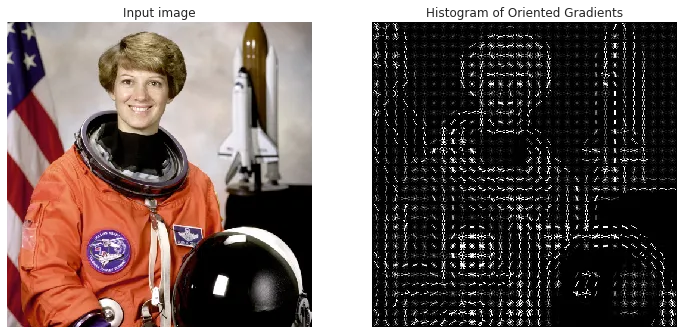

In [107]:
Image.open(r'C:\Users\fscielzo\Documents\DataScience-GitHub\Image Analysis\Image-Classification\Fire-Classification\images\HOG_1.webp')

The next plot includes several images of our data-set together with its HOG representation.

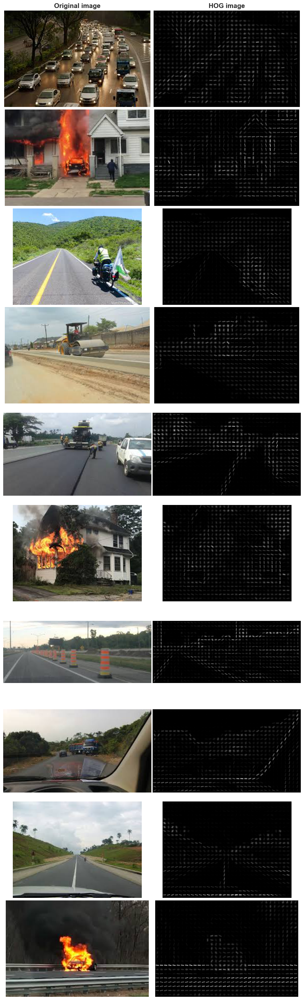

In [108]:
CELLS_PER_BLOCK_HOR = 2
CELLS_PER_BLOCK_VER = 2
PIXELS_PER_CELL_HOR = 8
PIXELS_PER_CELL_VER = 8
orientations = 8
pixels_per_cell=(PIXELS_PER_CELL_HOR, PIXELS_PER_CELL_VER)
cells_per_block=(CELLS_PER_BLOCK_HOR, CELLS_PER_BLOCK_VER)

n_images = 9
np.random.seed(0)
random_idx = np.random.choice(len(X), n_images, replace=False).tolist()
random_idx = random_idx + [103]
img_gray_array_list = [np.array(Image.open(X[i]).convert('L')) for i in random_idx]
img_color_array_list = [np.array(Image.open(X[i])) for i in random_idx]

HOG_visualize_list = []
for img_array in img_gray_array_list:
    
    HOG_img, HOG_visualize = feature.hog(img_array, orientations=orientations,
                pixels_per_cell=pixels_per_cell,
                cells_per_block=cells_per_block,
                transform_sqrt=True, visualize=True)
    
    HOG_visualize_list.append(HOG_visualize)
    
n_rows = len(list(zip(img_color_array_list, HOG_visualize_list)))
subplot_idx = [(i, i + 1) for i in range(0, n_rows*2, 2)]

fig, axes = plt.subplots(n_rows, 2, figsize=(12,40))
axes = axes.flatten() 

for (i, j), img_color_array, HOG_visualize in zip(subplot_idx, img_color_array_list, HOG_visualize_list):
    
    axes[i].imshow(img_color_array, cmap='gray')
    axes[j].imshow(HOG_visualize, cmap='gray')
    
    if i == 0:
        axes[i].set_title('Original image', size=15, weight='bold')
        axes[j].set_title('HOG image', size=15, weight='bold')

for i in range(len(axes)):
    axes[i].axis('off')  # Hide the axis

plt.subplots_adjust(hspace=0.025, wspace=0.01) 
plt.show()

Now we are going to explore how are the outputs resulting of applying HOG on an image.

- **HOG features vector**

In [109]:
img_gray_array = np.array(Image.open(X[103]).convert('L'))

HOG_img, HOG_visualize = feature.hog(img_gray_array, orientations=orientations,
                pixels_per_cell=pixels_per_cell,
                cells_per_block=cells_per_block,
                transform_sqrt=True, visualize=True)

In [110]:
HOG_img

array([0.36364343, 0.03360488, 0.02089678, ..., 0.03660126, 0.02114829,
       0.01176881])

In [111]:
HOG_img.shape

(23232,)

- **HOG feature matrix:** reshaping the features vector into a matrix.

In [112]:
p = orientations * cells_per_block[0] * cells_per_block[1] # number of features
n = int(np.shape(HOG_img)[0]/p) # length of the features
HOG_img = np.reshape(HOG_img, (n, p))

In [113]:
HOG_img

array([[0.36364343, 0.03360488, 0.02089678, ..., 0.03471119, 0.04365133,
        0.        ],
       [0.47612765, 0.        , 0.        , ..., 0.0672579 , 0.12666173,
        0.        ],
       [0.38112443, 0.        , 0.07521982, ..., 0.        , 0.048066  ,
        0.        ],
       ...,
       [0.15979678, 0.0981024 , 0.16545619, ..., 0.14736083, 0.08917909,
        0.03633761],
       [0.04752936, 0.15648015, 0.12212673, ..., 0.11533974, 0.05735903,
        0.00558269],
       [0.25748894, 0.28158486, 0.11105426, ..., 0.03660126, 0.02114829,
        0.01176881]])

In [114]:
HOG_img.shape

(726, 32)

#### **Based on Statistics**



Statistics aggregation can be used to transform the `HOG_img` matrix into a features vector that represent the given image. In other words, to extracts a features vector for a given images based on HOG.

In the next cells a couple of examples of how to do it are shown.

- **Statistics:** **mean**

In [115]:
HOG_img_mean = np.mean(HOG_img, axis=0)
HOG_img_mean

array([0.14679672, 0.0803544 , 0.09536614, 0.1419433 , 0.21723404,
       0.08575819, 0.10150205, 0.08248819, 0.14743567, 0.08275199,
       0.09822818, 0.1462247 , 0.21792027, 0.08908326, 0.10341332,
       0.08480108, 0.15140446, 0.08353412, 0.09937754, 0.16057091,
       0.23059348, 0.09163763, 0.1043415 , 0.08710898, 0.15154042,
       0.08582017, 0.100348  , 0.16331974, 0.23107536, 0.09231949,
       0.10460763, 0.08779868])

In [116]:
HOG_img_mean.shape

(32,)

- **Statistics:** **mean-std**

In [117]:
HOG_img_mean = np.mean(HOG_img, axis=0)
HOG_img_std = np.std(HOG_img, axis=0)
HOG_img_stats = np.hstack([HOG_img_mean, HOG_img_std])
HOG_img_stats

array([0.14679672, 0.0803544 , 0.09536614, 0.1419433 , 0.21723404,
       0.08575819, 0.10150205, 0.08248819, 0.14743567, 0.08275199,
       0.09822818, 0.1462247 , 0.21792027, 0.08908326, 0.10341332,
       0.08480108, 0.15140446, 0.08353412, 0.09937754, 0.16057091,
       0.23059348, 0.09163763, 0.1043415 , 0.08710898, 0.15154042,
       0.08582017, 0.100348  , 0.16331974, 0.23107536, 0.09231949,
       0.10460763, 0.08779868, 0.1317824 , 0.09294007, 0.09738209,
       0.15405147, 0.13246163, 0.09432467, 0.110728  , 0.10418498,
       0.13221261, 0.09430074, 0.09785966, 0.15478669, 0.13196037,
       0.09770127, 0.11163924, 0.10598677, 0.134641  , 0.09318608,
       0.09613184, 0.1606208 , 0.13438775, 0.09621373, 0.11163673,
       0.10831574, 0.13312731, 0.09576936, 0.0957986 , 0.15947756,
       0.13395827, 0.09442077, 0.11003086, 0.10837857])

In [118]:
HOG_img_stats.shape

(64,)



#### **Based on Bags of Visual Words (BVW)**

The following diagram explains how the BVW can be used to extract a features vector from an image based on HOG.

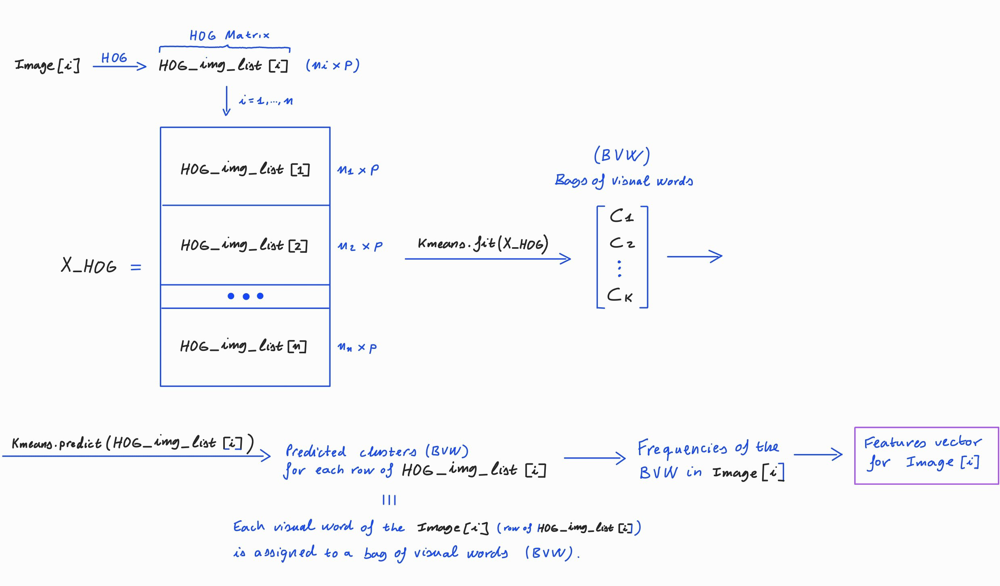

In [119]:
Image.open(r'C:\Users\fscielzo\Documents\DataScience-GitHub\Image Analysis\Image-Classification\Fire-Classification\images\HOG_2.jpg')

### **HOG-stats features matrix**

Given $n$ images $\mathcal{I}_1,\dots , \mathcal{I}_n$ of the same size $h\times w$.

Using the **HOG** method for features extraction **based on statistics**, a **features matrix** for those images can be build as follows: 

$$X =   \begin{pmatrix} v(\mathcal{I}_1)  \\
                        v(\mathcal{I}_2)    \\
                        \dots  \\
                        v(\mathcal{I}_n) 
                        \end{pmatrix} $$

Now $v(\mathcal{I}_i)$  is the a vector of statistics computed by columns on the HOG features matrix $\mathcal{M}(\mathcal{I}_i)$ (`HOG_img`) for the image $\mathcal{I}_i$ $\hspace{0.1cm}\Rightarrow\hspace{0.1cm}$ $v(\mathcal{I}_i)= $ `HOG_img_stats`.

This matrix is a 2D array of size $n\times p$  that contains the HOG statistics of each image.

>Extracting the vector `HOG_img_stats` for each image on the data-set and concatenating them by rows we obtain a HGO-stats features matrix.

#### **Getting HGO-stats features matrix**

In this section we are going to use the  class `ImageFeaturesExtraction` from the `PyImageML` package , which has been developed to extract features matrices from data-sets of images, allowing different method for features extraction as well as different functionalities like working with both color and gray images, many filters, different formats and strategies for the different features extraction methods and so on.

In this section `ImageFeaturesExtraction` will be applied with the **HOG** method for feature extraction based on **statistics**, using the data-set of images presented above.

- **Statistics: mean**

In [120]:
img_feature_extraction = ImageFeaturesExtraction(method='HOG', image_height=img_height, image_width=img_width, filter=None, reshape=True,
                                                 orientations=orientations, pixels_per_cell=pixels_per_cell, cells_per_block=cells_per_block, 
                                                 transform_sqrt=True, statistics='mean')

HGO_features_matrix = img_feature_extraction.fit_transform(X=X)

In [121]:
HGO_features_matrix

array([[0.20157584, 0.14783572, 0.12745415, ..., 0.10648443, 0.13134968,
        0.18349608],
       [0.17286368, 0.14136847, 0.15825279, ..., 0.11890768, 0.11860601,
        0.1418163 ],
       [0.18598968, 0.15119294, 0.1556355 , ..., 0.12523065, 0.1435575 ,
        0.16787505],
       ...,
       [0.23156577, 0.10066881, 0.10889268, ..., 0.0777515 , 0.11607629,
        0.11501912],
       [0.25385873, 0.13853749, 0.08665303, ..., 0.09441686, 0.16071724,
        0.22178972],
       [0.19882647, 0.15653812, 0.14570778, ..., 0.12343722, 0.13397905,
        0.15106539]])

In [122]:
HGO_features_matrix.shape

(300, 32)

- **Statistics: mean-Q25-median-Q75-std**

In [123]:
img_feature_extraction = ImageFeaturesExtraction(method='HOG', image_height=img_height, image_width=img_width, filter=None, reshape=True,
                                                 orientations=orientations, pixels_per_cell=pixels_per_cell, cells_per_block=cells_per_block, 
                                                 transform_sqrt=True, statistics='mean-Q25-median-Q75-std')

HGO_features_matrix = img_feature_extraction.fit_transform(X=X)

In [124]:
HGO_features_matrix

array([[0.20157584, 0.14783572, 0.12745415, ..., 0.07722948, 0.08753731,
        0.09752229],
       [0.17286368, 0.14136847, 0.15825279, ..., 0.08342822, 0.08358776,
        0.10379498],
       [0.18598968, 0.15119294, 0.1556355 , ..., 0.07379397, 0.08382094,
        0.09449716],
       ...,
       [0.23156577, 0.10066881, 0.10889268, ..., 0.08503151, 0.10009281,
        0.11873147],
       [0.25385873, 0.13853749, 0.08665303, ..., 0.08438005, 0.10134144,
        0.10840959],
       [0.19882647, 0.15653812, 0.14570778, ..., 0.08484173, 0.0841926 ,
        0.10205706]])

In [125]:
HGO_features_matrix.shape

(300, 160)

- **Applying equalization**

In [126]:
img_feature_extraction = ImageFeaturesExtraction(method='HOG', image_height=img_height, image_width=img_width, filter='equalized', reshape=True, 
                                                 orientations=orientations, pixels_per_cell=pixels_per_cell, cells_per_block=cells_per_block, 
                                                 transform_sqrt=True, statistics='mean')

HGO_features_filtered_matrix = img_feature_extraction.fit_transform(X=X)

In [127]:
HGO_features_filtered_matrix

array([[0.20078454, 0.14787799, 0.12604256, ..., 0.10548965, 0.13279582,
        0.18339162],
       [0.17293476, 0.14033908, 0.1537719 , ..., 0.11915944, 0.11854023,
        0.14170413],
       [0.18746046, 0.15079661, 0.14928058, ..., 0.12890023, 0.14689157,
        0.16894386],
       ...,
       [0.23320771, 0.08942915, 0.1014497 , ..., 0.07468827, 0.11502458,
        0.11756563],
       [0.25469751, 0.13832403, 0.08580414, ..., 0.09091659, 0.16319569,
        0.22209216],
       [0.19423289, 0.15211316, 0.14351524, ..., 0.12170027, 0.12920767,
        0.15031476]])

In [128]:
HGO_features_filtered_matrix.shape

(300, 32)

- **Applying hessian filter**

In [230]:
img_feature_extraction = ImageFeaturesExtraction(method='HOG', image_height=img_height, image_width=img_width, filter='hessian', reshape=True, 
                                                 orientations=orientations, pixels_per_cell=pixels_per_cell, cells_per_block=cells_per_block, 
                                                 transform_sqrt=True, statistics='mean')

HGO_features_filtered_matrix = img_feature_extraction.fit_transform(X=X)

In [130]:
HGO_features_filtered_matrix

array([[0.28585633, 0.        , 0.19304062, ..., 0.        , 0.16715185,
        0.        ],
       [0.27183791, 0.        , 0.20453637, ..., 0.        , 0.16509091,
        0.        ],
       [0.27910474, 0.        , 0.20370942, ..., 0.        , 0.18003112,
        0.        ],
       ...,
       [0.27305116, 0.        , 0.15890674, ..., 0.        , 0.14750259,
        0.        ],
       [0.31766275, 0.        , 0.17075564, ..., 0.        , 0.18349657,
        0.        ],
       [0.28188325, 0.        , 0.20472227, ..., 0.        , 0.17397396,
        0.        ]])

In [131]:
HGO_features_filtered_matrix.shape

(300, 32)

### **HOG-BVW features matrix**

Given $n$ images $\mathcal{I}_1,\dots , \mathcal{I}_n$ of the same size $h\times w$.

Using the **HOG** method for features extraction **based on BVW**, a **features matrix** for those images can be build as follows: 

$$X =   \begin{pmatrix} v(\mathcal{I}_1)  \\
                        v(\mathcal{I}_2)    \\
                        \dots  \\
                        v(\mathcal{I}_n) 
                        \end{pmatrix} $$

Now $v(\mathcal{I}_i)$ is the a vector of BVW frequencies for the image $\mathcal{I}_i$.

This matrix is a 2D array of size $n\times p$  that contains the BVW frequencies for each image.

>Extracting the vector of BVW frequencies for each image  on the data-set (like it is shown in the diagram) and concatenating them by rows we obtain a HGO-BVW features matrix.

#### **Getting HGO-BVW features matrix**

In this section we are going to use the  class `ImageFeaturesExtraction` from the `PyImageML` package , which has been developed to extract features matrices from data-sets of images, allowing different method for features extraction as well as different functionalities like working with both color and gray images, many filters, different formats and strategies for the different features extraction methods and so on.

In this section `ImageFeaturesExtraction` will be applied with the **HOG** method for feature extraction based on **BVW**, using the data-set of images presented above.

In [132]:
img_feature_extraction = ImageFeaturesExtraction(method='HOG', image_height=img_height, image_width=img_width, filter=None, reshape=True, 
                                                 orientations=orientations, pixels_per_cell=pixels_per_cell, cells_per_block=cells_per_block, 
                                                 transform_sqrt=True, statistics='BVW', n_clusters=100)

HGO_features_matrix = img_feature_extraction.fit_transform(X=X)

c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [133]:
HGO_features_matrix

array([[ 3,  9,  7, ...,  3,  2, 15],
       [ 1,  5, 12, ...,  2,  0, 13],
       [ 5,  8, 20, ...,  0,  4, 40],
       ...,
       [ 3,  5, 13, ...,  1,  4, 14],
       [ 9, 19, 14, ...,  2,  3,  3],
       [10,  5,  7, ...,  6,  0, 10]], dtype=int64)

In [134]:
HGO_features_matrix.shape

(300, 100)

- **Filtering with sobel** 

In [135]:
img_feature_extraction = ImageFeaturesExtraction(method='HOG', image_height=img_height, image_width=img_width, filter='sobel', reshape=True, 
                                                 orientations=orientations, pixels_per_cell=pixels_per_cell, cells_per_block=cells_per_block, 
                                                 transform_sqrt=True, statistics='BVW', n_clusters=100)

HGO_features_filtered_matrix = img_feature_extraction.fit_transform(X=X)

c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [136]:
HGO_features_filtered_matrix

array([[ 4,  5,  5, ...,  0,  7, 11],
       [ 3,  2, 15, ...,  0,  8,  2],
       [ 0,  2, 12, ...,  0, 10,  0],
       ...,
       [ 3,  8,  1, ..., 11,  6,  0],
       [ 0,  4,  0, ...,  0, 13, 14],
       [ 4,  2,  6, ...,  0,  1,  1]], dtype=int64)

In [137]:
HGO_features_filtered_matrix.shape

(300, 100)

### **HOG - Not Reshaped features matrix**

Given $n$ images $\mathcal{I}_1,\dots , \mathcal{I}_n$ of the same size $h\times w$.

Using the **HOG** method for features extraction **based on not reshaped HOG features**, a **features matrix** for those images can be build as follows: 

$$X =   \begin{pmatrix} v(\mathcal{I}_1)  \\
                        v(\mathcal{I}_2)    \\
                        \dots  \\
                        v(\mathcal{I}_n) 
                        \end{pmatrix} $$

Now $v(\mathcal{I}_i)$ is the a vector of HOG not reshaped features for the image $\mathcal{I}_i$ 

This matrix is a 2D array of size $n\times p$ that contains the not reshaped HOG features for each image.

>Extracting the not reshape HGO features for each image on the data-set and concatenating them by rows we obtain a HGO - not reshaped features matrix.

- The **problem** of this approach is that leads to a **dimensionality problem** on $p$, so it needs to be applied along with **dimensionality reduction** techniques such as PCA.

#### **Getting HGO - Not Reshaped features matrix**

In this section we are going to use the  class `ImageFeaturesExtraction` from the `PyImageML` package , which has been developed to extract features matrices from data-sets of images, allowing different method for features extraction as well as different functionalities like working with both color and gray images, many filters, different formats and strategies for the different features extraction methods and so on.

In this section `ImageFeaturesExtraction` will be applied with the **HOG** method for feature extraction based on **not reshaping**, using the data-set of images presented above.

In [81]:
img_feature_extraction = ImageFeaturesExtraction(method='HOG', image_height=img_height, image_width=img_width, filter=None, reshape=False,
                                                 orientations=orientations, pixels_per_cell=pixels_per_cell, cells_per_block=cells_per_block, 
                                                 transform_sqrt=True)

HGO_features_matrix = img_feature_extraction.fit_transform(X=X)

In [82]:
HGO_features_matrix

array([[0.23803907, 0.04517031, 0.11159217, ..., 0.13129353, 0.08770483,
        0.09647536],
       [0.24584797, 0.02077305, 0.0480539 , ..., 0.22148548, 0.13344476,
        0.09433893],
       [0.23915977, 0.23915977, 0.14695772, ..., 0.23245254, 0.23245254,
        0.11289806],
       ...,
       [0.45553614, 0.        , 0.        , ..., 0.        , 0.12639003,
        0.        ],
       [0.26050084, 0.28689935, 0.28689935, ..., 0.12227303, 0.11154988,
        0.27509187],
       [0.05024678, 0.00761688, 0.13056183, ..., 0.0925665 , 0.11715885,
        0.21169244]])

In [83]:
HGO_features_matrix.shape

(300, 20416)

- **Filtering with sobel**

In [141]:
img_feature_extraction = ImageFeaturesExtraction(method='HOG', image_height=img_height, image_width=img_width, filter='sobel', reshape=False,
                                                 orientations=orientations, pixels_per_cell=pixels_per_cell, cells_per_block=cells_per_block, 
                                                 transform_sqrt=True)

HGO_features_matrix = img_feature_extraction.fit_transform(X=X)

In [142]:
HGO_features_matrix

array([[0.16068715, 0.02210637, 0.08932776, ..., 0.21273152, 0.08234161,
        0.12393073],
       [0.22659834, 0.12988755, 0.04618949, ..., 0.24691583, 0.12855758,
        0.11606701],
       [0.22888939, 0.11324927, 0.22888939, ..., 0.2248361 , 0.2248361 ,
        0.17443813],
       ...,
       [0.41634108, 0.        , 0.        , ..., 0.        , 0.07710316,
        0.06034293],
       [0.29468638, 0.09417174, 0.02467003, ..., 0.21154874, 0.09705226,
        0.24505233],
       [0.07725128, 0.04226268, 0.05836576, ..., 0.11682897, 0.22934459,
        0.13684988]])

In [143]:
HGO_features_matrix.shape

(300, 20416)

### **Convolutional Neural Networks Method**

Using Convolutional Neural Networks (CNNs) for extracting image features offers several advantages:

- **Hierarchical Feature Learning:** CNNs are designed to automatically learn hierarchical representations of features from raw input data. In the case of images, lower layers typically learn simple features like edges and textures, while higher layers learn more complex features like object parts and whole objects. By using a pre-trained CNN, you leverage the knowledge encoded in these learned features without having to manually engineer them.

- **Transfer Learning:** Pre-trained CNN models, such as VGG, ResNet, or Inception, have been trained on large-scale datasets like ImageNet for image classification tasks. These models have learned to recognize a wide variety of visual patterns and concepts. By using these pre-trained models as feature extractors, you can transfer this learned knowledge to new tasks or datasets with relatively little data. This is particularly useful when you have a small dataset or limited computational resources for training your own models from scratch.

- **Dimensionality Reduction:** The features extracted by CNNs typically reside in high-dimensional spaces, capturing rich information about the input images. These features can be used to represent images in a more compact and meaningful way compared to raw pixel values. This can be particularly beneficial for tasks such as image retrieval, where you want to efficiently compare images based on their visual content.

- **Robustness to Variations:** CNNs are designed to be robust to various transformations and distortions in the input images, such as changes in scale, rotation, illumination, and partial occlusion. The features learned by CNNs tend to capture invariant properties of objects, making them effective for tasks like object recognition and detection under different conditions.

- **Interpretable Representations:** The features learned by CNNs often correspond to semantically meaningful concepts in the images, such as object shapes, textures, or parts. This makes the extracted features more interpretable compared to handcrafted features, allowing for better understanding of the underlying characteristics of the data.

In [144]:
# Load CNN model
model = VGG16()
# Remove the output layer
model = Model(inputs=model.inputs, outputs=model.layers[-2].output)
# Extracting the image height and width expected for the used CNN model.
img_height_CNN = model.inputs[0].shape[1]
img_width_CNN = model.inputs[0].shape[2]

# Load an image from file
img_path = X[103]
x = tf.keras.preprocessing.image.load_img(img_path, target_size=(img_width_CNN, img_height_CNN))
# Convert the image pixels to a numpy array
x = tf.keras.preprocessing.image.img_to_array(x)
# Reshape data for the model
x = np.expand_dims(x, axis=0)
# Prepare the image for the VGG model
x = preprocess_input(x)
# Get CNN features
CNN_features = model.predict(x)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step


In [145]:
CNN_features

array([[0.7327867, 0.       , 6.7262554, ..., 2.1139264, 5.3945417,
        0.       ]], dtype=float32)

In [146]:
CNN_features.shape

(1, 4096)

### **CNN features matrix**

Given $n$ images $\mathcal{I}_1,\dots , \mathcal{I}_n$ of the same size $h\times w$.

Using the **CNN** method for features extraction, a **features matrix** for those images can be build as follows: 

$$X =   \begin{pmatrix} v(\mathcal{I}_1)  \\
                        v(\mathcal{I}_2)    \\
                        \dots  \\
                        v(\mathcal{I}_n) 
                        \end{pmatrix} $$

Now $v(\mathcal{I}_i)$ is a vector with the CNN features for the image $\mathcal{I}_i$ $\hspace{0.1cm}\Rightarrow\hspace{0.1cm}$ $v(\mathcal{I}_i)= $ `CNN_features`.

This matrix is a 2D array of size $n\times p$  that contains the CNN features of each image.

>Extracting the vector `CNN_features` for each image  on the data-set and concatenating them by rows we obtain a CNN features matrix.

#### **Getting CNN features matrix**

In this section we are going to use the  class `ImageFeaturesExtraction` from the `PyImageML` package , which has been developed to extract features matrices from data-sets of images, allowing different method for features extraction as well as different functionalities like working with both color and gray images, many filters, different formats and strategies for the different features extraction methods and so on.

In this section `ImageFeaturesExtraction` will be applied with the **CNN** method for feature extraction, using the data-set of images presented above.

In [147]:
img_feature_extraction = ImageFeaturesExtraction(method='CNN')

CNN_features_matrix = img_feature_extraction.fit_transform(X=X)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

In [148]:
CNN_features_matrix

array([[0.39077538, 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 2.8053548 , 1.1582053 , ..., 0.        , 3.9529238 ,
        0.13838303],
       [0.        , 1.5708483 , 0.9057204 , ..., 0.        , 1.3198075 ,
        0.67053926],
       ...,
       [0.31342962, 0.04839906, 2.9200916 , ..., 2.756431  , 0.48978698,
        0.223643  ],
       [0.        , 0.        , 3.3499594 , ..., 0.        , 2.0666275 ,
        0.        ],
       [0.        , 0.8232522 , 0.51099145, ..., 5.909257  , 5.0205564 ,
        0.        ]], dtype=float32)

In [149]:
CNN_features_matrix.shape

(300, 4096)

## **Defining the outer validation method**

In this section the validation method to be used in the outer evaluation.

The outer evaluation consist of estimating the future performance of a ML model, that is, measure how the model will work predicting new data.  This evaluation is usually done only with the best model (or pipeline) according to the inner evaluation.

The validation method is the procedure used to estimate that performance, and in this case train-test split (also known as hold-out or simple validation) will be used.
 

### **Train-Test Split**

We randomly divided  the whole predictor matrix `X` and response `Y` into two sets, a training set (75%) and a test one (25%).

The training will be used for the training phase, also known as inner evaluation, the test in the testing one, also known as outer evaluation.

In [9]:
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.25, random_state=123, stratify=Y)

In [151]:
X_train[0:5]

['C:\\Users\\fscielzo\\Documents\\DataScience-GitHub\\Image Analysis\\Image-Classification\\Fire-Classification\\Data\\image_121.jpg',
 'C:\\Users\\fscielzo\\Documents\\DataScience-GitHub\\Image Analysis\\Image-Classification\\Fire-Classification\\Data\\image_131.jpg',
 'C:\\Users\\fscielzo\\Documents\\DataScience-GitHub\\Image Analysis\\Image-Classification\\Fire-Classification\\Data\\image_194.jpg',
 'C:\\Users\\fscielzo\\Documents\\DataScience-GitHub\\Image Analysis\\Image-Classification\\Fire-Classification\\Data\\image_34.jpg',
 'C:\\Users\\fscielzo\\Documents\\DataScience-GitHub\\Image Analysis\\Image-Classification\\Fire-Classification\\Data\\image_92.jpg']

In [152]:
Y_train[0:5]

array([1, 1, 1, 0, 0], dtype=int64)

In [153]:
X_test[0:5]

['C:\\Users\\fscielzo\\Documents\\DataScience-GitHub\\Image Analysis\\Image-Classification\\Fire-Classification\\Data\\image_93.jpg',
 'C:\\Users\\fscielzo\\Documents\\DataScience-GitHub\\Image Analysis\\Image-Classification\\Fire-Classification\\Data\\image_248.jpg',
 'C:\\Users\\fscielzo\\Documents\\DataScience-GitHub\\Image Analysis\\Image-Classification\\Fire-Classification\\Data\\image_270.jpg',
 'C:\\Users\\fscielzo\\Documents\\DataScience-GitHub\\Image Analysis\\Image-Classification\\Fire-Classification\\Data\\image_3.jpg',
 'C:\\Users\\fscielzo\\Documents\\DataScience-GitHub\\Image Analysis\\Image-Classification\\Fire-Classification\\Data\\image_18.jpg']

In [154]:
Y_test[0:5]

array([0, 0, 1, 0, 0], dtype=int64)

## **Defining the inner validation method**

In this section we define the validation method for the inner evaluation. 

The inner evaluation consist on compare different ML alternatives (also known as pipelines) and select the best one base on their predictive performance. All this procedure is part of the training phase, so that it is done using the training set.

Once the best pipeline is selected, outer evaluation applied to it, for estimating its future performance.

In this project we are going to use KFold Cross Validations as validation method for the inner evaluation.

### **KFold Cross Validation**

We define an stratified KFold CV with 4 folds and random shuffled, since it is much more precise than simple validation (hold-out).

In [10]:
inner = StratifiedKFold(n_splits=4, shuffle=True, random_state=123)

## **Defining the pipelines**

In this section we are going to define the ML pipelines that will be tested along the project.

The pipelines are a combination of preprocessing steps (transformers) plus a model (estimator), and are applied in a sequential way, form the first step to the last.

In [11]:
# Here some parameters to use along with ImageFeaturesExtraction are defined:

CELLS_PER_BLOCK_HOR = 2
CELLS_PER_BLOCK_VER = 2
PIXELS_PER_CELL_HOR = 8
PIXELS_PER_CELL_VER = 8
orientations = 8
pixels_per_cell=(PIXELS_PER_CELL_HOR, PIXELS_PER_CELL_VER)
cells_per_block=(CELLS_PER_BLOCK_HOR, CELLS_PER_BLOCK_VER)

mask_3 = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]])

img_height = 240
img_width = 184

Let's define the pipelines:

In [48]:
pipelines = {} 

models = {'knn': KNeighborsClassifier(n_jobs=-1), 
          'trees': DecisionTreeClassifier(random_state=123), 
          'extra_trees': ExtraTreesClassifier(random_state=123),
          'RF': RandomForestClassifier(random_state=123), 
          'HGB': HistGradientBoostingClassifier(random_state=123), 
          'MLP': MLPClassifier(random_state=123),
          'LinearSVM': LinearSVC(random_state=123),  
          'XGB': XGBClassifier(random_state=123),
          'Logistic': LogisticRegression(max_iter=250, solver='saga', random_state=123),
          'LGBM': LGBMClassifier(random_state=123, verbose=-1),
          'SVM': SVC(random_state=123)
}

for model_name, model in models.items():

    
    pipelines[model_name] = Pipeline([
                ('feature_extraction', ImageFeaturesExtraction(method='pixels', image_height=img_height, image_width=img_width, convert_to_gray=True, 
                                                               filter='equalized', weights=mask_3, format='array', orientations=orientations, pixels_per_cell=pixels_per_cell, 
                                                               cells_per_block=cells_per_block, transform_sqrt=True, reshape=False, statistics=None, n_clusters=100)),
                ('scaler', scaler(apply=False, method='standard')),
                ('pca', pca(apply=False, n_components=5, random_state=123)),
                (model_name, model) 
            ])

## **Applying inner evaluation with pixels features**

In this section inner evaluation will be applied considering only the pixels method for features extraction.

We could do a more general inner evaluation considering the feature extraction method as a hyper-parameter to be optimize, but instead we prefer to apply a more exhaustive hyper-parameter search over each specific features extraction method between the three addressed in this project, since we consider it as a more proper way for achieving a better model, as well as for understanding how different parameters and alternatives work with each feature extraction method, so that we will be able to asses more precisely how those parameters affect to de features extraction method.

### **Grids for HPO**

A possible general pipeline for the preprocessing part. 

If we would have followed a more general HPO where the features extraction method were another alternative to explore, instead of being fixed, this grid could have been used.


In [ ]:
'''
def preprocessing_param_grid(trial):

    # Fixed Grid
    param_grid = {
        'feature_extraction__method': trial.suggest_categorical('feature_extraction__method', ['pixels', 'HOG', 'CNN']),
        'scaler__apply': trial.suggest_categorical('scaler__apply', [True, False]),
        'pca__apply': trial.suggest_categorical('pca__apply', [True, False])
    }

    # Conditioned Grid
     
    ################################################################################################################ 
    if param_grid['scaler__apply'] == True:

        param_grid.update({'scaler__method': trial.suggest_categorical('scaler__method', ['standard', 'min-max'])})

    ################################################################################################################
    if param_grid['pca__apply'] == True:

        param_grid.update({'pca__n_components': trial.suggest_int('pca__n_components', 2, 80)})

    ################################################################################################################
    if param_grid['feature_extraction__method'] != 'CNN': # We CNN filters are not allowed in our implementations (at least yet).

        param_grid.update({'feature_extraction__filter': trial.suggest_categorical('feature_extraction__filter', [None, 'equalized', 'sobel', 'canny'])})

    ################################################################################################################
    if param_grid['feature_extraction__method'] == 'pixels':

        param_grid.update({'feature_extraction__convert_to_gray': trial.suggest_categorical('feature_extraction__convert_to_gray', [True, False])})
   
    ################################################################################################################
    if param_grid['feature_extraction__method'] == 'HOG':

        if param_grid['feature_extraction__reshape'] == False:

            param_grid.update({'feature_extraction__statistics': trial.suggest_categorical('feature_extraction__statistics', ['BVW', 
                                                                                                                            'mean', 'mean-std',
                                                                                                                            'mean-median-std',
                                                                                                                            'mean-Q25-median-Q75-std'])})

            if param_grid['feature_extraction__statistics'] == 'BVW':

                param_grid.update({'feature_extraction__n_clusters': trial.suggest_int('feature_extraction__n_clusters', 2, 100)})

        else:

            param_grid.update({'pca__apply': trial.suggest_categorical('pca__apply', [True])})

    return param_grid
'''

Defining the preprocessing grid for applying hyper-parameter optimization (HPO) fixing the feature extraction method to pixels. 

In [13]:
def preprocessing_pixels_param_grid(trial):

    # Fixed Grid
    param_grid = {
        'feature_extraction__method': trial.suggest_categorical('feature_extraction__method', ['pixels']),
        'scaler__apply': trial.suggest_categorical('scaler__apply', [True, False]),
        'pca__apply': trial.suggest_categorical('pca__apply', [True]) # To avoid high-dimensionality on p (num. features)
    }

    # Conditioned Grid
     
    ################################################################################################################ 
    if param_grid['scaler__apply'] == True:

        param_grid.update({'scaler__method': trial.suggest_categorical('scaler__method', ['standard', 'min-max'])})

    ################################################################################################################
    if param_grid['pca__apply'] == True:

        param_grid.update({'pca__n_components': trial.suggest_int('pca__n_components', 2, 150)})

    ################################################################################################################
    if param_grid['feature_extraction__method'] != 'CNN': # We CNN filters are not allowed in our implementations (at least yet).

        param_grid.update({'feature_extraction__filter': trial.suggest_categorical('feature_extraction__filter', [None, 'equalized', 'sobel', 'canny',
                                                                                                                  'convolve', 'hessian', 'prewitt'])})

    ################################################################################################################
    if param_grid['feature_extraction__method'] == 'pixels':

        param_grid.update({'feature_extraction__convert_to_gray': trial.suggest_categorical('feature_extraction__convert_to_gray', [True, False])})

    return param_grid

Defining grids for Machine Learning models.

In [14]:
def param_grid_knn_pixels(trial):

    param_grid = preprocessing_pixels_param_grid(trial)

    param_grid.update({
        'knn__n_neighbors': trial.suggest_int('knn__n_neighbors', 1, 25),
        'knn__metric': trial.suggest_categorical('knn__metric', ['cosine', 'minkowski', 'cityblock'])
    })

    if param_grid['knn__metric'] == 'minkowski':
        param_grid['knn__p'] = trial.suggest_int('knn__p', 1, 4)

    return param_grid

In [21]:
def param_grid_trees_pixels(trial):

    param_grid = preprocessing_pixels_param_grid(trial)

    param_grid.update({
        'trees__max_depth': trial.suggest_categorical('trees__max_depth', [None, 2, 5, 7, 10, 20, 30]),
        'trees__min_samples_split': trial.suggest_int('trees__min_samples_split', 2, 25),
        'trees__min_samples_leaf': trial.suggest_int('trees__min_samples_leaf', 2, 25),
        'trees__splitter': trial.suggest_categorical('trees__splitter', ['best', 'random']),
        'trees__criterion': trial.suggest_categorical('trees__criterion', ['log_loss', 'gini', 'entropy'])
    })

    return param_grid

In [23]:
def param_grid_extra_trees_pixels(trial):

    param_grid = preprocessing_pixels_param_grid(trial)

    param_grid.update({
        'extra_trees__n_estimators': trial.suggest_categorical('extra_trees__n_estimators', [30, 50, 75, 100, 120]),
        'extra_trees__max_depth': trial.suggest_categorical('extra_trees__max_depth', [3, 5, 7, 10, 20, 30]),
        'extra_trees__min_samples_split': trial.suggest_int('extra_trees__min_samples_split', 2, 20),
        'extra_trees__min_samples_leaf': trial.suggest_int('extra_trees__min_samples_leaf', 2, 20),
        'extra_trees__criterion': trial.suggest_categorical('extra_trees__criterion', ['gini']),
        'extra_trees__max_features': trial.suggest_categorical('extra_trees__max_features', [0.7, 0.8, 0.9, 1.0])
    })
    
    return param_grid

In [25]:
def param_grid_HGB_pixels(trial):

    param_grid = preprocessing_pixels_param_grid(trial)

    param_grid.update({
        'HGB__max_depth': trial.suggest_categorical('HGB__max_depth', [5, 10, 20, 30, 40, 50]),
        'HGB__l2_regularization': trial.suggest_float('HGB__l2_regularization', 0.01, 0.7, log=True),
        'HGB__max_iter': trial.suggest_categorical('HGB__max_iter', [50, 70, 100, 130, 150])
    })

    return param_grid

In [32]:
def param_grid_XGB_pixels(trial):

    param_grid = preprocessing_pixels_param_grid(trial)

    param_grid.update({
        'XGB__max_depth': trial.suggest_categorical('XGB__max_depth', [10, 20, 30, 40, 50, 70, 100]),
        'XGB__reg_lambda': trial.suggest_float('XGB__reg_lambda', 0, 1, step=0.05, log=False),
        'XGB__n_estimators': trial.suggest_categorical('XGB__n_estimators', [50, 70, 100, 130, 150]),
        'XGB__eta': trial.suggest_float('XGB__eta', 0, 0.3, step=0.02, log=False),
        'XGB__alpha': trial.suggest_float('XGB__alpha', 0.2, 1, step=0.01, log=False)
    })

    return param_grid

In [29]:
def param_grid_RF_pixels(trial):

    param_grid = preprocessing_pixels_param_grid(trial)

    param_grid.update({
        'RF__n_estimators': trial.suggest_categorical('RF__n_estimators', [30, 50, 75, 100, 120, 150, 200, 250]),
        'RF__max_depth': trial.suggest_categorical('RF__max_depth', [3, 4, 5, 7, 10, 20, 30]),
        'RF__min_samples_split': trial.suggest_int('RF__min_samples_split', 2, 20),
        'RF__min_samples_leaf': trial.suggest_int('RF__min_samples_leaf', 2, 20),
        'RF__criterion': trial.suggest_categorical('RF__criterion', ['gini', 'entropy']),
    })
    
    return param_grid

In [39]:
def param_grid_linear_SVM_pixels(trial):

    param_grid = preprocessing_pixels_param_grid(trial)

    param_grid.update({
        'LinearSVM__C': trial.suggest_float('SVM__C', 0.001, 2, log=True),
        'LinearSVM__class_weight': trial.suggest_categorical('LinearSVM__class_weight', ['balanced', None])
    })

    return param_grid

In [42]:
def param_grid_MLP_pixels(trial):

    param_grid = preprocessing_pixels_param_grid(trial)

    param_grid.update({
        'MLP__learning_rate_init': trial.suggest_float('MLP__learning_rate_init', 0.0001, 0.2, log=True),
        'MLP__alpha': trial.suggest_float('MLP__alpha', 0.01, 1, log=True)
    })

    return param_grid

In [43]:
def param_grid_logistic_pixels(trial):

    param_grid = preprocessing_pixels_param_grid(trial)

    param_grid.update({
        'Logistic__penalty':  trial.suggest_categorical('Logistic__penalty', ['l1', 'l2', 'elasticnet', None]),
        'Logistic__C': trial.suggest_float('Logistic__C', 0.001, 2, log=True),
        'Logistic__class_weight': trial.suggest_categorical('Logistic__class_weight', ['balanced', None])
    })

    if param_grid['Logistic__penalty'] == 'elasticnet':
        param_grid.update({'Logistic__l1_ratio': trial.suggest_float('Logistic__l1_ratio', 0.1, 1, log=True)})

    return param_grid

In [44]:
def param_grid_SVM_pixels(trial):

    param_grid = preprocessing_pixels_param_grid(trial)

    param_grid.update({
        'SVM__C': trial.suggest_float('SVM__C', 0.1, 5, log=True),
        'SVM__kernel': trial.suggest_categorical('SVM__kernel', ['poly', 'rbf', 'sigmoid']),
    })

    if param_grid['SVM__kernel'] == 'poly':

        param_grid.update({
            'SVM__degree': trial.suggest_int('SVM__degree', 1, 5)
        })

    return param_grid

In [45]:
def param_grid_LGBM_pixels(trial):

    param_grid = preprocessing_pixels_param_grid(trial)

    param_grid.update({
        'LGBM__max_depth': trial.suggest_int('LGBM__max_depth', 2, 200),
        'LGBM__num_leaves': trial.suggest_int('LGBM__num_leaves', 2, 200),
        'LGBM__n_estimators': trial.suggest_categorical('LGBM__n_estimators', [30, 50, 70, 100, 120, 150, 180, 200, 250, 300]),
        'LGBM__learning_rate': trial.suggest_float('LGBM__learning_rate', 0.0001, 0.1, log=True),
        'LGBM__lambda_l1': trial.suggest_float('LGBM__lambda_l1', 0.001, 1, log=True),
        'LGBM__lambda_l2': trial.suggest_float('LGBM__lambda_l2', 0.001, 1, log=True),
        'LGBM__min_split_gain': trial.suggest_float('LGBM__min_split_gain', 0.001, 0.01, log=True),
        'LGBM__min_child_weight': trial.suggest_int('LGBM__min_child_weight', 5, 60),
        'LGBM__feature_fraction': trial.suggest_float('LGBM__feature_fraction', 0.1, 0.9, step=0.05)
    })

    return param_grid

### **Hyper-parameter Optimization (HPO)**

In [16]:
inner_score, best_params, inner_results = {}, {}, {}

In [19]:
model_name = 'knn'
dict_name = 'knn-pixels'
param_grid = param_grid_knn_pixels

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=25, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 10:30:30,608] A new study created in memory with name: no-name-453d394a-b4cc-487b-9f59-6b3e471a3335
[I 2024-05-10 10:30:42,913] Trial 0 finished with value: 0.6713659147869674 and parameters: {'feature_extraction__method': 'pixels', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 109, 'feature_extraction__filter': 'equalized', 'feature_extraction__convert_to_gray': True, 'knn__n_neighbors': 10, 'knn__metric': 'cosine'}. Best is trial 0 with value: 0.6713659147869674.
[I 2024-05-10 10:30:56,532] Trial 1 finished with value: 0.7377036340852131 and parameters: {'feature_extraction__method': 'pixels', 'scaler__apply': False, 'pca__apply': True, 'pca__n_components': 96, 'feature_extraction__filter': None, 'feature_extraction__convert_to_gray': False, 'knn__n_neighbors': 3, 'knn__metric': 'cityblock'}. Best is trial 1 with value: 0.7377036340852131.
[I 2024-05-10 10:32:39,292] Trial 2 finished with value: 0.5021929824561404 and param

In [22]:
model_name = 'trees'
dict_name = 'trees-pixels'
param_grid = param_grid_trees_pixels

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=25, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 10:45:01,547] A new study created in memory with name: no-name-7feaf38f-0f9d-4843-8c13-157e2f28d82c
[I 2024-05-10 10:45:13,963] Trial 0 finished with value: 0.5554511278195489 and parameters: {'feature_extraction__method': 'pixels', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 109, 'feature_extraction__filter': 'equalized', 'feature_extraction__convert_to_gray': True, 'trees__max_depth': 2, 'trees__min_samples_split': 22, 'trees__min_samples_leaf': 19, 'trees__splitter': 'random', 'trees__criterion': 'gini'}. Best is trial 0 with value: 0.5554511278195489.
[I 2024-05-10 10:45:23,996] Trial 1 finished with value: 0.7468671679197996 and parameters: {'feature_extraction__method': 'pixels', 'scaler__apply': False, 'pca__apply': True, 'pca__n_components': 15, 'feature_extraction__filter': 'prewitt', 'feature_extraction__convert_to_gray': True, 'trees__max_depth': 10, 'trees__min_samples_split': 25, 'trees__min_samples_leaf': 14, 

In [24]:
model_name = 'extra_trees'
dict_name = 'extra-trees-pixels'
param_grid = param_grid_extra_trees_pixels

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=25, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 11:08:48,731] A new study created in memory with name: no-name-f161c984-b6e1-4f1b-a284-29144f252eb8


[I 2024-05-10 11:09:16,437] Trial 0 finished with value: 0.6980733082706767 and parameters: {'feature_extraction__method': 'pixels', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 109, 'feature_extraction__filter': 'equalized', 'feature_extraction__convert_to_gray': True, 'extra_trees__n_estimators': 50, 'extra_trees__max_depth': 7, 'extra_trees__min_samples_split': 8, 'extra_trees__min_samples_leaf': 8, 'extra_trees__criterion': 'gini', 'extra_trees__max_features': 0.9}. Best is trial 0 with value: 0.6980733082706767.
[I 2024-05-10 11:10:37,906] Trial 1 finished with value: 0.7423245614035088 and parameters: {'feature_extraction__method': 'pixels', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'standard', 'pca__n_components': 48, 'feature_extraction__filter': 'sobel', 'feature_extraction__convert_to_gray': False, 'extra_trees__n_estimators': 75, 'extra_trees__max_depth': 5, 'extra_trees__min_samples_split': 9, 'extra_trees__

In [28]:
model_name = 'HGB'
dict_name = 'HGB-pixels'
param_grid = param_grid_HGB_pixels

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=30, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 11:37:45,586] A new study created in memory with name: no-name-6d9768fe-106c-4471-906a-0d0ede2c16bc
[I 2024-05-10 11:37:58,620] Trial 0 finished with value: 0.7422462406015037 and parameters: {'feature_extraction__method': 'pixels', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 109, 'feature_extraction__filter': 'equalized', 'feature_extraction__convert_to_gray': True, 'HGB__max_depth': 10, 'HGB__l2_regularization': 0.14809212509215666, 'HGB__max_iter': 50}. Best is trial 0 with value: 0.7422462406015037.
[I 2024-05-10 11:38:09,857] Trial 1 finished with value: 0.7335526315789473 and parameters: {'feature_extraction__method': 'pixels', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 15, 'feature_extraction__filter': 'prewitt', 'feature_extraction__convert_to_gray': True, 'HGB__max_depth': 40, 'HGB__l2_regularization': 0.07784766205799351, 'HGB__max_iter': 50}. Best is trial 0 with 

In [30]:
model_name = 'RF'
dict_name = 'RF-pixels'
param_grid = param_grid_RF_pixels

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=30, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 11:52:10,313] A new study created in memory with name: no-name-51b5ae37-3e1f-4493-961e-98af90e4aee7
[I 2024-05-10 11:52:23,704] Trial 0 finished with value: 0.6711309523809524 and parameters: {'feature_extraction__method': 'pixels', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 109, 'feature_extraction__filter': 'equalized', 'feature_extraction__convert_to_gray': True, 'RF__n_estimators': 250, 'RF__max_depth': 3, 'RF__min_samples_split': 13, 'RF__min_samples_leaf': 3, 'RF__criterion': 'gini'}. Best is trial 0 with value: 0.6711309523809524.
[I 2024-05-10 11:52:39,114] Trial 1 finished with value: 0.7735745614035088 and parameters: {'feature_extraction__method': 'pixels', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 135, 'feature_extraction__filter': None, 'feature_extraction__convert_to_gray': False, 'RF__n_estimators': 30, 'RF__max_depth': 7, 'RF__min_samples_split': 13, 'RF__m

In [33]:
model_name = 'XGB'
dict_name = 'XGB-pixels'
param_grid = param_grid_XGB_pixels

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=30, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 12:45:15,892] A new study created in memory with name: no-name-951bc5bd-a7c0-441f-aa61-0bc54d0cdec1


[I 2024-05-10 12:45:28,632] Trial 0 finished with value: 0.7203947368421052 and parameters: {'feature_extraction__method': 'pixels', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 109, 'feature_extraction__filter': 'equalized', 'feature_extraction__convert_to_gray': True, 'XGB__max_depth': 20, 'XGB__reg_lambda': 0.8500000000000001, 'XGB__n_estimators': 50, 'XGB__eta': 0.06, 'XGB__alpha': 0.43000000000000005}. Best is trial 0 with value: 0.7203947368421052.
[I 2024-05-10 12:46:10,527] Trial 1 finished with value: 0.6046365914786966 and parameters: {'feature_extraction__method': 'pixels', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'standard', 'pca__n_components': 75, 'feature_extraction__filter': 'convolve', 'feature_extraction__convert_to_gray': False, 'XGB__max_depth': 50, 'XGB__reg_lambda': 0.1, 'XGB__n_estimators': 50, 'XGB__eta': 0.12, 'XGB__alpha': 0.75}. Best is trial 0 with value: 0.7203947368421052.
[I 2024-05-10 12

In [37]:
model_name = 'Logistic'
dict_name = 'Logistic-pixels'
param_grid = param_grid_logistic_pixels

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=30, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 13:14:40,917] A new study created in memory with name: no-name-ed22b92d-73fb-4ecc-8b4b-b5e1c8c3663c
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
[I 2024-05-10 13:14:53,463] Trial 0 finished with value: 0.6578947368421053 and parameters: {'feature_extraction__method': 'pixels', 'scaler__apply': True, 'pca__

In [41]:
model_name = 'LinearSVM'
dict_name = 'LinearSVM-pixels'
param_grid = param_grid_linear_SVM_pixels

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=30, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 13:45:29,961] A new study created in memory with name: no-name-eea68d1e-d19a-4764-9d41-a3c06b022440
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\svm\_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\svm\_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\svm\_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.war

In [50]:
model_name = 'SVM'
dict_name = 'SVM-pixels'
param_grid = param_grid_SVM_pixels

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=30, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 14:25:05,855] A new study created in memory with name: no-name-a7ac3663-a4e3-469c-9fb5-2fb7ef767091
[I 2024-05-10 14:25:17,949] Trial 0 finished with value: 0.6398809523809523 and parameters: {'feature_extraction__method': 'pixels', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 109, 'feature_extraction__filter': 'equalized', 'feature_extraction__convert_to_gray': True, 'SVM__C': 0.47453172231975727, 'SVM__kernel': 'poly', 'SVM__degree': 3}. Best is trial 0 with value: 0.6398809523809523.
[I 2024-05-10 14:25:23,837] Trial 1 finished with value: 0.7113878446115288 and parameters: {'feature_extraction__method': 'pixels', 'scaler__apply': False, 'pca__apply': True, 'pca__n_components': 128, 'feature_extraction__filter': None, 'feature_extraction__convert_to_gray': True, 'SVM__C': 0.545563470281588, 'SVM__kernel': 'rbf'}. Best is trial 1 with value: 0.7113878446115288.
[I 2024-05-10 14:25:38,730] Trial 2 finished with value: 0.880

In [49]:
model_name = 'LGBM'
dict_name = 'LGBM-pixels'
param_grid = param_grid_LGBM_pixels

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=40, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 13:59:38,630] A new study created in memory with name: no-name-9b442072-65d6-4316-ac02-5907eb841e9c
[I 2024-05-10 13:59:51,309] Trial 0 finished with value: 0.6669799498746867 and parameters: {'feature_extraction__method': 'pixels', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 109, 'feature_extraction__filter': 'equalized', 'feature_extraction__convert_to_gray': True, 'LGBM__max_depth': 81, 'LGBM__num_leaves': 148, 'LGBM__n_estimators': 150, 'LGBM__learning_rate': 0.0012172112758475466, 'LGBM__lambda_l1': 0.004839379635846529, 'LGBM__lambda_l2': 0.007605751629726528, 'LGBM__min_split_gain': 0.0042753938073418225, 'LGBM__min_child_weight': 10, 'LGBM__feature_fraction': 0.45000000000000007}. Best is trial 0 with value: 0.6669799498746867.
[I 2024-05-10 14:00:32,486] Trial 1 finished with value: 0.49780701754385964 and parameters: {'feature_extraction__method': 'pixels', 'scaler__apply': False, 'pca__apply': True, 'pca__n_compo

In [52]:
model_name = 'LGBM'
dict_name = 'LGBM-pixels'
param_grid = param_grid_LGBM_pixels

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=40, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 16:07:03,867] A new study created in memory with name: no-name-3416322b-045d-4971-b984-6458cc2ef9ee
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and th

## **Applying inner evaluation with HOG features**

In this section inner evaluation will be applied considering only the HOG method for features extraction.

We could do a more general inner evaluation considering the feature extraction method as a hyper-parameter to be optimize, but instead we prefer to apply a more exhaustive hyper-parameter search over each specific features extraction method between the three addressed in this project, since we consider it as a more proper way for achieving a better model, as well as for understanding how different parameters and alternatives work with each feature extraction method, so that we will be able to asses more precisely how those parameters affect to de features extraction method.

### **Grids for HPO**

Defining the preprocessing grid for applying hyper-parameter optimization (HPO) fixing the feature extraction method to **HOG**, but we will divide the exploration in two parts, one assuming a reshaped HOG features vector, and another without reshaping. 

In [259]:
def preprocessing_HOG_reshaped_param_grid(trial):

    # Fixed Grid
    param_grid = {
        'feature_extraction__method': trial.suggest_categorical('feature_extraction__method', ['HOG']),
        'scaler__apply': trial.suggest_categorical('scaler__apply', [True, False]),
        'pca__apply': trial.suggest_categorical('pca__apply', [True, False])
    }

    # Conditioned Grid
     
    ################################################################################################################ 
    if param_grid['scaler__apply'] == True:

        param_grid.update({'scaler__method': trial.suggest_categorical('scaler__method', ['standard', 'min-max'])})

################################################################################################################

    if param_grid['pca__apply'] == True:

        param_grid.update({'pca__n_components': trial.suggest_int('pca__n_components', 2, 25)})

    ################################################################################################################
    if param_grid['feature_extraction__method'] != 'CNN': # We CNN filters are not allowed in our implementations (at least yet).

        param_grid.update({'feature_extraction__filter': trial.suggest_categorical('feature_extraction__filter', [None, 'equalized', 'sobel', 'canny',
                                                                                                                  'hessian', 'prewitt'])})

    ################################################################################################################
    if param_grid['feature_extraction__method'] == 'HOG':

        param_grid.update({'feature_extraction__reshape': trial.suggest_categorical('feature_extraction__reshape', [True])}) # Forcing reshape to be true

        param_grid.update({'feature_extraction__statistics': trial.suggest_categorical('feature_extraction__statistics', ['mean', 'mean-std',
                                                                                                                          'mean-median-std',
                                                                                                                          'mean-Q25-median-Q75-std'])})

        if param_grid['feature_extraction__statistics'] == 'BVW':

            param_grid.update({'feature_extraction__n_clusters': trial.suggest_int('feature_extraction__n_clusters', 50, 100)})

    return param_grid

In [285]:
def preprocessing_HOG_not_reshaped_param_grid(trial):

    # Fixed Grid
    param_grid = {
        'feature_extraction__method': trial.suggest_categorical('feature_extraction__method', ['HOG']),
        'scaler__apply': trial.suggest_categorical('scaler__apply', [True, False]),
        'pca__apply': trial.suggest_categorical('pca__apply', [True]) # Forcing PCA to combat high dimensionality on p due to not reshaped HGO features
    }

    # Conditioned Grid
     
    ################################################################################################################ 
    if param_grid['scaler__apply'] == True:

        param_grid.update({'scaler__method': trial.suggest_categorical('scaler__method', ['standard', 'min-max'])})

################################################################################################################

    if param_grid['pca__apply'] == True:

        param_grid.update({'pca__n_components': trial.suggest_int('pca__n_components', 2, 150)})

    ################################################################################################################
    if param_grid['feature_extraction__method'] != 'CNN': # We CNN filters are not allowed in our implementations (at least yet).

        param_grid.update({'feature_extraction__filter': trial.suggest_categorical('feature_extraction__filter', [None, 'equalized', 'sobel', 'canny',
                                                                                                                  'hessian', 'prewitt'])})

    ################################################################################################################
    if param_grid['feature_extraction__method'] == 'HOG':

        param_grid.update({'feature_extraction__reshape': trial.suggest_categorical('feature_extraction__reshape', [False])}) # Forcing reshape to be False

    return param_grid

Defining grids for Machine Learning models.

In [261]:
def param_grid_knn_HOG_reshaped(trial):

    param_grid = preprocessing_HOG_reshaped_param_grid(trial)

    param_grid.update({
        'knn__n_neighbors': trial.suggest_int('knn__n_neighbors', 1, 25),
        'knn__metric': trial.suggest_categorical('knn__metric', ['cosine', 'minkowski', 'cityblock'])
    })

    if param_grid['knn__metric'] == 'minkowski':
        param_grid['knn__p'] = trial.suggest_int('knn__p', 1, 4)

    return param_grid

In [262]:
def param_grid_knn_HOG_not_reshaped(trial):

    param_grid = preprocessing_HOG_not_reshaped_param_grid(trial)

    param_grid.update({
        'knn__n_neighbors': trial.suggest_int('knn__n_neighbors', 1, 25),
        'knn__metric': trial.suggest_categorical('knn__metric', ['cosine', 'minkowski', 'cityblock'])
    })

    if param_grid['knn__metric'] == 'minkowski':
        param_grid['knn__p'] = trial.suggest_int('knn__p', 1, 4)

    return param_grid

In [263]:
def param_grid_trees_HOG_reshaped(trial):

    param_grid = preprocessing_HOG_reshaped_param_grid(trial)

    param_grid.update({
        'trees__max_depth': trial.suggest_categorical('trees__max_depth', [None, 2, 5, 7, 10, 20, 30]),
        'trees__min_samples_split': trial.suggest_int('trees__min_samples_split', 2, 25),
        'trees__min_samples_leaf': trial.suggest_int('trees__min_samples_leaf', 2, 25),
        'trees__splitter': trial.suggest_categorical('trees__splitter', ['best', 'random']),
        'trees__criterion': trial.suggest_categorical('trees__criterion', ['log_loss', 'gini', 'entropy'])
    })

    return param_grid

In [264]:
def param_grid_trees_HOG_not_reshaped(trial):

    param_grid = preprocessing_HOG_not_reshaped_param_grid(trial)

    param_grid.update({
        'trees__max_depth': trial.suggest_categorical('trees__max_depth', [None, 2, 5, 7, 10, 20, 30]),
        'trees__min_samples_split': trial.suggest_int('trees__min_samples_split', 2, 25),
        'trees__min_samples_leaf': trial.suggest_int('trees__min_samples_leaf', 2, 25),
        'trees__splitter': trial.suggest_categorical('trees__splitter', ['best', 'random']),
        'trees__criterion': trial.suggest_categorical('trees__criterion', ['log_loss', 'gini', 'entropy'])
    })

    return param_grid

In [265]:
def param_grid_extra_trees_HOG_reshaped(trial):

    param_grid = preprocessing_HOG_reshaped_param_grid(trial)

    param_grid.update({
        'extra_trees__n_estimators': trial.suggest_categorical('extra_trees__n_estimators', [30, 50, 75, 100, 120]),
        'extra_trees__max_depth': trial.suggest_categorical('extra_trees__max_depth', [3, 5, 7, 10, 20, 30]),
        'extra_trees__min_samples_split': trial.suggest_int('extra_trees__min_samples_split', 2, 20),
        'extra_trees__min_samples_leaf': trial.suggest_int('extra_trees__min_samples_leaf', 2, 20),
        'extra_trees__criterion': trial.suggest_categorical('extra_trees__criterion', ['gini']),
        'extra_trees__max_features': trial.suggest_categorical('extra_trees__max_features', [0.7, 0.8, 0.9, 1.0])
    })
    
    return param_grid

In [266]:
def param_grid_extra_trees_HOG_not_reshaped(trial):

    param_grid = preprocessing_HOG_not_reshaped_param_grid(trial)

    param_grid.update({
        'extra_trees__n_estimators': trial.suggest_categorical('extra_trees__n_estimators', [30, 50, 75, 100, 120]),
        'extra_trees__max_depth': trial.suggest_categorical('extra_trees__max_depth', [3, 5, 7, 10, 20, 30]),
        'extra_trees__min_samples_split': trial.suggest_int('extra_trees__min_samples_split', 2, 20),
        'extra_trees__min_samples_leaf': trial.suggest_int('extra_trees__min_samples_leaf', 2, 20),
        'extra_trees__criterion': trial.suggest_categorical('extra_trees__criterion', ['gini']),
        'extra_trees__max_features': trial.suggest_categorical('extra_trees__max_features', [0.7, 0.8, 0.9, 1.0])
    })
    
    return param_grid

In [267]:
def param_grid_HGB_HOG_reshaped(trial):

    param_grid = preprocessing_HOG_reshaped_param_grid(trial)

    param_grid.update({
        'HGB__max_depth': trial.suggest_categorical('HGB__max_depth', [5, 10, 20, 30, 40, 50]),
        'HGB__l2_regularization': trial.suggest_float('HGB__l2_regularization', 0.01, 0.7, log=True),
        'HGB__max_iter': trial.suggest_categorical('HGB__max_iter', [50, 70, 100, 130, 150])
    })

    return param_grid

In [268]:
def param_grid_HGB_HOG_not_reshaped(trial):

    param_grid = preprocessing_HOG_not_reshaped_param_grid(trial)

    param_grid.update({
        'HGB__max_depth': trial.suggest_categorical('HGB__max_depth', [5, 10, 20, 30, 40, 50]),
        'HGB__l2_regularization': trial.suggest_float('HGB__l2_regularization', 0.01, 0.7, log=True),
        'HGB__max_iter': trial.suggest_categorical('HGB__max_iter', [50, 70, 100, 130, 150])
    })

    return param_grid

In [269]:
def param_grid_XGB_HOG_reshaped(trial):

    param_grid = preprocessing_HOG_reshaped_param_grid(trial)

    param_grid.update({
        'XGB__max_depth': trial.suggest_categorical('XGB__max_depth', [10, 20, 30, 40, 50, 70, 100]),
        'XGB__reg_lambda': trial.suggest_float('XGB__reg_lambda', 0, 1, step=0.05, log=False),
        'XGB__n_estimators': trial.suggest_categorical('XGB__n_estimators', [50, 70, 100, 130, 150]),
        'XGB__eta': trial.suggest_float('XGB__eta', 0, 0.3, step=0.02, log=False),
        'XGB__alpha': trial.suggest_float('XGB__alpha', 0.2, 1, step=0.01, log=False)
    })

    return param_grid

In [270]:
def param_grid_XGB_HOG_not_reshaped(trial):

    param_grid = preprocessing_HOG_not_reshaped_param_grid(trial)

    param_grid.update({
        'XGB__max_depth': trial.suggest_categorical('XGB__max_depth', [10, 20, 30, 40, 50, 70, 100]),
        'XGB__reg_lambda': trial.suggest_float('XGB__reg_lambda', 0, 1, step=0.05, log=False),
        'XGB__n_estimators': trial.suggest_categorical('XGB__n_estimators', [50, 70, 100, 130, 150]),
        'XGB__eta': trial.suggest_float('XGB__eta', 0, 0.3, step=0.02, log=False),
        'XGB__alpha': trial.suggest_float('XGB__alpha', 0.2, 1, step=0.01, log=False)
    })

    return param_grid

In [271]:
def param_grid_RF_HOG_reshaped(trial):

    param_grid = preprocessing_HOG_reshaped_param_grid(trial)

    param_grid.update({
        'RF__n_estimators': trial.suggest_categorical('RF__n_estimators', [30, 50, 75, 100, 120, 150, 200, 250]),
        'RF__max_depth': trial.suggest_categorical('RF__max_depth', [3, 4, 5, 7, 10, 20, 30]),
        'RF__min_samples_split': trial.suggest_int('RF__min_samples_split', 2, 20),
        'RF__min_samples_leaf': trial.suggest_int('RF__min_samples_leaf', 2, 20),
        'RF__criterion': trial.suggest_categorical('RF__criterion', ['gini', 'entropy']),
    })
    
    return param_grid

In [272]:
def param_grid_RF_HOG_not_reshaped(trial):

    param_grid = preprocessing_HOG_not_reshaped_param_grid(trial)

    param_grid.update({
        'RF__n_estimators': trial.suggest_categorical('RF__n_estimators', [30, 50, 75, 100, 120, 150, 200, 250]),
        'RF__max_depth': trial.suggest_categorical('RF__max_depth', [3, 4, 5, 7, 10, 20, 30]),
        'RF__min_samples_split': trial.suggest_int('RF__min_samples_split', 2, 20),
        'RF__min_samples_leaf': trial.suggest_int('RF__min_samples_leaf', 2, 20),
        'RF__criterion': trial.suggest_categorical('RF__criterion', ['gini', 'entropy']),
    })
    
    return param_grid

In [273]:
def param_grid_linear_SVM_HOG_reshaped(trial):

    param_grid = preprocessing_HOG_reshaped_param_grid(trial)

    param_grid.update({
        'LinearSVM__C': trial.suggest_float('SVM__C', 0.001, 2, log=True),
        'LinearSVM__class_weight': trial.suggest_categorical('LinearSVM__class_weight', ['balanced', None])
    })

    return param_grid

In [274]:
def param_grid_linear_SVM_HOG_not_reshaped(trial):

    param_grid = preprocessing_HOG_not_reshaped_param_grid(trial)

    param_grid.update({
        'LinearSVM__C': trial.suggest_float('SVM__C', 0.001, 2, log=True),
        'LinearSVM__class_weight': trial.suggest_categorical('LinearSVM__class_weight', ['balanced', None])
    })

    return param_grid

In [275]:
def param_grid_MLP_HOG_reshaped(trial):

    param_grid = preprocessing_HOG_reshaped_param_grid(trial)

    param_grid.update({
        'MLP__learning_rate_init': trial.suggest_float('MLP__learning_rate_init', 0.0001, 0.2, log=True),
        'MLP__alpha': trial.suggest_float('MLP__alpha', 0.01, 1, log=True)
    })

    return param_grid

In [276]:
def param_grid_MLP_HOG_not_reshaped(trial):

    param_grid = preprocessing_HOG_not_reshaped_param_grid(trial)

    param_grid.update({
        'MLP__learning_rate_init': trial.suggest_float('MLP__learning_rate_init', 0.0001, 0.2, log=True),
        'MLP__alpha': trial.suggest_float('MLP__alpha', 0.01, 1, log=True)
    })

    return param_grid

In [277]:
def param_grid_logistic_HOG_reshaped(trial):

    param_grid = preprocessing_HOG_reshaped_param_grid(trial)

    param_grid.update({
        'Logistic__penalty':  trial.suggest_categorical('Logistic__penalty', ['l1', 'l2', 'elasticnet', None]),
        'Logistic__C': trial.suggest_float('Logistic__C', 0.001, 2, log=True),
        'Logistic__class_weight': trial.suggest_categorical('Logistic__class_weight', ['balanced', None])
    })

    if param_grid['Logistic__penalty'] == 'elasticnet':
        param_grid.update({'Logistic__l1_ratio': trial.suggest_float('Logistic__l1_ratio', 0.1, 1, log=True)})

    return param_grid

In [278]:
def param_grid_logistic_HOG_not_reshaped(trial):

    param_grid = preprocessing_HOG_not_reshaped_param_grid(trial)

    param_grid.update({
        'Logistic__penalty':  trial.suggest_categorical('Logistic__penalty', ['l1', 'l2', 'elasticnet', None]),
        'Logistic__C': trial.suggest_float('Logistic__C', 0.001, 2, log=True),
        'Logistic__class_weight': trial.suggest_categorical('Logistic__class_weight', ['balanced', None])
    })

    if param_grid['Logistic__penalty'] == 'elasticnet':
        param_grid.update({'Logistic__l1_ratio': trial.suggest_float('Logistic__l1_ratio', 0.1, 1, log=True)})

    return param_grid

In [279]:
def param_grid_SVM_HOG_reshaped(trial):

    param_grid = preprocessing_HOG_reshaped_param_grid(trial)

    param_grid.update({
        'SVM__C': trial.suggest_float('SVM__C', 0.1, 5, log=True),
        'SVM__kernel': trial.suggest_categorical('SVM__kernel', ['poly', 'rbf', 'sigmoid']),
    })

    if param_grid['SVM__kernel'] == 'poly':

        param_grid.update({
            'SVM__degree': trial.suggest_int('SVM__degree', 1, 5)
        })

    return param_grid

In [280]:
def param_grid_SVM_HOG_not_reshaped(trial):

    param_grid = preprocessing_HOG_not_reshaped_param_grid(trial)

    param_grid.update({
        'SVM__C': trial.suggest_float('SVM__C', 0.1, 5, log=True),
        'SVM__kernel': trial.suggest_categorical('SVM__kernel', ['poly', 'rbf', 'sigmoid']),
    })

    if param_grid['SVM__kernel'] == 'poly':

        param_grid.update({
            'SVM__degree': trial.suggest_int('SVM__degree', 1, 5)
        })

    return param_grid

In [281]:
def param_grid_LGBM_HOG_reshaped(trial):

    param_grid = preprocessing_HOG_reshaped_param_grid(trial)

    param_grid.update({
        'LGBM__max_depth': trial.suggest_int('LGBM__max_depth', 2, 200),
        'LGBM__num_leaves': trial.suggest_int('LGBM__num_leaves', 2, 200),
        'LGBM__n_estimators': trial.suggest_categorical('LGBM__n_estimators', [30, 50, 70, 100, 120, 150, 180, 200, 250, 300]),
        'LGBM__learning_rate': trial.suggest_float('LGBM__learning_rate', 0.0001, 0.1, log=True),
        'LGBM__lambda_l1': trial.suggest_float('LGBM__lambda_l1', 0.001, 1, log=True),
        'LGBM__lambda_l2': trial.suggest_float('LGBM__lambda_l2', 0.001, 1, log=True),
        'LGBM__min_split_gain': trial.suggest_float('LGBM__min_split_gain', 0.001, 0.01, log=True),
        'LGBM__min_child_weight': trial.suggest_int('LGBM__min_child_weight', 5, 60),
        'LGBM__feature_fraction': trial.suggest_float('LGBM__feature_fraction', 0.1, 0.9, step=0.05)
    })

    return param_grid

In [282]:
def param_grid_LGBM_HOG_not_reshaped(trial):

    param_grid = preprocessing_HOG_not_reshaped_param_grid(trial)

    param_grid.update({
        'LGBM__max_depth': trial.suggest_int('LGBM__max_depth', 2, 200),
        'LGBM__num_leaves': trial.suggest_int('LGBM__num_leaves', 2, 200),
        'LGBM__n_estimators': trial.suggest_categorical('LGBM__n_estimators', [30, 50, 70, 100, 120, 150, 180, 200, 250, 300]),
        'LGBM__learning_rate': trial.suggest_float('LGBM__learning_rate', 0.0001, 0.1, log=True),
        'LGBM__lambda_l1': trial.suggest_float('LGBM__lambda_l1', 0.001, 1, log=True),
        'LGBM__lambda_l2': trial.suggest_float('LGBM__lambda_l2', 0.001, 1, log=True),
        'LGBM__min_split_gain': trial.suggest_float('LGBM__min_split_gain', 0.001, 0.01, log=True),
        'LGBM__min_child_weight': trial.suggest_int('LGBM__min_child_weight', 5, 60),
        'LGBM__feature_fraction': trial.suggest_float('LGBM__feature_fraction', 0.1, 0.9, step=0.05)
    })

    return param_grid

### **Hyper-parameter Optimization (HPO)**

In [ ]:
model_name = 'knn'
dict_name = 'knn-HOG-reshaped'
param_grid = param_grid_knn_HOG_reshaped

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=25, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 17:49:55,127] A new study created in memory with name: no-name-233555ca-a65b-4af8-a585-ce3ba1378183
[I 2024-05-10 17:50:07,553] Trial 0 finished with value: 0.706453634085213 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': True, 'pca__apply': False, 'scaler__method': 'standard', 'feature_extraction__filter': None, 'feature_extraction__reshape': True, 'feature_extraction__statistics': 'mean-Q25-median-Q75-std', 'knn__n_neighbors': 5, 'knn__metric': 'cityblock'}. Best is trial 0 with value: 0.706453634085213.
[I 2024-05-10 17:52:06,514] Trial 1 finished with value: 0.7911967418546365 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': False, 'pca__apply': True, 'pca__n_components': 19, 'feature_extraction__filter': 'hessian', 'feature_extraction__reshape': True, 'feature_extraction__statistics': 'mean-median-std', 'knn__n_neighbors': 8, 'knn__metric': 'cityblock'}. Best is trial 1 with value: 0.7911967418546365.
[I 2024-05-10 17:53:

In [286]:
model_name = 'knn'
dict_name = 'knn-HOG-not-reshaped'
param_grid = param_grid_knn_HOG_not_reshaped

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=25, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 18:27:48,173] A new study created in memory with name: no-name-ea5beed0-6f00-4b61-a535-ca7fbefc694f
[I 2024-05-10 18:28:05,725] Trial 0 finished with value: 0.9020989974937343 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 109, 'feature_extraction__filter': 'equalized', 'feature_extraction__reshape': False, 'knn__n_neighbors': 19, 'knn__metric': 'cosine'}. Best is trial 0 with value: 0.9020989974937343.
[I 2024-05-10 18:28:33,532] Trial 1 finished with value: 0.5201284461152882 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 81, 'feature_extraction__filter': 'equalized', 'feature_extraction__reshape': False, 'knn__n_neighbors': 10, 'knn__metric': 'cityblock'}. Best is trial 0 with value: 0.9020989974937343.
[I 2024-05-10 18:29:03,106] Trial 2 finished with value: 0.85753446115

In [287]:
model_name = 'trees'
dict_name = 'trees-HOG-reshaped'
param_grid = param_grid_trees_HOG_reshaped

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=25, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 18:43:33,639] A new study created in memory with name: no-name-3db7b4e0-3f71-4297-b56c-39bf5bd1159a
[I 2024-05-10 18:43:46,787] Trial 0 finished with value: 0.7290100250626567 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': True, 'pca__apply': False, 'scaler__method': 'standard', 'feature_extraction__filter': None, 'feature_extraction__reshape': True, 'feature_extraction__statistics': 'mean-Q25-median-Q75-std', 'trees__max_depth': 20, 'trees__min_samples_split': 16, 'trees__min_samples_leaf': 19, 'trees__splitter': 'random', 'trees__criterion': 'entropy'}. Best is trial 0 with value: 0.7290100250626567.
[I 2024-05-10 18:46:04,811] Trial 1 finished with value: 0.706531954887218 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': False, 'pca__apply': False, 'feature_extraction__filter': 'hessian', 'feature_extraction__reshape': True, 'feature_extraction__statistics': 'mean', 'trees__max_depth': 7, 'trees__min_samples_split': 21, 'tr

In [288]:
model_name = 'trees'
dict_name = 'trees-HOG-not-reshaped'
param_grid = param_grid_trees_HOG_not_reshaped

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=25, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 18:56:30,624] A new study created in memory with name: no-name-f3ccbd2a-48eb-440d-b5fd-8a7cdb5b2eb4
[I 2024-05-10 18:56:50,342] Trial 0 finished with value: 0.7285401002506267 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 109, 'feature_extraction__filter': 'equalized', 'feature_extraction__reshape': False, 'trees__max_depth': 10, 'trees__min_samples_split': 14, 'trees__min_samples_leaf': 14, 'trees__splitter': 'random', 'trees__criterion': 'log_loss'}. Best is trial 0 with value: 0.7285401002506267.
[I 2024-05-10 18:57:16,591] Trial 1 finished with value: 0.6630639097744361 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': False, 'pca__apply': True, 'pca__n_components': 36, 'feature_extraction__filter': 'equalized', 'feature_extraction__reshape': False, 'trees__max_depth': 10, 'trees__min_samples_split': 4, 'trees__min_samples_leaf': 9, 'trees__splitte

In [289]:
model_name = 'extra_trees'
dict_name = 'extra-trees-HOG-reshaped'
param_grid = param_grid_extra_trees_HOG_reshaped

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=15, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 19:09:47,938] A new study created in memory with name: no-name-a77bf8f6-0098-4829-9bd3-170a8bdc4422
[I 2024-05-10 19:10:02,041] Trial 0 finished with value: 0.7467888471177945 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': True, 'pca__apply': False, 'scaler__method': 'standard', 'feature_extraction__filter': None, 'feature_extraction__reshape': True, 'feature_extraction__statistics': 'mean-Q25-median-Q75-std', 'extra_trees__n_estimators': 120, 'extra_trees__max_depth': 3, 'extra_trees__min_samples_split': 6, 'extra_trees__min_samples_leaf': 7, 'extra_trees__criterion': 'gini', 'extra_trees__max_features': 0.7}. Best is trial 0 with value: 0.7467888471177945.
[I 2024-05-10 19:10:17,072] Trial 1 finished with value: 0.737781954887218 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': True, 'pca__apply': False, 'scaler__method': 'min-max', 'feature_extraction__filter': 'prewitt', 'feature_extraction__reshape': True, 'feature_extrac

In [290]:
model_name = 'extra_trees'
dict_name = 'extra-trees-HOG-not-reshaped'
param_grid = param_grid_extra_trees_HOG_not_reshaped

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=30, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 19:17:38,328] A new study created in memory with name: no-name-4ebdea80-29bb-4437-bf5f-7f4df1be6d26
[I 2024-05-10 19:17:53,838] Trial 0 finished with value: 0.8619987468671679 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 109, 'feature_extraction__filter': 'equalized', 'feature_extraction__reshape': False, 'extra_trees__n_estimators': 120, 'extra_trees__max_depth': 30, 'extra_trees__min_samples_split': 15, 'extra_trees__min_samples_leaf': 13, 'extra_trees__criterion': 'gini', 'extra_trees__max_features': 0.7}. Best is trial 0 with value: 0.8619987468671679.
[I 2024-05-10 19:18:07,234] Trial 1 finished with value: 0.8709273182957393 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': False, 'pca__apply': True, 'pca__n_components': 15, 'feature_extraction__filter': 'sobel', 'feature_extraction__reshape': False, 'extra_trees__n_estimators': 50, 'extra_trees

In [291]:
model_name = 'HGB'
dict_name = 'HGB-HOG-reshaped'
param_grid = param_grid_HGB_HOG_reshaped

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=15, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 19:28:44,785] A new study created in memory with name: no-name-1fbd9344-2255-4b10-bc2b-f2f7156698ab
[I 2024-05-10 19:29:00,651] Trial 0 finished with value: 0.768796992481203 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': True, 'pca__apply': False, 'scaler__method': 'standard', 'feature_extraction__filter': None, 'feature_extraction__reshape': True, 'feature_extraction__statistics': 'mean-Q25-median-Q75-std', 'HGB__max_depth': 50, 'HGB__l2_regularization': 0.21711563542277026, 'HGB__max_iter': 70}. Best is trial 0 with value: 0.768796992481203.
[I 2024-05-10 19:29:15,375] Trial 1 finished with value: 0.7373903508771931 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': False, 'pca__apply': False, 'feature_extraction__filter': 'prewitt', 'feature_extraction__reshape': True, 'feature_extraction__statistics': 'mean', 'HGB__max_depth': 50, 'HGB__l2_regularization': 0.09088683402506664, 'HGB__max_iter': 100}. Best is trial 0 with val

In [292]:
model_name = 'HGB'
dict_name = 'HGB-HOG-not-reshaped'
param_grid = param_grid_HGB_HOG_not_reshaped

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=30, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 19:43:13,437] A new study created in memory with name: no-name-db3cfe0e-7e60-48ea-8bc2-3e5afb286515
[I 2024-05-10 19:43:32,108] Trial 0 finished with value: 0.8931704260651628 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 109, 'feature_extraction__filter': 'equalized', 'feature_extraction__reshape': False, 'HGB__max_depth': 40, 'HGB__l2_regularization': 0.021072967210032843, 'HGB__max_iter': 130}. Best is trial 0 with value: 0.8931704260651628.
[I 2024-05-10 19:43:50,658] Trial 1 finished with value: 0.8444548872180451 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': False, 'pca__apply': True, 'pca__n_components': 50, 'feature_extraction__filter': 'canny', 'feature_extraction__reshape': False, 'HGB__max_depth': 50, 'HGB__l2_regularization': 0.5521636325162012, 'HGB__max_iter': 70}. Best is trial 0 with value: 0.8931704260651628.
[I 2024-05-10 19:44:07

In [293]:
model_name = 'RF'
dict_name = 'RF-HOG-reshaped'
param_grid = param_grid_RF_HOG_reshaped

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=5, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 19:56:13,348] A new study created in memory with name: no-name-5331299a-44ee-44d4-b022-d5e17c9a66a1
[I 2024-05-10 19:56:30,256] Trial 0 finished with value: 0.7511748120300752 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': True, 'pca__apply': False, 'scaler__method': 'standard', 'feature_extraction__filter': None, 'feature_extraction__reshape': True, 'feature_extraction__statistics': 'mean-Q25-median-Q75-std', 'RF__n_estimators': 150, 'RF__max_depth': 3, 'RF__min_samples_split': 10, 'RF__min_samples_leaf': 10, 'RF__criterion': 'gini'}. Best is trial 0 with value: 0.7511748120300752.
[I 2024-05-10 19:56:45,609] Trial 1 finished with value: 0.7332393483709273 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': False, 'pca__apply': False, 'feature_extraction__filter': 'prewitt', 'feature_extraction__reshape': True, 'feature_extraction__statistics': 'mean-median-std', 'RF__n_estimators': 75, 'RF__max_depth': 4, 'RF__min_samples_split

In [294]:
model_name = 'RF'
dict_name = 'RF-HOG-not-reshaped'
param_grid = param_grid_RF_HOG_not_reshaped

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=25, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 19:57:28,015] A new study created in memory with name: no-name-ceef7c56-a6a9-4b69-aac7-77dcd9f9e0db
[I 2024-05-10 19:57:45,307] Trial 0 finished with value: 0.8621553884711779 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 109, 'feature_extraction__filter': 'equalized', 'feature_extraction__reshape': False, 'RF__n_estimators': 120, 'RF__max_depth': 5, 'RF__min_samples_split': 8, 'RF__min_samples_leaf': 6, 'RF__criterion': 'entropy'}. Best is trial 0 with value: 0.8621553884711779.
[I 2024-05-10 19:58:03,026] Trial 1 finished with value: 0.8443765664160401 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': False, 'pca__apply': True, 'pca__n_components': 66, 'feature_extraction__filter': 'prewitt', 'feature_extraction__reshape': False, 'RF__n_estimators': 150, 'RF__max_depth': 3, 'RF__min_samples_split': 8, 'RF__min_samples_leaf': 7, 'RF__criterion': 'entr

In [295]:
model_name = 'XGB'
dict_name = 'XGB-HOG-reshaped'
param_grid = param_grid_XGB_HOG_reshaped

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=5, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 20:06:03,536] A new study created in memory with name: no-name-0b6dff65-4fec-4a78-8dd0-05db5567f984
[I 2024-05-10 20:06:17,051] Trial 0 finished with value: 0.7333176691729323 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': True, 'pca__apply': False, 'scaler__method': 'standard', 'feature_extraction__filter': None, 'feature_extraction__reshape': True, 'feature_extraction__statistics': 'mean-Q25-median-Q75-std', 'XGB__max_depth': 70, 'XGB__reg_lambda': 0.6000000000000001, 'XGB__n_estimators': 50, 'XGB__eta': 0.2, 'XGB__alpha': 0.27}. Best is trial 0 with value: 0.7333176691729323.
[I 2024-05-10 20:06:30,793] Trial 1 finished with value: 0.799890350877193 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 23, 'feature_extraction__filter': None, 'feature_extraction__reshape': True, 'feature_extraction__statistics': 'mean-Q25-median-Q75-std', 'XGB__max_depth'

In [296]:
model_name = 'XGB'
dict_name = 'XGB-HOG-not-reshaped'
param_grid = param_grid_XGB_HOG_not_reshaped

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=25, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 20:08:14,388] A new study created in memory with name: no-name-fc5db046-48fd-4a64-b54f-d2fcafd46e24
[I 2024-05-10 20:08:30,202] Trial 0 finished with value: 0.8797775689223057 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 109, 'feature_extraction__filter': 'equalized', 'feature_extraction__reshape': False, 'XGB__max_depth': 50, 'XGB__reg_lambda': 0.55, 'XGB__n_estimators': 100, 'XGB__eta': 0.22, 'XGB__alpha': 0.46}. Best is trial 0 with value: 0.8797775689223057.
[I 2024-05-10 20:08:44,245] Trial 1 finished with value: 0.8619987468671679 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 15, 'feature_extraction__filter': 'sobel', 'feature_extraction__reshape': False, 'XGB__max_depth': 20, 'XGB__reg_lambda': 0.9, 'XGB__n_estimators': 100, 'XGB__eta': 0.02, 'XGB__alpha': 0.8600000

In [297]:
model_name = 'Logistic'
dict_name = 'Logistic-HOG-reshaped'
param_grid = param_grid_logistic_HOG_reshaped

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=5, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 20:16:25,195] A new study created in memory with name: no-name-a4f80b33-daf8-4164-bbf9-240451c1eeb4
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:1192: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:1192: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:1192: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  wa

In [298]:
model_name = 'Logistic'
dict_name = 'Logistic-HOG-not-reshaped'
param_grid = param_grid_logistic_HOG_not_reshaped

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=30, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 20:28:48,441] A new study created in memory with name: no-name-e6106932-66d9-4355-b00e-80600b46d02e
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
[I 2024-05-10 20:29:04,329] Trial 0 finished with value: 0.9154135338345865 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 109, 'feature_extraction__filter': 'equalized', 'feature_extraction__reshape': False, 'Logistic__penalty': 'l1', 'Logistic__C': 0.2729888889553334, 'Logistic__class_weight': 'balanced'}. Best is trial 0 with value: 0.9154135338345865.
[I 2024-05-10 20:29:18,761] Trial 1 finished with value: 0.8709273

In [299]:
model_name = 'LinearSVM'
dict_name = 'LinearSVM-HOG-reshaped'
param_grid = param_grid_linear_SVM_HOG_reshaped

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=5, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 20:44:06,298] A new study created in memory with name: no-name-99b10943-b915-47bd-81ea-a96110f2071c
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\svm\_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\svm\_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\svm\_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\svm\_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the val

In [300]:
model_name = 'LinearSVM'
dict_name = 'LinearSVM-HOG-not-reshaped'
param_grid = param_grid_linear_SVM_HOG_not_reshaped

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=25, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 20:47:26,465] A new study created in memory with name: no-name-00365714-b7ec-4ac3-ab3d-aef7db93b224
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\svm\_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\svm\_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\svm\_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.war

In [301]:
model_name = 'SVM'
dict_name = 'SVM-HOG-reshaped'
param_grid = param_grid_SVM_HOG_reshaped

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=5, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 20:57:28,645] A new study created in memory with name: no-name-9bdc7a7c-14b6-4633-9c7d-aa27748adce7
[I 2024-05-10 20:57:41,324] Trial 0 finished with value: 0.7110745614035088 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': True, 'pca__apply': False, 'scaler__method': 'standard', 'feature_extraction__filter': None, 'feature_extraction__reshape': True, 'feature_extraction__statistics': 'mean-Q25-median-Q75-std', 'SVM__C': 0.20419635058899957, 'SVM__kernel': 'sigmoid'}. Best is trial 0 with value: 0.7110745614035088.
[I 2024-05-10 20:58:57,258] Trial 1 finished with value: 0.7288533834586466 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': False, 'pca__apply': True, 'pca__n_components': 19, 'feature_extraction__filter': 'hessian', 'feature_extraction__reshape': True, 'feature_extraction__statistics': 'mean-median-std', 'SVM__C': 0.33925202710776137, 'SVM__kernel': 'sigmoid'}. Best is trial 1 with value: 0.7288533834586466.
[I 202

In [302]:
model_name = 'SVM'
dict_name = 'SVM-HOG-not-reshaped'
param_grid = param_grid_SVM_HOG_not_reshaped

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=25, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 21:00:40,799] A new study created in memory with name: no-name-56e2830c-062a-47c8-b192-f3a7d34c9c9d
[I 2024-05-10 21:00:55,979] Trial 0 finished with value: 0.5244360902255639 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 109, 'feature_extraction__filter': 'equalized', 'feature_extraction__reshape': False, 'SVM__C': 1.7323417993272843, 'SVM__kernel': 'poly', 'SVM__degree': 4}. Best is trial 0 with value: 0.5244360902255639.
[I 2024-05-10 21:01:10,027] Trial 1 finished with value: 0.8356046365914787 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 96, 'feature_extraction__filter': None, 'feature_extraction__reshape': False, 'SVM__C': 0.24423752050112385, 'SVM__kernel': 'rbf'}. Best is trial 1 with value: 0.8356046365914787.
[I 2024-05-10 21:01:24,262] Trial 2 finished with valu

In [303]:
model_name = 'LGBM'
dict_name = 'LGBM-HOG-reshaped'
param_grid = param_grid_LGBM_HOG_reshaped

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=5, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 21:09:01,420] A new study created in memory with name: no-name-2c62924f-c4b5-40a4-ac3a-ec78c26ad12a
[I 2024-05-10 21:09:15,426] Trial 0 finished with value: 0.49780701754385964 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': True, 'pca__apply': False, 'scaler__method': 'standard', 'feature_extraction__filter': None, 'feature_extraction__reshape': True, 'feature_extraction__statistics': 'mean-Q25-median-Q75-std', 'LGBM__max_depth': 38, 'LGBM__num_leaves': 36, 'LGBM__n_estimators': 100, 'LGBM__learning_rate': 0.0007605751629726533, 'LGBM__lambda_l1': 0.07814989008992036, 'LGBM__lambda_l2': 0.0018893604491749252, 'LGBM__min_split_gain': 0.0027145707968817025, 'LGBM__min_child_weight': 29, 'LGBM__feature_fraction': 0.5}. Best is trial 0 with value: 0.49780701754385964.
[I 2024-05-10 21:10:32,593] Trial 1 finished with value: 0.49780701754385964 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': True, 'pca__apply': False, 'scaler__met

In [304]:
model_name = 'LGBM'
dict_name = 'LGBM-HOG-not-reshaped'
param_grid = param_grid_LGBM_HOG_not_reshaped

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=25, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 21:12:18,993] A new study created in memory with name: no-name-3e9e5085-4fff-48c4-a55e-46c292729e1b
[I 2024-05-10 21:12:34,892] Trial 0 finished with value: 0.7951911027568923 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 109, 'feature_extraction__filter': 'equalized', 'feature_extraction__reshape': False, 'LGBM__max_depth': 147, 'LGBM__num_leaves': 89, 'LGBM__n_estimators': 250, 'LGBM__learning_rate': 0.006808799287054757, 'LGBM__lambda_l1': 0.147004336995631, 'LGBM__lambda_l2': 0.009308436524007988, 'LGBM__min_split_gain': 0.0023003221198796245, 'LGBM__min_child_weight': 17, 'LGBM__feature_fraction': 0.30000000000000004}. Best is trial 0 with value: 0.7951911027568923.
[I 2024-05-10 21:14:02,729] Trial 1 finished with value: 0.49780701754385964 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'standard', '

In [388]:
model_name = 'MLP'
dict_name = 'MLP-HOG-reshaped'
param_grid = param_grid_MLP_HOG_reshaped

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=5, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 23:48:26,132] A new study created in memory with name: no-name-b0c807d5-ad50-48c6-852c-cf543429482d
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and th

In [387]:
model_name = 'MLP'
dict_name = 'MLP-HOG-not-reshaped'
param_grid = param_grid_MLP_HOG_not_reshaped

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=10, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 23:41:43,812] A new study created in memory with name: no-name-632ea9d2-eb7e-4b4b-ba51-ba7e53e25fb5
[I 2024-05-10 23:41:59,564] Trial 0 finished with value: 0.8887844611528821 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 109, 'feature_extraction__filter': 'equalized', 'feature_extraction__reshape': False, 'MLP__learning_rate_init': 0.025504390683005487, 'MLP__alpha': 0.07536062461086743}. Best is trial 0 with value: 0.8887844611528821.
[I 2024-05-10 23:42:17,015] Trial 1 finished with value: 0.875391604010025 and parameters: {'feature_extraction__method': 'HOG', 'scaler__apply': False, 'pca__apply': True, 'pca__n_components': 111, 'feature_extraction__filter': 'prewitt', 'feature_extraction__reshape': False, 'MLP__learning_rate_init': 0.02462911223836533, 'MLP__alpha': 0.16674277362987883}. Best is trial 0 with value: 0.8887844611528821.
[I 2024-05-10 23:42:32,081] Trial 

## **Applying inner evaluation with CNN features**

In this section inner evaluation will be applied considering only the CNN method for features extraction.

We could do a more general inner evaluation considering the feature extraction method as a hyper-parameter to be optimize, but instead we prefer to apply a more exhaustive hyper-parameter search over each specific features extraction method between the three addressed in this project, since we consider it as a more proper way for achieving a better model, as well as for understanding how different parameters and alternatives work with each feature extraction method, so that we will be able to asses more precisely how those parameters affect to de features extraction method.

### **Grids for HPO**

Defining the preprocessing grid for applying hyper-parameter optimization (HPO) fixing the feature extraction method to CNN. 

In [319]:
def preprocessing_CNN_param_grid(trial):

    # Fixed Grid
    param_grid = {
        'feature_extraction__method': trial.suggest_categorical('feature_extraction__method', ['CNN']),
        'scaler__apply': trial.suggest_categorical('scaler__apply', [True, False]),
        'pca__apply': trial.suggest_categorical('pca__apply', [True]) # Forcing PCA to combat high dimensionality on p.
    }

    # Conditioned Grid
     
    ################################################################################################################ 
    if param_grid['scaler__apply'] == True:

        param_grid.update({'scaler__method': trial.suggest_categorical('scaler__method', ['standard', 'min-max'])})

    ################################################################################################################
    if param_grid['pca__apply'] == True:

        param_grid.update({'pca__n_components': trial.suggest_int('pca__n_components', 2, 150)})

    return param_grid

Defining grids for Machine Learning models.

In [308]:
def param_grid_knn_CNN(trial):

    param_grid = preprocessing_CNN_param_grid(trial)

    param_grid.update({
        'knn__n_neighbors': trial.suggest_int('knn__n_neighbors', 1, 25),
        'knn__metric': trial.suggest_categorical('knn__metric', ['cosine', 'minkowski', 'cityblock'])
    })

    if param_grid['knn__metric'] == 'minkowski':
        param_grid['knn__p'] = trial.suggest_int('knn__p', 1, 4)

    return param_grid

In [309]:
def param_grid_extra_trees_CNN(trial):

    param_grid = preprocessing_CNN_param_grid(trial)

    param_grid.update({
        'extra_trees__n_estimators': trial.suggest_categorical('extra_trees__n_estimators', [30, 50, 75, 100, 120]),
        'extra_trees__max_depth': trial.suggest_categorical('extra_trees__max_depth', [3, 5, 7, 10, 20, 30]),
        'extra_trees__min_samples_split': trial.suggest_int('extra_trees__min_samples_split', 2, 20),
        'extra_trees__min_samples_leaf': trial.suggest_int('extra_trees__min_samples_leaf', 2, 20),
        'extra_trees__criterion': trial.suggest_categorical('extra_trees__criterion', ['gini']),
        'extra_trees__max_features': trial.suggest_categorical('extra_trees__max_features', [0.7, 0.8, 0.9, 1.0])
    })
    
    return param_grid

In [310]:
def param_grid_XGB_CNN(trial):

    param_grid = preprocessing_CNN_param_grid(trial)

    param_grid.update({
        'XGB__max_depth': trial.suggest_categorical('XGB__max_depth', [10, 20, 30, 40, 50, 70, 100]),
        'XGB__reg_lambda': trial.suggest_float('XGB__reg_lambda', 0, 1, step=0.05, log=False),
        'XGB__n_estimators': trial.suggest_categorical('XGB__n_estimators', [50, 70, 100, 130, 150]),
        'XGB__eta': trial.suggest_float('XGB__eta', 0, 0.3, step=0.02, log=False),
        'XGB__alpha': trial.suggest_float('XGB__alpha', 0.2, 1, step=0.01, log=False)
    })

    return param_grid

In [311]:
def param_grid_RF_CNN(trial):

    param_grid = preprocessing_CNN_param_grid(trial)

    param_grid.update({
        'RF__n_estimators': trial.suggest_categorical('RF__n_estimators', [30, 50, 75, 100, 120, 150, 200, 250]),
        'RF__max_depth': trial.suggest_categorical('RF__max_depth', [3, 4, 5, 7, 10, 20, 30]),
        'RF__min_samples_split': trial.suggest_int('RF__min_samples_split', 2, 20),
        'RF__min_samples_leaf': trial.suggest_int('RF__min_samples_leaf', 2, 20),
        'RF__criterion': trial.suggest_categorical('RF__criterion', ['gini', 'entropy']),
    })
    
    return param_grid

In [312]:
def param_grid_linear_SVM_CNN(trial):

    param_grid = preprocessing_CNN_param_grid(trial)

    param_grid.update({
        'LinearSVM__C': trial.suggest_float('SVM__C', 0.001, 2, log=True),
        'LinearSVM__class_weight': trial.suggest_categorical('LinearSVM__class_weight', ['balanced', None])
    })

    return param_grid

In [313]:
def param_grid_MLP_CNN(trial):

    param_grid = preprocessing_CNN_param_grid(trial)

    param_grid.update({
        'MLP__learning_rate_init': trial.suggest_float('MLP__learning_rate_init', 0.0001, 0.2, log=True),
        'MLP__alpha': trial.suggest_float('MLP__alpha', 0.01, 1, log=True)
    })

    return param_grid

In [314]:
def param_grid_HGB_CNN(trial):

    param_grid = preprocessing_CNN_param_grid(trial)

    param_grid.update({
        'HGB__max_depth': trial.suggest_categorical('HGB__max_depth', [5, 10, 20, 30, 40, 50]),
        'HGB__l2_regularization': trial.suggest_float('HGB__l2_regularization', 0.01, 0.7, log=True),
        'HGB__max_iter': trial.suggest_categorical('HGB__max_iter', [50, 70, 100, 130, 150])
    })

    return param_grid

In [315]:
def param_grid_logistic_CNN(trial):

    param_grid = preprocessing_CNN_param_grid(trial)

    param_grid.update({
        'Logistic__penalty':  trial.suggest_categorical('Logistic__penalty', ['l1', 'l2', 'elasticnet', None]),
        'Logistic__C': trial.suggest_float('Logistic__C', 0.001, 2, log=True),
        'Logistic__class_weight': trial.suggest_categorical('Logistic__class_weight', ['balanced', None])
    })

    if param_grid['Logistic__penalty'] == 'elasticnet':
        param_grid.update({'Logistic__l1_ratio': trial.suggest_float('Logistic__l1_ratio', 0.1, 1, log=True)})

    return param_grid

In [316]:
def param_grid_SVM_CNN(trial):

    param_grid = preprocessing_CNN_param_grid(trial)

    param_grid.update({
        'SVM__C': trial.suggest_float('SVM__C', 0.1, 5, log=True),
        'SVM__kernel': trial.suggest_categorical('SVM__kernel', ['poly', 'rbf', 'sigmoid']),
    })

    if param_grid['SVM__kernel'] == 'poly':

        param_grid.update({
            'SVM__degree': trial.suggest_int('SVM__degree', 1, 5)
        })

    return param_grid

In [317]:
def param_grid_LGBM_CNN(trial):

    param_grid = preprocessing_CNN_param_grid(trial)

    param_grid.update({
        'LGBM__max_depth': trial.suggest_int('LGBM__max_depth', 2, 200),
        'LGBM__num_leaves': trial.suggest_int('LGBM__num_leaves', 2, 200),
        'LGBM__n_estimators': trial.suggest_categorical('LGBM__n_estimators', [30, 50, 70, 100, 120, 150, 180, 200, 250, 300]),
        'LGBM__learning_rate': trial.suggest_float('LGBM__learning_rate', 0.0001, 0.1, log=True),
        'LGBM__lambda_l1': trial.suggest_float('LGBM__lambda_l1', 0.001, 1, log=True),
        'LGBM__lambda_l2': trial.suggest_float('LGBM__lambda_l2', 0.001, 1, log=True),
        'LGBM__min_split_gain': trial.suggest_float('LGBM__min_split_gain', 0.001, 0.01, log=True),
        'LGBM__min_child_weight': trial.suggest_int('LGBM__min_child_weight', 5, 60),
        'LGBM__feature_fraction': trial.suggest_float('LGBM__feature_fraction', 0.1, 0.9, step=0.05)
    })

    return param_grid

### **Hyper-parameter Optimization (HPO)**

In [320]:
model_name = 'knn'
dict_name = 'knn-CNN'
param_grid = param_grid_knn_CNN

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=5, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 21:53:00,756] A new study created in memory with name: no-name-235a411a-cbc8-431e-a844-fcb703730581


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 443ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

[I 2024-05-10 21:57:12,462] Trial 0 finished with value: 0.9910714285714286 and parameters: {'feature_extraction__method': 'CNN', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 109, 'knn__n_neighbors': 11, 'knn__metric': 'cosine'}. Best is trial 0 with value: 0.9910714285714286.


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

[I 2024-05-10 22:01:23,841] Trial 1 finished with value: 0.9910714285714286 and parameters: {'feature_extraction__method': 'CNN', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'standard', 'pca__n_components': 10, 'knn__n_neighbors': 10, 'knn__metric': 'cosine'}. Best is trial 0 with value: 0.9910714285714286.


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 481ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

[I 2024-05-10 22:05:39,387] Trial 2 finished with value: 0.9776785714285715 and parameters: {'feature_extraction__method': 'CNN', 'scaler__apply': False, 'pca__apply': True, 'pca__n_components': 96, 'knn__n_neighbors': 22, 'knn__metric': 'cosine'}. Best is trial 0 with value: 0.9910714285714286.


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

[I 2024-05-10 22:09:45,724] Trial 3 finished with value: 0.9866071428571428 and parameters: {'feature_extraction__method': 'CNN', 'scaler__apply': False, 'pca__apply': True, 'pca__n_components': 36, 'knn__n_neighbors': 8, 'knn__metric': 'cosine'}. Best is trial 0 with value: 0.9910714285714286.


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

[I 2024-05-10 22:13:58,032] Trial 4 finished with value: 0.9821428571428571 and parameters: {'feature_extraction__method': 'CNN', 'scaler__apply': False, 'pca__apply': True, 'pca__n_components': 65, 'knn__n_neighbors': 8, 'knn__metric': 'cityblock'}. Best is trial 0 with value: 0.9910714285714286.


In [322]:
model_name = 'RF'
dict_name = 'RF-CNN'
param_grid = param_grid_RF_CNN

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=2, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 22:15:56,815] A new study created in memory with name: no-name-ed5f5f67-f599-480c-b3ac-e618ff85c747


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 439ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

[I 2024-05-10 22:21:33,543] Trial 0 finished with value: 0.9821428571428572 and parameters: {'feature_extraction__method': 'CNN', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 109, 'RF__n_estimators': 50, 'RF__max_depth': 5, 'RF__min_samples_split': 14, 'RF__min_samples_leaf': 18, 'RF__criterion': 'gini'}. Best is trial 0 with value: 0.9821428571428572.


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 483ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

[I 2024-05-10 22:28:34,992] Trial 1 finished with value: 0.9910714285714286 and parameters: {'feature_extraction__method': 'CNN', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'standard', 'pca__n_components': 45, 'RF__n_estimators': 30, 'RF__max_depth': 4, 'RF__min_samples_split': 18, 'RF__min_samples_leaf': 6, 'RF__criterion': 'entropy'}. Best is trial 1 with value: 0.9910714285714286.


In [323]:
model_name = 'Logistic'
dict_name = 'Logistic-CNN'
param_grid = param_grid_logistic_CNN

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=1, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 22:28:35,628] A new study created in memory with name: no-name-fd3607dd-56fc-4118-b6cb-408a25f5e47f


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 831ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 456ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 441ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 503ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 448ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 454ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 456ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 438ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 455ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 501ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 454ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 486ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 468ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 501ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 453ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 465ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 454ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 478ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:1171: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:1171: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 787ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 459ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 477ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 489ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 501ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 443ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 505ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 459ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 439ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 476ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 499ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 502ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 501ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 440ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 471ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 501ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 469ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 500ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 500ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 452ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 486ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:1171: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 862ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 497ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 455ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 516ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 500ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 499ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 501ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 469ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 499ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 500ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 502ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 454ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 516ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 486ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 499ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 518ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 517ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 501ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 483ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 531ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 469ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:1171: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(


1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 

[I 2024-05-10 22:36:21,726] Trial 0 finished with value: 0.9866071428571429 and parameters: {'feature_extraction__method': 'CNN', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 109, 'Logistic__penalty': 'l2', 'Logistic__C': 0.019696619232856233, 'Logistic__class_weight': None}. Best is trial 0 with value: 0.9866071428571429.


In [324]:
model_name = 'LinearSVM'
dict_name = 'LinearSVM-CNN'
param_grid = param_grid_linear_SVM_CNN

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=1, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 22:36:21,758] A new study created in memory with name: no-name-5fe80cbf-93ae-45e3-b517-fbaad989c7e1


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\svm\_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 819ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 501ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 516ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 469ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 455ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 433ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 467ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 469ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 501ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 439ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 514ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 501ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 518ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 516ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 493ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 469ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\svm\_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 634ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\svm\_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\svm\_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

[I 2024-05-10 22:41:04,864] Trial 0 finished with value: 0.9866071428571429 and parameters: {'feature_extraction__method': 'CNN', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 109, 'SVM__C': 0.024927981646014476, 'LinearSVM__class_weight': 'balanced'}. Best is trial 0 with value: 0.9866071428571429.


In [325]:
model_name = 'MLP'
dict_name = 'MLP-CNN'
param_grid = param_grid_MLP_CNN

simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                               cv=inner, 
                               param_grid=param_grid,
                               search_method='optuna',
                               scoring='accuracy', 
                               direction='maximize', 
                               n_trials=1, 
                               random_state=123)

simple_eval.fit(X=X_train, y=Y_train)

inner_score[dict_name] = simple_eval.inner_score
best_params[dict_name] = simple_eval.inner_best_params
inner_results[dict_name] = simple_eval.inner_results

[I 2024-05-10 22:41:04,886] A new study created in memory with name: no-name-743951b4-9f91-4205-84de-367ce3721812


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 384ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 505ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 462ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 474ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 525ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 429ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

[I 2024-05-10 22:44:53,804] Trial 0 finished with value: 0.9866071428571429 and parameters: {'feature_extraction__method': 'CNN', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 109, 'MLP__learning_rate_init': 0.0024927981646014493, 'MLP__alpha': 0.9152261002780916}. Best is trial 0 with value: 0.9866071428571429.


- **Saving the results**

In [390]:
'''
with open('results/inner_score.pkl', 'wb') as file:
    pickle.dump(inner_score, file)
with open('results/best_params.pkl', 'wb') as file:
    pickle.dump(best_params, file)
with open('results/inner_results.pkl', 'wb') as file:
    pickle.dump(inner_results, file)
'''    

- **Opening the results**

In [5]:
with open('results/inner_score.pkl', 'rb') as file:
    inner_score = pickle.load(file)
with open('results/best_params.pkl', 'rb') as file:
    best_params = pickle.load(file)
with open('results/inner_results.pkl', 'rb') as file:
    inner_results = pickle.load(file)

## **Selecting the best pipeline**

In [6]:
inner_score_values = np.array(list(inner_score.values()))
pipeline_names = list(inner_score.keys())
best_pipeline = pipeline_names[np.argmax(inner_score_values)]
best_model = best_pipeline.split('-')[0]
score_best_pipeline = np.max(inner_score_values)

combined_models_score = list(zip(pipeline_names, inner_score_values))
sorted_combined_models_score= sorted(combined_models_score, key=lambda x: x[1], reverse=True)  # Sort from greater to lower
sorted_models, sorted_scores = zip(*sorted_combined_models_score)

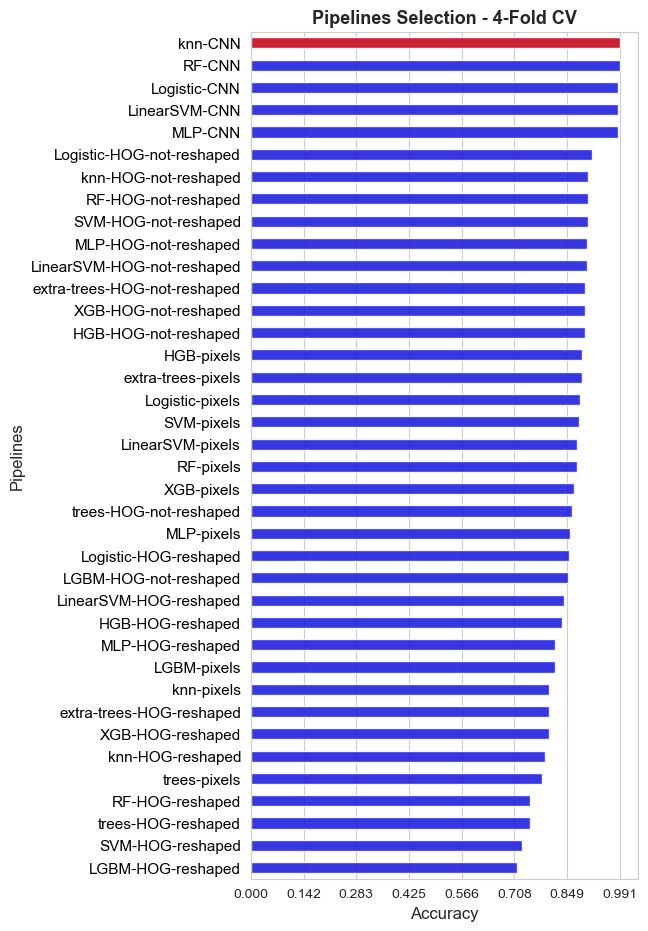

The best pipeline among all the 38 alternatives compared in this final stage, according to the inner evaluation, is: knn-CNN
Accuracy of the best pipeline:  0.991

The best pipeline hyper-parameters are:  {'feature_extraction__method': 'CNN', 'scaler__apply': True, 'pca__apply': True, 'scaler__method': 'min-max', 'pca__n_components': 109, 'knn__n_neighbors': 11, 'knn__metric': 'cosine'}


In [7]:
fig, axes = plt.subplots(figsize=(5,11))
ax = sns.barplot(y=list(sorted_models), x=list(sorted_scores), color='blue', width=0.5, alpha=0.9)
ax = sns.barplot(y=[best_pipeline], x=[score_best_pipeline], color='red', width=0.5, alpha=0.9)
ax.set_ylabel('Pipelines', size=12)
ax.set_xlabel('Accuracy', size=12)
ax.set_xticks(np.round(np.linspace(0, np.max(inner_score_values), 8),3)) 
ax.tick_params(axis='y', labelsize=11)    
plt.title('Pipelines Selection - 4-Fold CV', size=13, weight='bold')
for label in ax.get_yticklabels():
    #label.set_weight('bold')
    label.set_color('black') 
plt.show()

print(f'The best pipeline among all the {len(sorted_scores)} alternatives compared in this final stage, according to the inner evaluation, is: {best_pipeline}')
print('Accuracy of the best pipeline: ', np.round(score_best_pipeline, 3))
print('\nThe best pipeline hyper-parameters are: ', best_params[best_pipeline])

The general conclusion that we extract from the above plot are the following: 

- Is pretty clear that with CNN features achieve outstanding performance, really far away from the one reached with the other features extraction methods. This method seems to work well regardless of the specific classifier.

- The second best method is HOG, specifically when  HOG features vector is not reshaped into a matrix

- Pixels method has a better performance than HOG when the features vector is reshaped. 

- The worst method is reshaped HGO. And we have observed that it warks much worse with Bag of Visual Words (BVW) strategy than with statistics aggregation.

## **Applying Outer Evaluation** 

- Estimation of future performance based on the testing partition:

In [ ]:
best_pipeline_estimator = pipelines[best_model].set_params(**best_params[best_pipeline])
best_pipeline_estimator.fit(X=X_train, y=Y_train)
Y_test_hat = best_pipeline_estimator.predict(X=X_test)
future_performance_acc = accuracy_score(y_pred=Y_test_hat, y_true=Y_test)

The estimation of future performance (accuracy) for the best pipeline is:

In [348]:
future_performance_acc

0.9866666666666667

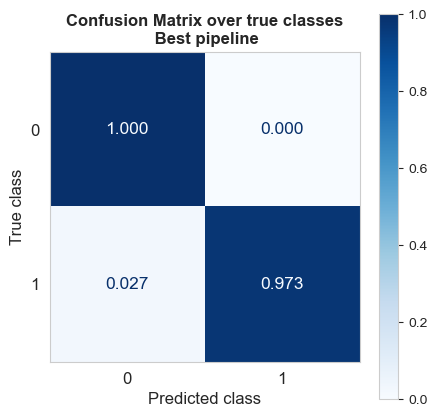

In [353]:
cm = confusion_matrix(y_pred=Y_test_hat, y_true=Y_test, normalize='true', labels=best_pipeline_estimator.classes_)
# normalize='true' to normalize over the rows (true classes)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=best_pipeline_estimator.classes_)

fig, axs = plt.subplots(figsize=(5,5))
disp.plot(ax=axs, cmap=plt.cm.Blues, values_format='.3f', text_kw={'fontsize': 12.5})
plt.title('Confusion Matrix over true classes\n Best pipeline', weight='bold', fontsize=12)
axs.set_xlabel('Predicted class', size=12)
axs.set_ylabel('True class', size=12)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.grid(False)
plt.show()

- All the non-fire images are classified correctly

- The 97.3% of the fire images are detected.

Therefore, in this case:

- Specificity = 100%

- Sensibility/recall = 97%

In [356]:
values, counts = np.unique(Y_test, return_counts=True)
rel_freq = counts / np.sum(counts)
rel_freq

array([0.50666667, 0.49333333])

The accuracy can also be computed with the specificity and sensibility as follows:

In [358]:
1*0.5067 + 0.97*0.493

0.98491

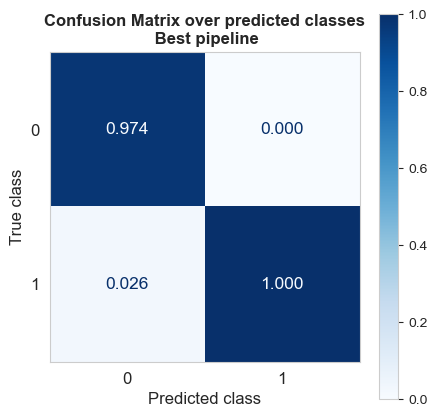

In [359]:
cm = confusion_matrix(y_pred=Y_test_hat, y_true=Y_test, normalize='pred', labels=best_pipeline_estimator.classes_)
# normalize='true' to normalize over the rows (true classes)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=best_pipeline_estimator.classes_)

fig, axs = plt.subplots(figsize=(5,5))
disp.plot(ax=axs, cmap=plt.cm.Blues, values_format='.3f', text_kw={'fontsize': 12.5})
plt.title('Confusion Matrix over predicted classes\n Best pipeline', weight='bold', fontsize=12)
axs.set_xlabel('Predicted class', size=12)
axs.set_ylabel('True class', size=12)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.grid(False)
plt.show()

- The 97.4% of the predicted as non-fire images that are actually non-fire. 

- The 100% of the predicted as fire images are indeed fire.

Therefore, in this case:

- Precision = 100%

- Negative predictive value = 97.4%

The F1-score is the armonic mean between precision and sensibility, and is an ideal metric to measure the performance of a binary classifier on the positive class (fire class in our project), and in this case is:

In [360]:
f1_score(y_pred=Y_test_hat, y_true=Y_test)

0.9863013698630138

Summarizing, our best classifier works almost perfectly, both detecting (classifying) fire and non-fire images.

## **Saving the final pipeline**

We save the best pipeline as a pre-trained model, using all the available dat for training it. 

In [ ]:
best_pipeline_estimator = pipelines[best_model].set_params(**best_params[best_pipeline])
best_pipeline_estimator.fit(X=X, y=Y)
# Save the model to a file
with open('results/best_pipeline.pkl', 'wb') as file:
    pickle.dump(best_pipeline_estimator, file)

## **Predicting new data**

In this section new images will be classified using the best found pipeline as it was saved before.

In [ ]:
# Load the model from file
with open('results/best_pipeline.pkl', 'rb') as file:
    loaded_pipeline = pickle.load(file)

# Building a list with the new images paths
folder_new_images = r'C:\Users\fscielzo\Documents\DataScience-GitHub\Image Analysis\Image-Classification\Fire-Classification\New-Data'
new_images_names = os.listdir(folder_new_images)
new_images_paths = [os.path.join(folder_new_images, file_name) for file_name in new_images_names]

# Get all files in the folder
X_new = new_images_paths

# Predicting the new images with the loaded pipeline
Y_new_hat = loaded_pipeline.predict(X_new)

Plotting the images along with the model predictions.

--------------------------
Analyzing img1.png
--------------------------


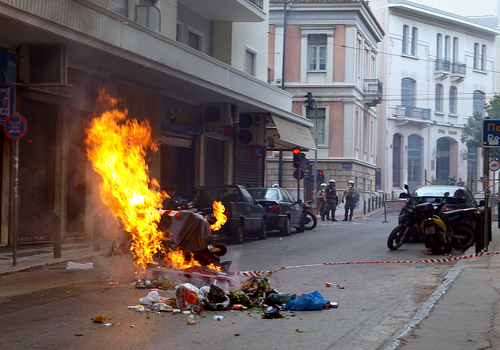

--------------------------
Result: Fire detected
--------------------------

########################################################################################################
########################################################################################################

--------------------------
Analyzing img2.jpg
--------------------------


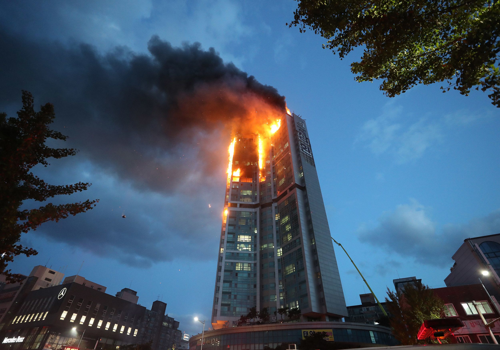

--------------------------
Result: Fire detected
--------------------------

########################################################################################################
########################################################################################################

--------------------------
Analyzing img3.jpg
--------------------------


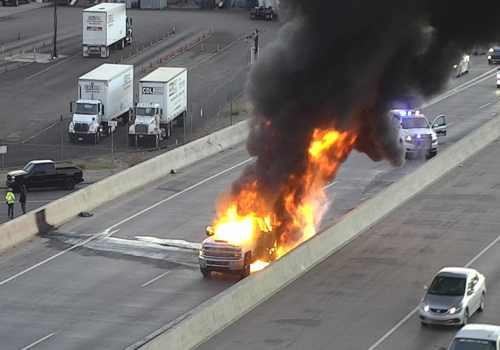

--------------------------
Result: Fire detected
--------------------------

########################################################################################################
########################################################################################################

--------------------------
Analyzing img4.jpg
--------------------------


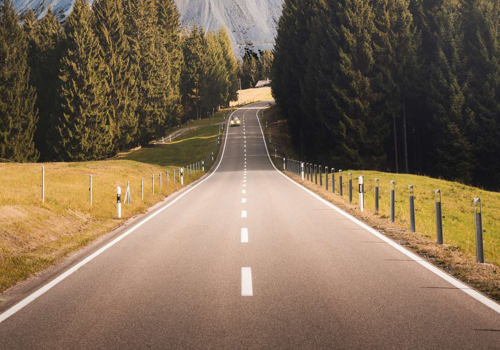

--------------------------
Result: Fire not detected
--------------------------

########################################################################################################
########################################################################################################

--------------------------
Analyzing img5.jpg
--------------------------


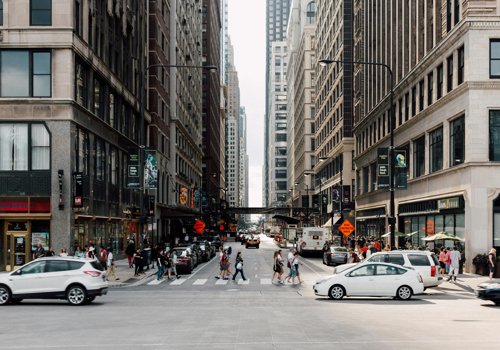

--------------------------
Result: Fire not detected
--------------------------

########################################################################################################
########################################################################################################

--------------------------
Analyzing img6.jpg
--------------------------


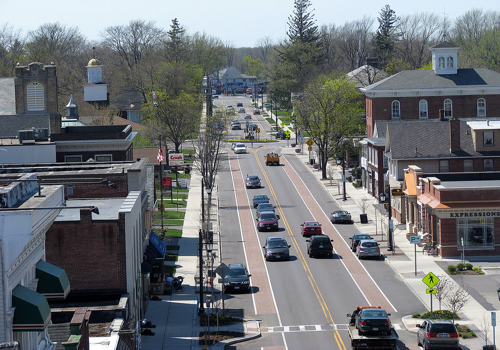

--------------------------
Result: Fire not detected
--------------------------

########################################################################################################
########################################################################################################

--------------------------
Analyzing img7.jpg
--------------------------


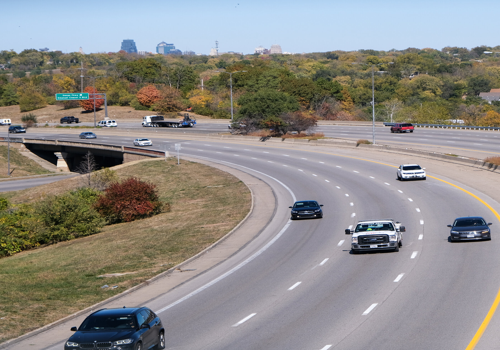

--------------------------
Result: Fire not detected
--------------------------

########################################################################################################
########################################################################################################

--------------------------
Analyzing img8.jpg
--------------------------


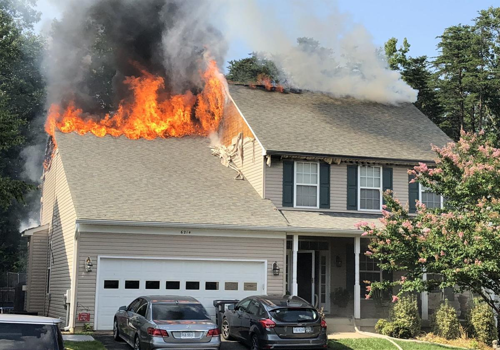

--------------------------
Result: Fire detected
--------------------------

########################################################################################################
########################################################################################################



In [386]:
for i, (img, img_name) in enumerate(zip(X_new, new_images_names)):
    print(f'--------------------------\nAnalyzing {img_name}\n--------------------------')
    display(Image.open(img).resize((500, 350)))
    if Y_new_hat[i] == 1:
        print('--------------------------\nResult: Fire detected\n--------------------------')
    else:
        print('--------------------------\nResult: Fire not detected\n--------------------------')

    print('\n########################################################################################################\n########################################################################################################\n')

All the new images have been classified correctly.